# Setup

In [ ]:
# Colab Setup
#@title { vertical-output: true}

# Fix strange bug about wrong locale
import locale
def getpreferredencoding(do_setlocale = True):
    return "UTF-8"
locale.getpreferredencoding = getpreferredencoding

from google.colab import drive
from pathlib import Path

#Load Drive (MVTEC Data is stored there, download your own copy of mvtec to drive first)
drive.mount('/content/drive')
# Set the path to the root directory of the MVTEC dataset
data_root = Path("/content/drive/MyDrive/Data/mvtec")
assert data_root.is_dir()


Mounted at /content/drive


In [ ]:
# When running locally
from pathlib import Path

data_root = # Path("/Users/.../Meine Ablage/Data/mvtec")
assert data_root.is_dir()

# Requirements

In [ ]:

# For gpt4 experiemtns
#@title { vertical-output: true}
!pip install --quiet python-dotenv openai openpyxl kaleido


     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 224.9/224.9 kB 2.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 79.9/79.9 MB 7.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 75.9/75.9 kB 10.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 76.9/76.9 kB 3.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 58.3/58.3 kB 3.5 MB/s eta 0:00:00
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
lida 0.0.10 requires fastapi, which is not installed.
lida 0.0.10 requires python-multipart, which is not installed.
lida 0.0.10 requires uvicorn, which is not installed.
llmx 0.0.15a0 requires cohere, which is not installed.
llmx 0.0.15a0 requires tiktoken, which is not installed.
tensorflow-probability 0.22.0 requires typing-extensions<4.6.0, but you have typing-extensions 4.9.0 which is incompatible.


In [ ]:

# for qwen experiemtns
#@title { vertical-output: true}

!pip install -q tiktoken transformers_stream_generator gradio==3.50.2 optimum auto-gptq huggingface_hub
!pip install -q modelscope -f https://pypi.org/project/modelscope
%cd /content
!wget https://raw.githubusercontent.com/camenduru/Qwen-VL-Chat-colab/main/app.py -O /content/app.py


     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.0/2.0 MB 26.1 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 20.3/20.3 MB 70.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 403.3/403.3 kB 44.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 4.8/4.8 MB 72.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 92.0/92.0 kB 11.8 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 299.2/299.2 kB 20.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 75.9/75.9 kB 10.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 138.7/138.7 kB 17.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 45.7/45.7 kB 5.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 60.3/60.3 kB 8.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 129.9/129.9 kB 16.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━

# Imports

In [ ]:
# Colab Imports for GPT4
#@title { vertical-output: true}
import base64
import glob
import io
import os
import pprint
import random
import time
from datetime import date
from io import BytesIO
from pathlib import Path
from typing import List

import cv2
import dotenv
import kaleido
import numpy as np
import pandas as pd
import plotly.express as px
import plotly.graph_objs as go
from IPython.display import HTML
from IPython.utils import io
from PIL import Image
from plotly.subplots import make_subplots
from sklearn.metrics import (ConfusionMatrixDisplay, accuracy_score, classification_report, confusion_matrix, f1_score, precision_score, recall_score)
from tqdm import tqdm

# These might require specific environment (like Google Colab)
from google.colab import drive
from openai import OpenAI
from openpyxl import load_workbook
from openpyxl.drawing.image import Image as OpenpyxlImage


# drive.mount('/content/drive')
dotenv.load_dotenv('/content/drive/MyDrive/Data/openai-api')
secret = os.getenv('KEY')
client = OpenAI(api_key=secret)

In [ ]:
# Qwen Colab IMports
#@title { vertical-output: true}
# import os
# os.system('pip install tiktoken')
# os.system('pip install "modelscope" --upgrade -f https://pypi.org/project/modelscope/')
# os.system('pip install transformers_stream_generator')

# os.environ['CUDA_VISIBLE_DEVICES'] = '0,1'


import base64
import glob
import io
import os
import pprint
import random
import time
from argparse import ArgumentParser
from datetime import date
from io import BytesIO
from typing import List
from pathlib import Path


import cv2
import numpy as np
import pandas as pd
import plotly.express as px
import plotly.graph_objs as go
from IPython.display import HTML
from IPython.utils import io
from PIL import Image
from plotly.subplots import make_subplots
from sklearn.metrics import (ConfusionMatrixDisplay, accuracy_score, classification_report, confusion_matrix, f1_score, precision_score, recall_score)
from tqdm import tqdm

# These might require specific environment (like Google Colab)
from google.colab import drive
from openpyxl import load_workbook
from openpyxl.drawing.image import Image as OpenpyxlImage


import copy
import gradio as gr
import os
import re
import secrets
import tempfile
from modelscope import (
    AutoModelForCausalLM, AutoTokenizer, GenerationConfig
)
from huggingface_hub import snapshot_download



# Kill this process after it loaded and setup the env
!python app.py --share


2024-01-16 10:38:16,255 - modelscope - INFO - PyTorch version 2.1.0+cu121 Found.
2024-01-16 10:38:16,260 - modelscope - INFO - TensorFlow version 2.15.0 Found.
2024-01-16 10:38:16,261 - modelscope - INFO - Loading ast index from /root/.cache/modelscope/ast_indexer
2024-01-16 10:38:16,263 - modelscope - INFO - No valid ast index found from /root/.cache/modelscope/ast_indexer, generating ast index from prebuilt!
2024-01-16 10:38:16,355 - modelscope - INFO - Loading done! Current index file version is 1.11.0, with md5 0293f3438012c81e680200c9aed07f21 and a total number of 953 components indexed


2024-01-16 10:38:23,788 - modelscope - INFO - PyTorch version 2.1.0+cu121 Found.
2024-01-16 10:38:23,789 - modelscope - INFO - TensorFlow version 2.15.0 Found.
2024-01-16 10:38:23,789 - modelscope - INFO - Loading ast index from /root/.cache/modelscope/ast_indexer
2024-01-16 10:38:23,829 - modelscope - INFO - Loading done! Current index file version is 1.11.0, with md5 0293f3438012c81e680200c9aed07f21 and a total number of 953 components indexed
2024-01-16 10:38:25.072970: E external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:9261] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
2024-01-16 10:38:25.073018: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:607] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
2024-01-16 10:38:25.074133: E external/local_xla/xla/stream_executor/cuda/cuda_blas.cc:1515] Unable to register cuBLAS factory: A

# Experiment Data Loading

MTec Data needs to be available in data_root, separated in mvtec_train (no anomalies)  and the regular mvtec dataset

bottle


100%|██████████| 9/9 [00:15<00:00,  1.75s/it]


capsule


100%|██████████| 14/14 [00:23<00:00,  1.65s/it]


carpet


100%|██████████| 12/12 [00:23<00:00,  1.95s/it]


grid


100%|██████████| 8/8 [00:12<00:00,  1.61s/it]


hazelnut


100%|██████████| 11/11 [00:26<00:00,  2.38s/it]


leather


100%|██████████| 13/13 [00:23<00:00,  1.79s/it]


metal_nut


100%|██████████| 12/12 [00:15<00:00,  1.33s/it]


pill


100%|██████████| 17/17 [00:22<00:00,  1.33s/it]


screw


100%|██████████| 16/16 [00:24<00:00,  1.55s/it]


tile


100%|██████████| 12/12 [00:23<00:00,  1.96s/it]


toothbrush


100%|██████████| 5/5 [00:20<00:00,  4.20s/it]


transistor


100%|██████████| 10/10 [00:18<00:00,  1.83s/it]


wood


100%|██████████| 8/8 [00:19<00:00,  2.48s/it]


zipper


100%|██████████| 16/16 [00:23<00:00,  1.48s/it]

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 163 entries, 0 to 162
Data columns (total 25 columns):
 #   Column                 Non-Null Count  Dtype 
---  ------                 --------------  ----- 
 0   stacked_image          163 non-null    object
 1   image                  163 non-null    object
 2   reference              163 non-null    object
 3   reference2             163 non-null    object
 4   reference3             163 non-null    object
 5   reference4             163 non-null    object
 6   label                  163 non-null    object
 7   label_name             163 non-null    object
 8   class                  163 non-null    object
 9   file_name              163 non-null    object
 10  reference_file_name    163 non-null    object
 11  reference_file_name2   163 non-null    object
 12  reference_file_name3   163 non-null    object
 13  reference_file_name4   163 non-null    object
 14  stacked_pil_image      163 non-null    object
 15  pil_image              

None

,stacked_image,image,reference,reference2,reference3,reference4,label,label_name,class,file_name,reference_file_name,reference_file_name2,reference_file_name3,reference_file_name4,stacked_pil_image,pil_image,pil_reference,pil_reference2,pil_reference3,pil_reference4,test_image_path,reference_image_path,reference_image_path2,reference_image_path3,reference_image_path4
85,,,,,,,NOT OK,color,pill,009.png,064.png,136.png,071.png,073.png,,,,,,,/content/drive/MyDrive/Data/mvtec/pill/test/color/009.png,/content/drive/MyDrive/Data/mvtec_train/pill/train/good/064.png,/content/drive/MyDrive/Data/mvtec_train/pill/train/good/136.png,/content/drive/MyDrive/Data/mvtec_train/pill/train/good/071.png,/content/drive/MyDrive/Data/mvtec_train/pill/train/good/073.png
8,,,,,,,OK,good,bottle,014.png,148.png,074.png,144.png,108.png,,,,,,,/content/drive/MyDrive/Data/mvtec/bottle/test/good/014.png,/content/drive/MyDrive/Data/mvtec_train/bottle/train/good/148.png,/content/drive/MyDrive/Data/mvtec_train/bottle/train/good/074.png,/content/drive/MyDrive/Data/mvtec_train/bottle/train/good/144.png,/content/drive/MyDrive/Data/mvtec_train/bottle/train/good/108.png
141,,,,,,,NOT OK,liquid,wood,002.png,062.png,005.png,201.png,029.png,,,,,,,/content/drive/MyDrive/Data/mvtec/wood/test/liquid/002.png,/content/drive/MyDrive/Data/mvtec_train/wood/train/good/062.png,/content/drive/MyDrive/Data/mvtec_train/wood/train/good/005.png,/content/drive/MyDrive/Data/mvtec_train/wood/train/good/201.png,/content/drive/MyDrive/Data/mvtec_train/wood/train/good/029.png
126,,,,,,,NOT OK,defective,toothbrush,001.png,058.png,050.png,025.png,041.png,,,,,,,/content/drive/MyDrive/Data/mvtec/toothbrush/test/defective/001.png,/content/drive/MyDrive/Data/mvtec_train/toothbrush/train/good/058.png,/content/drive/MyDrive/Data/mvtec_train/toothbrush/train/good/050.png,/content/drive/MyDrive/Data/mvtec_train/toothbrush/train/good/025.png,/content/drive/MyDrive/Data/mvtec_train/toothbrush/train/good/041.png
33,,,,,,,NOT OK,color,carpet,014.png,201.png,013.png,128.png,107.png,,,,,,,/content/drive/MyDrive/Data/mvtec/carpet/test/color/014.png,/content/drive/MyDrive/Data/mvtec_train/carpet/train/good/201.png,/content/drive/MyDrive/Data/mvtec_train/carpet/train/good/013.png,/content/drive/MyDrive/Data/mvtec_train/carpet/train/good/128.png,/content/drive/MyDrive/Data/mvtec_train/carpet/train/good/107.png

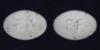
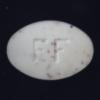
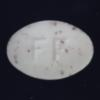
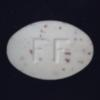
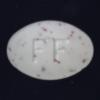
...
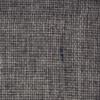
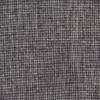
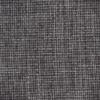
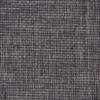
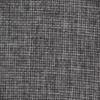

In [ ]:
#@title { vertical-output: true}



today = str(date.today())




# Helper functions

def create_thumbnail(image, resample=Image.BILINEAR):
    # Max output dimensions for the resulting thumbnail images (without ratio change)
    MAX_WIDTH, MAX_HEIGHT = 100, 100    # Create a copy of the original image
    modified_image = image.copy()

    # Apply the thumbnail method to the copy
    modified_image.thumbnail((MAX_WIDTH, MAX_HEIGHT), resample)

    # Return the modified copy
    return modified_image


def stack_and_visualize_images(test_image_path, train_image_path):
    # Open the images using PIL
    test_image = Image.open(test_image_path)
    train_image = Image.open(train_image_path)

    # Get the sizes of both images
    test_image_size = test_image.size
    train_image_size = train_image.size

    # Create a new image with the combined width and the same height as the largest image
    new_width = test_image_size[0] + train_image_size[0]
    new_height = max(test_image_size[1], train_image_size[1])

    # Create a new image for stacking
    stacked_image = Image.new('RGB', (new_width, new_height))

    # Paste the two images onto the stacked_image
    stacked_image.paste(train_image, (0, 0))
    stacked_image.paste(test_image, (train_image_size[0], 0))

    return stacked_image


def image_to_base64(pil_img):
    with BytesIO() as buffer:
        pil_img.save(buffer, 'jpeg')
        return base64.b64encode(buffer.getvalue()).decode()


def image_to_html(img: Image.Image) -> str:
    # Only for visualizaiton purposes downscale the images
    data = image_to_base64(create_thumbnail(img))
    return f'<img src="data:image/jpeg;base64,{data}">'


def show(df: pd.DataFrame, n=5) -> None:
    display(df.info())
    display(HTML(df.sample(n).to_html(escape=False)))





# Iterate through the categories to build the dataset
dataset = []
for category_dir in ((data_root.parent/ "mvtec_train").iterdir()):
    if category_dir.is_dir():
        print(category_dir.name)
        test_dir = data_root / category_dir.name / "test"
        train_good_dir = category_dir / "train" / "good"
        train_images = list(train_good_dir.glob("*.png"))

        if len(train_images) < 4:
            # Skip the category
            continue

        # Grab all .png images in the test directory (may contain defects)
        test_images = list(test_dir.rglob("**/*.png"))

        # Iterate through the test images
        for test_image_path in tqdm(test_images[::10]):

            # Randomly select 4 training images (no defect) from the "train/good" folder
            random_train_image_paths = random.sample(train_images, 4)
            train_image_objs = [Image.open(path) for path in random_train_image_paths]

            # Stack a good and a possibly bad image into one
            stacked_pil_image = stack_and_visualize_images(test_image_path, random_train_image_paths[0])

            test_image = Image.open(test_image_path)

            # Get image information
            label_name = test_image_path.parent.name
            label = "OK" if label_name == "good" else "NOT OK"

            # Add row information
            dataset.append({
                "stacked_image": image_to_html(stacked_pil_image),
                "image": image_to_html(test_image),
                "reference": image_to_html(train_image_objs[0]),
                "reference2": image_to_html(train_image_objs[1]),
                "reference3": image_to_html(train_image_objs[2]),
                "reference4": image_to_html(train_image_objs[3]),

                "label": label,
                "label_name": label_name,
                "class": category_dir.name,
                "file_name": test_image_path.name,
                "reference_file_name": random_train_image_paths[0].name,
                "reference_file_name2": random_train_image_paths[1].name,
                "reference_file_name3": random_train_image_paths[2].name,
                "reference_file_name4": random_train_image_paths[3].name,

                "stacked_pil_image": stacked_pil_image,
                "pil_image": test_image,
                "pil_reference": train_image_objs[0],
                "pil_reference2": train_image_objs[1],
                "pil_reference3": train_image_objs[2],
                "pil_reference4": train_image_objs[3],

                # Adding file paths for all images
                "test_image_path": str(test_image_path),
                "reference_image_path": str(random_train_image_paths[0]),
                "reference_image_path2": str(random_train_image_paths[1]),
                "reference_image_path3": str(random_train_image_paths[2]),
                "reference_image_path4": str(random_train_image_paths[3]),
            })



show(pd.DataFrame(dataset))


# Experiments

## GPT4

In [ ]:
one_shot_prompt = """Examine two provided images:
1. The first image depicts the OK state.
2. The second image depicts the content in question.
Compare the two images and decide whether the second content shows anomalous deviations with regards to the OK state.
In case of an anomaly, print NOT OK and describe the anomaly. Otherwise, print OK."""

few_shot_prompt =  """Examine the provided images:
1-3. The first three images depict the OK state.
4. The fourth images depicts the content in question.
Compare the fourth image to the first three OK images and decide whether the content shows anomalous deviations with regards to the OK state.
In case of an anomaly, print NOT OK and describe the anomaly. Otherwise, print OK.
"""

zero_shot_prompt = """
Decide whether the image has anomalous deviations with regards to quality control.
In case of an anomaly, print NOT OK and describe the anomaly. Otherwise, print OK.
"""

In [ ]:


def vqa_ano_detection(name: str, dataset: List[dict], prompt: str, image_columns: List[str], verbose=True) -> List[dict]:

    for index, row in tqdm(list(enumerate(dataset))):
        response_col = f"{name}_response"
        plain_response_col = f"{name}_plain_response"
        prompt_col = f"{name}_prompt"
        plain_prompt_col = f"{name}_plain_prompt"
        pred_col = f"{name}_prediction"
        date_col = f"{name}_date"

        # Ignore rows that already have a response
        if response_col in row and row[response_col] is not np.nan:
            continue

        # Sleep 2 seconds so that no rate-limit error is reached
        time.sleep(2)

        # Build the prompt payload
        content: List[dict[str, str | dict[str, str]]] = [
            {"type": "text", "text": prompt},
        ]

        # Add the images to the prompt payload
        for i, image_col in enumerate(image_columns):
            image = row[image_col]
            b64 = image_to_base64(image)
            image_data = f"data:image/jpeg;base64,{b64}"
            content.append(
                {"type": "image_url", "image_url": {"url": image_data,
                 "details": "high" }}
            )

        messages = [
            {
                "role": "system",
                "content": "You are a quality control agent.",
            },
            {
                "role": "user",
                "content": content
            }
        ]
        # Get the response from GPT
        try:
            plain_response = client.chat.completions.create(
                model="gpt-4-vision-preview",
                messages=messages,
                temperature=0,        # Deterministic Output
                max_tokens=300,       # Cap output tokens to avoid high costs
                top_p=1,              # Default
                frequency_penalty=0,  # Any output is possible; no freq penalty
                presence_penalty=0    # Any output is possible; no pres penalty
            )
        except Exception as e:
            print(e)
            continue

        # Retrieve response
        response = plain_response.choices[0].message.content
        assert response is not None

        if verbose:
            print(index,  response)

        # Update the row by adding new columns
        dataset[index].update({
            prompt_col: prompt,
            plain_prompt_col: messages,
            response_col: response,
            plain_response_col: plain_response,
            pred_col: "NOT OK" if "NOT OK" in response else "OK",
            date_col: today
        })

    # Display a sample of random rows of the dataset in html
    show(pd.DataFrame(dataset))

    return dataset

### Experiment 1: Zero-Shot Prompt

In [ ]:
#@title { vertical-output: true}


dataset = vqa_ano_detection(
    name="zero_shot",
    dataset=dataset,
    prompt=zero_shot_prompt,
    image_columns = ["pil_image"]
)

  0%|          | 0/163 [00:00<?, ?it/s]

NOT OK

The anomaly in the image is that there is visible chipping or damage along the rim of the object. This suggests that the integrity of the object could be compromised, which might not be acceptable for quality control depending on the intended use of the item.
NOT OK

There is a visible chip or crack on the upper part of the object, which indicates damage. This would be considered a quality control issue since the integrity of the item is compromised.
NOT OK

The anomaly in this image appears to be a defect in the object's rim, primarily at the top part of the image. There is a visible chip or break that disrupts the otherwise smooth and circular edge.
NOT OK

The anomaly in the image appears to be residue or corrosion around the inner rim of what seems to be a bottle or jar. This could indicate either a used product or a defect in manufacturing, both of which would be considered quality control issues.
NOT OK. The image is of a bottle opening and shows signs of residue or wear 

 60%|██████    | 98/163 [00:04<00:02, 22.17it/s]

97 NOT OK

The screw in the image appears to have a damaged head, which would make it difficult to engage with a screwdriver properly. This is a quality control issue as it could affect the functionality of the screw.
98 OK
99 OK


 62%|██████▏   | 101/163 [00:17<00:14,  4.33it/s]

100 OK


 63%|██████▎   | 102/163 [00:21<00:18,  3.35it/s]

101 OK


 63%|██████▎   | 103/163 [00:29<00:31,  1.92it/s]

102 OK


 64%|██████▍   | 104/163 [00:34<00:40,  1.47it/s]

103 NOT OK

The screw in the image appears to have a manufacturing defect. The threaded portion of the screw is not straight and seems to be bent or warped, which would prevent it from being screwed in properly. This is a significant anomaly that would affect the screw's functionality.


 64%|██████▍   | 105/163 [00:39<00:51,  1.13it/s]

104 NOT OK

The anomaly in the image is that the screw appears to have a damaged or malformed tip, which would prevent it from being properly driven into materials. The tip should be sharp and intact for the screw to function correctly.


 65%|██████▌   | 106/163 [00:43<01:04,  1.13s/it]

105 NOT OK

The anomaly in the image is that the screw appears to be bent or damaged near the tip, which would affect its ability to be driven straight into materials. This is a defect that would not pass quality control for standard screws.


 66%|██████▌   | 107/163 [00:49<01:23,  1.49s/it]

106 NOT OK

The screw depicted in the image has several anomalies:

1. The thread appears to be damaged or deformed, particularly in the middle section.
2. The tip of the screw is bent, which would make it difficult to use properly.
3. There are visible signs of wear or damage on the screw head, which could affect how it interacts with a screwdriver.

These defects would likely affect the screw's performance and its ability to be driven into materials properly.


 66%|██████▋   | 108/163 [00:53<01:39,  1.80s/it]

107 NOT OK

The screw in the image appears to have a manufacturing defect. The shaft of the screw near the head is deformed and not uniform, which could affect the screw's performance and its ability to be driven into material properly.


 67%|██████▋   | 109/163 [00:57<01:51,  2.06s/it]

108 OK


 67%|██████▋   | 110/163 [01:00<02:00,  2.28s/it]

109 OK


 68%|██████▊   | 111/163 [01:04<02:14,  2.59s/it]

110 OK


 69%|██████▊   | 112/163 [01:07<02:21,  2.78s/it]

111 OK


 69%|██████▉   | 113/163 [01:15<03:10,  3.80s/it]

112 NOT OK

The anomaly in the image is the presence of a large, discolored area that stands out from the rest of the pattern. This could indicate a stain, discoloration, or some form of contamination that deviates from the expected uniformity of the material's surface.


 70%|██████▉   | 114/163 [01:19<03:18,  4.05s/it]

113 NOT OK

The image appears to show a material with a consistent speckled pattern, but there is a noticeable anomaly in the form of a large, irregularly shaped discoloration or stain. This could indicate a defect in the material or an issue with the image capture process.


 71%|███████   | 115/163 [01:24<03:26,  4.30s/it]

114 NOT OK

The image shows a surface with a pattern that appears to be uniform except for a central area with a distinct, irregular feature that disrupts the pattern. This could be indicative of a defect or contamination on the surface. Additionally, there are several small particles or debris scattered across the surface, which could also be considered anomalies in a quality control context, depending on the intended uniformity and cleanliness of the product.


 71%|███████   | 116/163 [01:29<03:27,  4.42s/it]

115 NOT OK

The image shows a surface with a speckled pattern, but there are noticeable anomalies such as a few small brown particles that could be debris or contamination, and an area towards the bottom left that appears to have a different texture or a cluster of particles, which could indicate a defect or inconsistency in the material or coating.


 72%|███████▏  | 117/163 [01:42<05:10,  6.74s/it]

116 NOT OK

There is a visible crack running vertically through the center of the image, and there is a small chip or defect on the left side of the crack. These are anomalies that indicate damage to the material.


 72%|███████▏  | 118/163 [01:46<04:33,  6.08s/it]

117 OK

The image appears to be a close-up texture with no obvious quality control issues such as blurriness, discoloration, or unwanted artifacts.


 73%|███████▎  | 119/163 [01:50<03:58,  5.43s/it]

118 OK


 74%|███████▎  | 120/163 [01:54<03:35,  5.02s/it]

119 OK

The image appears to be a close-up texture with no obvious quality control issues such as blurriness, distortion, or unwanted artifacts.


 74%|███████▍  | 121/163 [01:58<03:20,  4.78s/it]

120 OK

The image appears to be a close-up texture with no obvious quality control issues such as blurriness, distortion, or unwanted artifacts. It seems to be in focus and properly exposed.


 75%|███████▍  | 122/163 [02:03<03:13,  4.71s/it]

121 NOT OK

The anomaly in this image is the presence of a large, dark, irregularly shaped area that stands out against the speckled pattern of the rest of the surface. This could indicate a defect or contamination if this is a material or product that is supposed to have a uniform pattern or texture.


 75%|███████▌  | 123/163 [02:07<03:04,  4.61s/it]

122 NOT OK

The anomaly in the image is the presence of a piece of tape or a similar transparent material with a distinct edge that is placed over the surface. This could indicate contamination or improper handling of the material being inspected.


 76%|███████▌  | 124/163 [02:16<03:48,  5.85s/it]

123 OK

The image appears to be a close-up photograph of a small, translucent crystal or mineral specimen on a speckled surface. There are no obvious anomalies with regards to the quality of the image; it is in focus, well-lit, and the object of interest is centered. The background texture does not detract from the clarity of the subject.


 77%|███████▋  | 125/163 [02:21<03:31,  5.56s/it]

124 OK

The image appears to be a close-up of an object with a patterned surface, possibly a toothbrush head with bristles of varying colors. There are no obvious anomalies with regards to the quality of the image itself; it is in focus, well-lit, and the object is centered. There are no visible defects or deviations in the pattern that would suggest a quality control issue.


 77%|███████▋  | 126/163 [02:31<04:13,  6.85s/it]

125 OK

The image appears to be a close-up photograph of a section of an organism, possibly a marine invertebrate like a sea squirt, displaying a pattern of red and white structures. There are no obvious quality control issues such as blurriness, distortion, or color problems. The image is clear, well-focused, and the subject is centered.


 78%|███████▊  | 127/163 [02:37<03:59,  6.66s/it]

126 OK

The image appears to be a close-up of a biological specimen, possibly a section of marine life or a microscopic organism. The image is clear, well-focused, and properly illuminated, with no obvious signs of distortion or quality issues. The background is uniform and does not distract from the subject.


 79%|███████▊  | 128/163 [02:43<03:41,  6.32s/it]

127 OK

The image appears to be a high-quality photograph of a nudibranch, a type of sea slug known for its colorful appearance. There are no visible anomalies in terms of focus, exposure, or composition that would indicate a deviation from quality control standards. The subject is well-centered, and the background is clean and unobtrusive, which highlights the subject effectively.


 79%|███████▉  | 129/163 [02:47<03:18,  5.85s/it]

128 OK

The image appears to be a clear and focused photograph of a sea creature, possibly a nudibranch or a type of marine invertebrate, against a black background. There are no obvious visual anomalies that would indicate a deviation from quality control standards such as blurriness, incorrect exposure, or color aberrations. The subject is well-centered and the details are visible.


 80%|███████▉  | 130/163 [02:52<03:05,  5.62s/it]

129 NOT OK

The anomaly in the image is that the electronic component (which appears to be an integrated circuit or similar device) is not properly aligned with the pattern on the board beneath it, which seems to be intended for placement or soldering of components. The leads of the component are not centered over the copper pads they should be connected to, which could lead to a malfunctioning circuit or difficulty in soldering the component properly.


 80%|████████  | 131/163 [02:57<02:53,  5.42s/it]

130 NOT OK

The anomaly in the image is that the electronic component (which appears to be a transistor) is not properly aligned with the holes on the breadboard. The pins of the component are bent and do not match the spacing of the breadboard holes, which would prevent proper insertion and electrical connection.


 81%|████████  | 132/163 [03:02<02:40,  5.17s/it]

131 NOT OK

The anomaly in this image is that the electronic component appears to have accumulated a significant amount of dust or debris on its surface, which could potentially interfere with its function. Proper cleaning is required to ensure optimal performance and to prevent any potential short-circuits or overheating.


 82%|████████▏ | 133/163 [03:07<02:34,  5.14s/it]

132 NOT OK

The anomaly in this image is that the electronic component (which appears to be a transistor) is not properly aligned with the holes on the breadboard. The leads of the component are bent and do not enter the holes as they should for a secure and proper electrical connection. This could lead to a malfunctioning circuit or damage to the component if power were applied.


 82%|████████▏ | 134/163 [03:12<02:24,  4.98s/it]

133 NOT OK

The anomaly in the image is that the electronic component (which appears to be a transistor or similar semiconductor device) has one of its legs bent and not properly aligned with the others. This could prevent the component from being correctly inserted into a circuit board or making proper contact with the intended socket or solder pad.


 83%|████████▎ | 135/163 [03:16<02:17,  4.92s/it]

134 NOT OK

The anomaly in the image is that the electronic component (which appears to be a transistor) is not properly aligned with the holes on the breadboard. The pins of the component are bent and do not enter the holes as they should for a secure and proper electrical connection. This could lead to a malfunctioning circuit or damage to the component if power were applied.


 83%|████████▎ | 136/163 [03:29<03:18,  7.34s/it]

135 NOT OK

The anomaly in the image is that the electronic component (which appears to be a transistor) is not properly aligned with the holes on the breadboard. The pins of the component are bent and do not match the spacing of the breadboard holes, which would prevent proper insertion and electrical connection.


 84%|████████▍ | 137/163 [03:33<02:45,  6.37s/it]

136 NOT OK

The soldering on the pins of the component appears to be of poor quality. The solder joints look cold and poorly formed, which could lead to bad electrical connections and potential failure in a circuit.


 85%|████████▍ | 138/163 [03:38<02:26,  5.86s/it]

137 NOT OK

The anomaly in the image is that the integrated circuit (IC) is not properly aligned with the breadboard. The pins of the IC are not inserted into the holes of the breadboard, which means it would not make a proper electrical connection. This is a common mistake when prototyping with electronics and can lead to a circuit not functioning as intended.


 85%|████████▌ | 139/163 [03:45<02:30,  6.26s/it]

138 NOT OK

The anomaly in the image is that the leads (pins) of the electronic component (which appears to be a transistor) are bent and not aligned properly. This could cause issues with insertion into a circuit board or socket and could lead to a malfunctioning circuit if not corrected. The component should have straight and evenly spaced leads for proper installation.


 86%|████████▌ | 140/163 [03:49<02:06,  5.48s/it]

139 OK


 87%|████████▋ | 141/163 [03:53<01:49,  4.97s/it]

140 OK


 87%|████████▋ | 142/163 [04:02<02:09,  6.15s/it]

141 NOT OK

The image shows a wooden surface with several anomalies:

1. There are patches that appear to be stains or discolorations on the wood.
2. The grain of the wood has irregularities, which could be natural but might be considered defects depending on the intended use of the wood.
3. There are also some minor scratches or indentations that could be considered imperfections.

These could be considered quality control issues if the wood is meant for a product that requires a uniform appearance.


 88%|████████▊ | 143/163 [04:06<01:53,  5.66s/it]

142 OK


 88%|████████▊ | 144/163 [04:16<02:09,  6.82s/it]

143 OK

The image appears to be a high-resolution photograph of a wooden surface with natural grain patterns. There are no obvious anomalies such as blurring, distortion, or unwanted artifacts that would indicate a quality control issue. The lighting and focus seem consistent throughout the image.


 89%|████████▉ | 145/163 [04:20<01:51,  6.19s/it]

144 OK

The image appears to be a close-up of a wooden surface with natural grain patterns. There are no obvious anomalies such as blurring, distortion, or color aberration that would indicate a quality control issue with the image itself. The knots and variations in the wood grain are natural features of the wood, not defects in the image quality.


 90%|████████▉ | 146/163 [04:27<01:45,  6.20s/it]

145 NOT OK

The image shows a wooden surface with several anomalies that could be considered defects depending on the intended use of the wood:

1. There is a knot visible on the left side, which could affect the structural integrity or aesthetic quality.
2. There are scratches or scuff marks across the wood grain, which could be problematic for appearance-focused applications.
3. The wood grain itself has variations that might not be desirable for certain finishes or products that require a uniform appearance.


 90%|█████████ | 147/163 [04:32<01:34,  5.88s/it]

146 NOT OK

The anomaly in this image is the presence of red markings on the wood surface. These could be paint, stains, or some other form of discoloration that is not typically desired in a clean wood finish. Additionally, there is a knot in the wood, which, depending on the intended use of the wood, might be considered a defect or a natural feature.


 91%|█████████ | 148/163 [04:44<01:57,  7.85s/it]

147 NOT OK

The image shows a zipper that appears to be misaligned or separated, which is a defect. The teeth of the zipper are not properly interlocked, which would prevent the zipper from functioning correctly. This is a quality control issue that would need to be addressed.


 91%|█████████▏| 149/163 [04:49<01:38,  7.06s/it]

148 NOT OK

There are several anomalies visible in the image:

1. There is a noticeable snag or pull in the fabric to the left of the zipper.
2. There are loose or stray threads visible near the zipper area.
3. There is a small white speck on the fabric to the right of the zipper, which could be a piece of lint or a defect in the material.

These issues indicate that the item does not meet the expected quality control standards.


 92%|█████████▏| 150/163 [04:54<01:21,  6.28s/it]

149 OK

The image shows a zipper, and there are no obvious anomalies or deviations visible that would indicate a quality control issue. The zipper teeth appear to be aligned and interlocked properly, and the fabric on both sides seems intact without visible defects.


 93%|█████████▎| 151/163 [04:59<01:10,  5.90s/it]

150 OK


 93%|█████████▎| 152/163 [05:03<01:00,  5.50s/it]

151 OK

The image shows a close-up of a zipper, and there are no visible anomalies in terms of quality control. The zipper teeth appear to be aligned correctly, and the fabric on either side seems uniform without any noticeable defects.


 94%|█████████▍| 153/163 [05:09<00:53,  5.37s/it]

152 NOT OK

The anomaly in the image is that the zipper teeth do not appear to be interlocking properly in a small section towards the bottom of the image. This could potentially cause the zipper to malfunction or separate when used.


 94%|█████████▍| 154/163 [05:13<00:46,  5.13s/it]

153 NOT OK

The anomaly in the image is that the zipper is misaligned and not properly closed. The teeth of the zipper do not interlock correctly, which could be a manufacturing defect or a result of damage. This would affect the functionality of the zipper, as it would not close securely.


 95%|█████████▌| 155/163 [05:18<00:40,  5.12s/it]

154 NOT OK

The anomaly in the image is a defect in the zipper. There is visible damage where the zipper teeth appear to be missing or broken, which would likely prevent the zipper from functioning properly.


 96%|█████████▌| 156/163 [05:22<00:34,  4.87s/it]

155 NOT OK

The anomaly in this image is that the zipper appears to be damaged or defective. There is a section where the zipper teeth are misaligned or missing, which would prevent the zipper from functioning properly.


 96%|█████████▋| 157/163 [05:28<00:30,  5.02s/it]

156 NOT OK

The image shows a zipper with several quality control issues:

1. The fabric along the edge of the zipper is frayed, indicating poor finishing or damage.
2. There are loose or broken threads visible on the fabric.
3. The zipper teeth appear to be misaligned or damaged in some areas, which could affect functionality.

These anomalies suggest that the zipper does not meet the quality standards for a finished product.


 97%|█████████▋| 158/163 [05:32<00:23,  4.80s/it]

157 NOT OK

The anomaly in this image is that there is a visible defect on the left side where the fabric is frayed or has loose threads. This could be a sign of damage or poor manufacturing quality.


 98%|█████████▊| 159/163 [05:37<00:19,  4.95s/it]

158 NOT OK

The image shows a zipper, and there appears to be a misalignment or damage to the zipper teeth towards the bottom of the image. This could potentially cause the zipper to not function properly. Additionally, there are some small white specks scattered across the fabric, which could be indicative of dust or debris, suggesting a cleanliness issue with the product.


 98%|█████████▊| 160/163 [05:42<00:14,  4.78s/it]

159 NOT OK

The image shows a zipper that appears to have a defect. There is a section where the zipper teeth are misaligned or missing, which would prevent the zipper from functioning properly. This is a quality control issue that would need to be addressed.


 99%|█████████▉| 161/163 [05:46<00:09,  4.58s/it]

160 NOT OK

The anomaly in this image is that the zipper teeth appear to be misaligned or damaged at a certain point, which could prevent the zipper from functioning properly.


 99%|█████████▉| 162/163 [05:50<00:04,  4.53s/it]

161 NOT OK

The anomaly in the image is that the zipper appears to be misaligned or damaged, as the teeth do not interlock properly in a section of the zipper. This could prevent the zipper from functioning correctly.


100%|██████████| 163/163 [05:55<00:00,  2.18s/it]

162 NOT OK

There is a visible anomaly on the fabric near the zipper. It appears to be a small cluster of fibers or a snag that is protruding from the surface, which could be considered a defect in the material or a result of damage.


### Experiment 2 - One Shot



 87%|████████▋ | 142/163 [00:06<00:00, 21.92it/s]

141 NOT OK

The second image shows anomalous deviations compared to the first image. There are visible marks or stains on the wood surface in the second image that are not present in the first image, which depicts a clean and uniform wood texture. These marks are irregularities and represent a deviation from the OK state shown in the first image.
142 NOT OK

The second image shows a vertical crack or split in the wood, which is an anomalous deviation from the first image where the wood surface appears to be smooth and without any such defects.
143 NOT OK

The second image shows anomalous deviations when compared to the first image. There are visible white streaks or scratches on the wood surface in the second image that are not present in the first image, which depicts a clean and uniform wood grain pattern. These streaks or scratches could indicate damage or wear that deviates from the OK state represented by the first image.


 89%|████████▉ | 145/163 [00:26<00:04,  4.13it/s]

144 NOT OK

The second image shows two small holes or knots in the wood, which are not present in the first image. These represent an anomaly when compared to the OK state depicted in the first image.


 90%|████████▉ | 146/163 [00:39<00:07,  2.42it/s]

145 NOT OK

The second image shows several anomalies when compared to the first image:

1. There is a visible knot in the wood grain in the second image that is not present in the first image.
2. There are scratches or scuff marks on the surface of the wood in the second image that are not visible in the first image.


 90%|█████████ | 147/163 [00:48<00:09,  1.70it/s]

146 NOT OK

The second image shows a piece of wood with a visible knot and some red markings, which are not present in the first image. The first image depicts a uniform wood texture without any significant marks or knots. The differences between the two images indicate that the second image does not match the OK state as defined by the first image.


 91%|█████████ | 148/163 [00:54<00:10,  1.38it/s]

147 OK

The second image does not show any anomalous deviations when compared to the first image. Both images depict a zipper that appears to be in good condition without any visible defects or irregularities.


 91%|█████████▏| 149/163 [01:00<00:12,  1.08it/s]

148 NOT OK

The second image shows a zipper with two visible anomalies compared to the first image, which depicts the OK state. The first anomaly is a disruption in the zipper teeth, where some teeth appear to be missing or damaged, creating a gap. The second anomaly is a fuzzy area where the fabric appears to be frayed or has loose threads, which is not present in the first image. These deviations indicate that the zipper in the second image is defective.


 92%|█████████▏| 150/163 [01:05<00:14,  1.14s/it]

149 OK

The second image appears to be identical to the first image, showing no visible anomalies or deviations from the OK state. Both images depict a zipper that is closed and properly aligned, with no visible defects or damage.


 93%|█████████▎| 151/163 [01:12<00:18,  1.52s/it]

150 OK

The second image appears to be identical to the first image, with no visible anomalies or deviations. The zipper and the fabric texture are consistent in both images.


 93%|█████████▎| 152/163 [01:18<00:20,  1.86s/it]

151 OK

The second image does not show any anomalous deviations when compared to the first image. Both images appear to depict a zipper that is closed and properly aligned, with no visible defects or differences.


 94%|█████████▍| 153/163 [01:30<00:29,  2.97s/it]

152 OK

The second image does not show any significant deviations from the first image. Both depict a zipper that is closed and properly aligned, with no visible defects or anomalies in the fabric or zipper teeth.


 94%|█████████▍| 154/163 [01:35<00:30,  3.35s/it]

153 OK

The second image does not show any anomalous deviations when compared to the first image. Both images depict a zipper that appears to be in good condition, with no visible defects or differences in the zipper's structure or the surrounding fabric.


 95%|█████████▌| 155/163 [01:41<00:29,  3.73s/it]

154 NOT OK

The second image shows a zipper with a visible defect. There is a section where the zipper teeth appear to be damaged or missing, which would likely prevent the zipper from functioning properly. This is a deviation from the first image, where the zipper is intact and shows no signs of damage.


 96%|█████████▌| 156/163 [01:48<00:30,  4.39s/it]

155 NOT OK

The second image shows a zipper with several anomalies when compared to the first image, which depicts the OK state of a zipper. The anomalies include:

1. There is visible damage to the zipper teeth, with some teeth appearing to be missing or misaligned.
2. There are loose threads or fibers around the damaged area, indicating wear or a defect.
3. The zipper teeth in the damaged area are not interlocking properly, which could affect the functionality of the zipper.


 96%|█████████▋| 157/163 [01:54<00:28,  4.78s/it]

156 NOT OK

The second image shows a zipper with a section of the fabric edging frayed and damaged, which is a deviation from the first image where the zipper and fabric edging are intact and undamaged.


 97%|█████████▋| 158/163 [02:01<00:25,  5.10s/it]

157 NOT OK

The second image shows a zipper with a noticeable defect. There is a section of the fabric edging that is frayed and sticking out to the side, which is not present in the first image. This represents an anomalous deviation from the OK state depicted in the first image, where the zipper and fabric edging are neat and without any visible defects.


 98%|█████████▊| 159/163 [02:07<00:21,  5.44s/it]

158 NOT OK

The second image shows a zipper that is misaligned or separated at one point, which is a deviation from the first image where the zipper is correctly aligned and closed. This misalignment could prevent the zipper from functioning properly, as it may not close or open smoothly.


 98%|█████████▊| 160/163 [02:14<00:17,  5.78s/it]

159 OK

The second image does not show any anomalous deviations when compared to the first image. Both images depict a zipper that appears to be in good condition, with no visible damage or misalignment. The texture and color of the material on both sides of the zipper are consistent in both images.


 99%|█████████▉| 161/163 [02:20<00:12,  6.02s/it]

160 NOT OK

The second image shows a zipper with a visible defect. There is a section where the zipper teeth appear to be misaligned or damaged, which could prevent the zipper from functioning properly. This is an anomalous deviation from the OK state depicted in the first image, where the zipper is shown in a good condition without any visible defects.


 99%|█████████▉| 162/163 [02:26<00:05,  5.80s/it]

161 OK

Both images appear to be identical, showing a zipper that is closed and properly aligned. There are no visible anomalies or deviations between the two images. The fabric and zipper teeth look consistent, and there are no signs of damage or misalignment.


100%|██████████| 163/163 [02:37<00:00,  1.04it/s]

162 NOT OK

The second image shows a deviation from the OK state depicted in the first image. There is a visible anomaly on the fabric near the zipper, which appears to be a small lump or snag in the material. This could indicate damage or a defect in the fabric.
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 163 entries, 0 to 162
Data columns (total 18 columns):
 #   Column                Non-Null Count  Dtype 
---  ------                --------------  ----- 
 0   stacked_image         163 non-null    object
 1   image                 163 non-null    object
 2   reference             163 non-null    object
 3   label                 163 non-null    object
 4   label_name            163 non-null    object
 5   class                 163 non-null    object
 6   file_name             163 non-null    object
 7   reference_file_name   163 non-null    object
 8   stacked_pil_image     163 non-null    object
 9   pil_image             163 non-null    object
 10  pil_reference         163 

None

,stacked_image,image,reference,label,label_name,class,file_name,reference_file_name,stacked_pil_image,pil_image,pil_reference,zero_shot_prediction,one_shot_prediction,zero_shot_prompt,zero_shot_response,one_shot_prompt,one_shot_response,one_shot_date
38,,,,NOT OK,bent,grid,000.png,046.png,,,,NOT OK,NOT OK,"\nDecide whether the image has anomalous deviations with regards to quality control.\nIn case of an anomaly, print NOT OK and describe the anomaly. Otherwise, print OK.\n","NOT OK\n\nThere are two visible anomalies in the pattern of the mesh. One is located towards the upper left quadrant and the other towards the lower right quadrant. Both anomalies are characterized by a distortion in the regularity of the mesh pattern, where the wires appear to be bent or misshapen.","Examine two provided images:\n1. The first image depicts the OK state.\n2. The second image depicts the content in question.\nCompare the two images and decide whether the second content shows anomalous deviations with regards to the OK state.\nIn case of an anomaly, print NOT OK and describe the anomaly. Otherwise, print OK.","NOT OK\n\nThe second image shows a deviation from the OK state depicted in the first image. There are visible anomalies where the pattern is disrupted. Specifically, there are two areas where the mesh pattern is broken or deformed, indicating damage or a defect in the material.",2023-11-24
143,,,,NOT OK,scratch,wood,006.png,188.png,,,,OK,NOT OK,"\nDecide whether the image has anomalous deviations with regards to quality control.\nIn case of an anomaly, print NOT OK and describe the anomaly. Otherwise, print OK.\n","OK\n\nThe image appears to be a high-resolution photograph of a wooden surface with natural grain patterns. There are no obvious anomalies such as blurring, distortion, or unwanted artifacts that would indicate a quality control issue. The lighting and focus seem consistent throughout the image.","Examine two provided images:\n1. The first image depicts the OK state.\n2. The second image depicts the content in question.\nCompare the two images and decide whether the second content shows anomalous deviations with regards to the OK state.\nIn case of an anomaly, print NOT OK and describe the anomaly. Otherwise, print OK.","NOT OK\n\nThe second image shows anomalous deviations when compared to the first image. There are visible white streaks or scratches on the wood surface in the second image that are not present in the first image, which depicts a clean and uniform wood grain pattern. These streaks or scratches could indicate damage or wear that deviates from the OK state represented by the first image.",2023-11-29
112,,,,NOT OK,oil,tile,008.png,063.png,,,,NOT OK,NOT OK,"\nDecide whether the image has anomalous deviations with regards to quality control.\nIn case of an anomaly, print NOT OK and describe the anomaly. Otherwise, print OK.\n","NOT OK\n\nThe anomaly in the image is the presence of a large, discolored area that stands out from the rest of the pattern. This could indicate a stain, discoloration, or some form of contamination that deviates from the expected uniformity of the material's surface.","Examine two provided images:\n1. The first image depicts the OK state.\n2. The second image depicts the content in question.\nCompare the two images and decide whether the second content shows anomalous deviations with regards to the OK state.\nIn case of an anomaly, print NOT OK and describe the anomaly. Otherwise, print OK.","NOT OK\n\nThe second image shows an anomaly when compared to the first image. There is a noticeable discoloration in the center of the second image, which appears as a yellowish-brown area with a different pattern than the surrounding material. This is not present in the first image, which has a consistent speckled pattern throughout. The anomaly in the second image could indicate a defect or contamination.",2023-11-27
162,,,,NOT OK,fabric_interior,zipper,006.png,228.png,,,,NOT OK,NOT OK,"\nDecide w
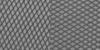
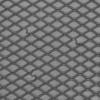
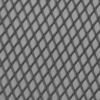
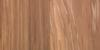
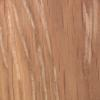
...
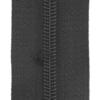
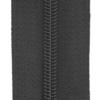
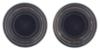
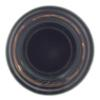
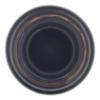

In [ ]:
#@title { vertical-output: true}

dataset = vqa_ano_detection(
    name="one_shot",
    dataset=dataset,
    prompt=one_shot_prompt,
    image_columns = ["pil_reference", "pil_image"]
)

### Experiment 3 Few-Shot

 22%|██▏       | 36/163 [00:05<00:19,  6.68it/s]

Error code: 400 - {'error': {'message': 'Your input image may contain content that is not allowed by our safety system.', 'type': 'invalid_request_error', 'param': None, 'code': 'content_policy_violation'}}


 23%|██▎       | 37/163 [00:09<00:38,  3.28it/s]

Error code: 400 - {'error': {'message': 'Your input image may contain content that is not allowed by our safety system.', 'type': 'invalid_request_error', 'param': None, 'code': 'content_policy_violation'}}


 23%|██▎       | 38/163 [00:16<01:19,  1.56it/s]

37 NOT OK

The fourth image shows an anomaly when compared to the first three images, which represent the OK state. The anomaly in the fourth image is a visible tear or damage to the mesh pattern, with some of the strands appearing broken and frayed, which is not present in the first three images.


 24%|██▍       | 39/163 [00:23<02:13,  1.07s/it]

38 NOT OK

The fourth image shows an anomaly when compared to the first image, which represents the OK state. In the fourth image, there is a visible distortion in the pattern: two of the lines are not aligned properly and create a noticeable break in the otherwise uniform grid pattern. This deviation from the consistent pattern observed in the first image indicates a defect or irregularity.


 25%|██▍       | 40/163 [00:29<03:12,  1.57s/it]

39 NOT OK

The second content shows anomalous deviations with regards to the OK state. Specifically, there is a visible defect in the pattern: one of the elements has a circular hole, and there is a linear tear or cut extending from this hole. This is in contrast to the uniform pattern seen in the first image, which represents the OK state.


 25%|██▌       | 41/163 [00:37<04:36,  2.27s/it]

40 NOT OK

The second content shows an anomaly when compared to the OK state depicted in the first image. There is a visible defect on the patterned surface in the fourth image. Specifically, there is a disruption in the pattern where it appears that a piece of the material is torn or missing, and the continuity of the design is broken. This defect is not present in the first image, which shows a uniform and uninterrupted pattern.


 26%|██▌       | 42/163 [00:47<06:43,  3.33s/it]

41 OK

The second set of images provided shows no anomalous deviations when compared to the first image which depicts the OK state. The pattern, texture, and alignment appear consistent across both images. There are no visible defects, distortions, or inconsistencies that would indicate a deviation from the expected state.


 26%|██▋       | 43/163 [01:01<10:19,  5.16s/it]

42 OK

The second set of images provided does not show any anomalous deviations when compared to the first set, which represents the OK state. The pattern, texture, and alignment appear consistent across both sets of images.


 27%|██▋       | 44/163 [01:20<15:25,  7.78s/it]

43 NOT OK

The second image shows a hazelnut with a white patch on its surface, which appears to be mold or a similar type of blemish. This is an anomalous deviation from the OK state depicted in the first image, where the hazelnut is clean and free of any such marks.


 28%|██▊       | 45/163 [01:27<14:47,  7.52s/it]

44 NOT OK

The anomaly in the second content (fourth image) compared to the OK state (first image) is the presence of white markings on the hazelnut's shell. These markings are not present in the first image, which shows a clean and unmarked hazelnut shell. The white markings could indicate damage, mold, or some other form of contamination or defect.


 28%|██▊       | 46/163 [01:38<16:09,  8.29s/it]

45 OK

The second image appears to be identical to the first image, with no noticeable anomalies. Both images depict a hazelnut with a smooth, intact surface and a visible seam where the shell halves meet. There are no visible signs of damage, discoloration, or deformities that would indicate a deviation from the OK state.


 29%|██▉       | 47/163 [01:45<15:23,  7.96s/it]

46 OK

The second set of images provided shows a hazelnut with no visible anomalous deviations from the first image, which is considered the OK state. The color, texture, and general appearance of the hazelnut remain consistent across all images. There are no signs of damage, deformity, or any other anomalies that would indicate a deviation from the expected state.


 29%|██▉       | 48/163 [01:50<14:09,  7.39s/it]

47 OK

The second set of images provided shows no anomalous deviations from the first image which is considered the OK state. The hazelnut in all images appears to be consistent in shape, color, and texture, with no visible defects or abnormalities when compared to the reference image.


 30%|███       | 49/163 [01:58<14:01,  7.38s/it]

48 OK

The second set of images provided shows no anomalous deviations when compared to the first image which depicts the OK state. The hazelnuts in both images appear to be consistent in shape, color, and texture, with no visible defects or abnormalities.


 31%|███       | 50/163 [02:05<14:03,  7.47s/it]

49 OK

The first image shows a hazelnut with an intact shell, which we can consider as the OK state.

The second image also shows a hazelnut with an intact shell and no visible anomalies when compared to the first image.

The third image shows a hazelnut with a slightly darker area at the top, which could be a natural variation in coloration and does not necessarily indicate an anomaly.

The fourth image, however, shows a hazelnut with a visible crack in the shell. This is an anomaly when compared to the OK state of the first image.

NOT OK
Anomaly: The hazelnut in the fourth image has a cracked shell.


 31%|███▏      | 51/163 [02:22<18:57, 10.16s/it]

50 NOT OK

The fourth image shows a hazelnut with a significant crack and pieces of the shell missing, which is a deviation from the OK state depicted in the first image where the hazelnut is intact and undamaged. This constitutes an anomaly.


 32%|███▏      | 52/163 [02:31<17:48,  9.63s/it]

51 NOT OK

The second content (fourth image) shows an anomalous deviation with regards to the OK state (first image). The anomaly is the presence of a foreign object, which appears to be a piece of clear tape with two staples attached to it, adhered to the surface of the hazelnut. This is not present in the OK state image and represents a contamination or packaging defect.


 33%|███▎      | 53/163 [02:38<16:21,  8.92s/it]

52 OK

The second set of images provided shows hazelnuts with slight variations in appearance, which is normal for natural products. There are no significant anomalies such as mold, damage, or foreign objects that would indicate a deviation from the OK state. Each hazelnut has a slightly different shape, coloration, and texture, which is expected within a batch of natural items.


 33%|███▎      | 54/163 [02:51<18:35, 10.23s/it]

53 NOT OK

The fourth image shows a hazelnut with a visible hole and signs of damage, which is an anomaly when compared to the first image, which depicts an intact hazelnut without any visible damage. The hole in the fourth image suggests that the integrity of the hazelnut has been compromised, possibly by an insect or other external factor.


 34%|███▎      | 55/163 [02:58<16:36,  9.22s/it]

54 NOT OK

The second image shows a deviation from the OK state depicted in the first image. There is a visible red stain or mark on the material that is not present in the first image. This is an anomalous deviation.


 34%|███▍      | 56/163 [03:04<14:57,  8.38s/it]

55 NOT OK

The second image shows a small red spot or blemish on the surface, which is an anomaly when compared to the first image that depicts a uniform brown texture without any such marks.


 35%|███▍      | 57/163 [03:11<14:01,  7.94s/it]

56 NOT OK

The second image shows a deviation from the OK state depicted in the first image. There is a visible tear or cut in the material, which is not present in the first image. This constitutes an anomaly in the content.


 36%|███▌      | 58/163 [03:18<13:07,  7.50s/it]

57 NOT OK

The second image shows an anomaly when compared to the first image. There is a visible defect on the material, which appears to be a small tear or puncture.


 36%|███▌      | 59/163 [03:35<18:05, 10.44s/it]

58 NOT OK

The second image shows an anomalous deviation from the OK state depicted in the first image. There is a visible water droplet or some kind of liquid substance on the surface in the second image, which is not present in the first image. This is the anomaly.


 37%|███▋      | 60/163 [03:42<15:53,  9.25s/it]

59 NOT OK

The second image shows two small raised bumps or protrusions on the surface that are not present in the first image. These deviations from the smooth texture seen in the first image represent anomalies.


 37%|███▋      | 61/163 [03:51<15:34,  9.16s/it]

60 OK

Both images appear to be identical and show no visible anomalies when compared to each other. The texture, color, and pattern remain consistent across both images.


 38%|███▊      | 62/163 [03:58<14:42,  8.74s/it]

61 OK

The two images provided appear to be identical with no visible anomalies or deviations between them. The texture and color of the material, which seems to be a brown leather-like surface, are consistent across both images.


 39%|███▊      | 63/163 [04:05<13:47,  8.27s/it]

62 OK

The second set of images provided appears to be consistent with the first image, which is described as the OK state. There are no visible anomalies or deviations from the texture and color seen in the first image. The material, which seems to be a type of leather or leather-like texture, maintains the same pattern and hue across all images.


 39%|███▉      | 64/163 [04:13<13:07,  7.96s/it]

63 NOT OK

The second set of images shows an anomaly when compared to the first image which represents the OK state. The anomaly is a small tear or defect on the surface of the material, visible in the lower part of the image. This defect is not present in the first image, indicating a deviation from the OK state.


 40%|███▉      | 65/163 [04:19<12:17,  7.52s/it]

64 NOT OK

The fourth image shows an anomaly when compared to the first three images. There is a visible hole or puncture in the material, which is not present in the other images that display a consistent leather texture without any such defects.


 40%|████      | 66/163 [04:25<11:30,  7.12s/it]

65 NOT OK

The second image shows a deviation from the OK state depicted in the first image. There is a visible defect on the surface, which appears to be a small indentation or scuff mark on the leather material.


 41%|████      | 67/163 [04:33<11:39,  7.29s/it]

66 NOT OK

The fourth image shows an anomaly when compared to the first image, which represents the OK state. There is a visible defect on the surface, which appears to be a small tear or puncture in the material. This deviation from the uniform texture and integrity of the material in the first image constitutes an anomaly.


 42%|████▏     | 68/163 [04:39<10:46,  6.81s/it]

67 OK


 42%|████▏     | 69/163 [04:45<10:37,  6.78s/it]

68 OK

The second image appears to be identical to the first image, with no visible anomalies or deviations. The object, which seems to be a metallic part with a central hole and multiple lobes, is consistent in both images in terms of shape, texture, and features.


 43%|████▎     | 70/163 [04:54<11:25,  7.37s/it]

69 OK

The four images provided appear to show the same object from slightly different angles or rotations. There are no visible anomalies or deviations when comparing the images to each other. Each image depicts a metallic part with a central hole and three arms, possibly a component used in machinery or equipment. The texture, color, and shape are consistent across all images, indicating that the second content does not show any anomalous deviations from the OK state.


 44%|████▎     | 71/163 [05:01<11:05,  7.23s/it]

70 NOT OK

The second image shows an anomaly when compared to the first image, which represents the OK state. The anomaly is a visible deformation on the lower right side of the object. This deformation appears as a flattened area where the circular symmetry of the part is broken.


 44%|████▍     | 72/163 [05:10<11:56,  7.87s/it]

71 OK

After examining both images, there are no noticeable anomalous deviations between the first image, which depicts the OK state, and the second image. The second image appears to be consistent with the first in terms of shape, features, and overall appearance.


 45%|████▍     | 73/163 [05:22<13:17,  8.86s/it]

72 OK

The second set of images provided appears to be consistent with the first image, which is described as the OK state. There are no visible anomalies or deviations in shape, texture, or features when comparing the second content with the reference OK state. All images show a metal part with the same shape, features, and no visible defects or differences.


 45%|████▌     | 74/163 [05:45<19:43, 13.30s/it]

73 OK

The second set of images provided does not show any anomalous deviations when compared to the first image, which is considered the OK state. The parts appear to be consistent in shape, size, and overall appearance, with no visible defects or irregularities.


 46%|████▌     | 75/163 [05:52<16:30, 11.26s/it]

74 OK

The second set of images provided does not show any anomalous deviations from the first image, which is considered the OK state. All images depict a similar object with no visible defects or differences.


 47%|████▋     | 76/163 [05:58<13:56,  9.61s/it]

75 NOT OK

The fourth image shows an anomaly when compared to the first image, which represents the OK state. There are several dark spots or blemishes on the lower right side of the component in the fourth image that are not present in the first image. These spots indicate a deviation from the expected condition and could be indicative of contamination, material defects, or surface imperfections.


 47%|████▋     | 77/163 [06:04<12:36,  8.80s/it]

76 NOT OK

The fourth image shows an anomaly when compared to the first image, which represents the OK state. There is a red marking or defect on the right side of the component in the fourth image that is not present in the first image. This indicates a deviation from the acceptable standard.


 48%|████▊     | 78/163 [06:10<11:05,  7.83s/it]

77 OK

The second set of images provided shows no discernible anomalous deviations when compared to the first image, which represents the OK state. The shape, features, and appearance of the object remain consistent across all images.


 48%|████▊     | 79/163 [06:21<12:19,  8.81s/it]

78 OK


 49%|████▉     | 80/163 [06:27<10:53,  7.88s/it]

79 OK

The third image provided does not show any anomalous deviations when compared to the first image, which depicts the OK state. Both images feature an oval-shaped object with the letters "FF" embossed in the center and small red speckles distributed across the surface. There are no noticeable differences in the shape, markings, or overall appearance that would indicate an anomaly.


 50%|████▉     | 81/163 [06:33<09:52,  7.22s/it]

80 OK

The third image provided is consistent with the first image, which depicts the OK state. There are no anomalous deviations observed between the two images. Both show a pill with speckles and the imprint "FF" without any significant differences in the speckles' distribution or the pill's overall condition.


 50%|█████     | 82/163 [06:39<09:15,  6.86s/it]

81 OK

The second set of images provided shows no anomalous deviations when compared to the first image, which is considered the OK state. The objects in both images appear to be identical, with the same shape, color, and markings. There are no visible defects or differences that would indicate an anomaly.


 51%|█████     | 83/163 [06:58<14:20, 10.76s/it]

82 OK

The four images provided appear to show the same object, presumably a pill with the imprint "FF" on it, against a black background. All images show the pill with similar speckled markings, and there are no significant deviations visible that would indicate an anomaly. The pill maintains the same shape, size, and imprint across all images.


 52%|█████▏    | 84/163 [07:10<14:34, 11.08s/it]

83 OK

The four images provided appear to show the same type of object, presumably a pill or tablet with the imprint "FF" on it, and speckled inclusions throughout the material. There are no obvious or significant deviations between the images that would indicate an anomaly. Each image shows the pill with a consistent shape, imprint, and pattern of inclusions.


 52%|█████▏    | 85/163 [07:18<13:06, 10.08s/it]

84 OK


 53%|█████▎    | 86/163 [07:30<13:36, 10.61s/it]

85 OK

The second set of images provided shows no anomalous deviations from the first image which is considered the OK state. The shape, color, and markings ("FF") on the tablets are consistent across all images. There are minor variations in the speckled pattern on the tablets, but these are within the expected range of variation for this type of product and do not constitute an anomaly.


 53%|█████▎    | 87/163 [07:36<11:56,  9.43s/it]

86 OK

The four images provided appear to show the same object, presumably a pill, with the imprint "FF" on it. The pill has red speckles distributed across its surface. There are no significant differences between the images that would indicate an anomalous deviation from an OK state. All images show the pill with the same characteristics, including the red speckles and the "FF" imprint.


 54%|█████▍    | 88/163 [07:47<12:13,  9.78s/it]

87 NOT OK

The anomaly in the second content (fourth image) compared to the OK state (first image) is the presence of yellow spots on the surface of the object. The OK state shows a white object with red speckles and the letters "FF" embossed on it, while the second content shows the same object with additional yellow discolorations not present in the OK state.


 55%|█████▍    | 89/163 [07:53<10:34,  8.57s/it]

88 OK

The second set of images provided shows no significant deviations from the first image, which is considered the OK state. All images depict an oval-shaped object with the letters "FF" embossed in the center and small red speckles distributed throughout the material. There are no anomalies such as additional markings, deformations, or color changes that would indicate a deviation from the OK state.


 55%|█████▌    | 90/163 [07:59<09:22,  7.71s/it]

89 NOT OK

The fourth image shows an anomaly. There is a visible chip on the bottom edge of the pill, which deviates from the expected OK state depicted in the first image. The other images do not show this defect and appear to be in the OK state.


 56%|█████▌    | 91/163 [08:07<09:38,  8.04s/it]

90 OK

The four images provided appear to show the same type of object, presumably a pill or tablet, with the same markings ("FF") and similar speckled inclusions. There are no obvious anomalies such as deformations, missing parts, or additional markings that deviate from the established OK state. The speckles vary slightly in distribution and concentration, which is common in materials with such inclusions, and does not necessarily indicate a defect or anomaly.


 56%|█████▋    | 92/163 [08:13<08:41,  7.35s/it]

91 OK

The first three images depict an oval-shaped object with the letters "FF" embossed on it and small red speckles distributed throughout the material. The fourth image shows the same characteristics with no noticeable deviations from the previous images. There are no anomalous deviations present in the fourth image when compared to the first three images.


 57%|█████▋    | 93/163 [08:19<08:03,  6.91s/it]

92 OK

The first three images depict oval-shaped tablets with the imprint "FF" and some red speckles throughout the material. The fourth image also shows an oval-shaped tablet with the "FF" imprint and red speckles. There are no significant deviations from the first image that would indicate an anomaly. All tablets have the same markings and speckles, which appear to be part of their design.


 58%|█████▊    | 94/163 [08:25<07:38,  6.65s/it]

93 NOT OK

The anomaly in the second image is that the pill, which should have "FF" imprinted on it, has an imprint that appears to be "FE." This is a deviation from the "FF" imprint shown in the first image, which represents the OK state.


 58%|█████▊    | 95/163 [08:35<08:40,  7.65s/it]

94 NOT OK

The second image shows an anomaly when compared to the first image, which is considered the OK state. The anomaly is the presence of an additional marking above the "FF" imprint on the pill. This marking appears to be a small, upside-down "V" shape, which is not present in the first image.


 59%|█████▉    | 96/163 [08:41<07:54,  7.08s/it]

95 OK

The second set of images provided appears to be consistent with the first image, which is described as the OK state. There are no anomalous deviations observed between the images. All images show an oval-shaped object with the letters "FF" embossed in the center and small red speckles distributed throughout the object's surface.


 60%|█████▉    | 97/163 [08:47<07:29,  6.81s/it]

96 OK

The second set of images provided shows a screw from different angles. Upon examination, there are no visible anomalies when comparing the different views of the screw. The screw appears consistent in terms of its features such as the thread, the head, and the tip across all images.


 60%|██████    | 98/163 [08:58<08:37,  7.96s/it]

97 NOT OK

The fourth image shows a screw with a damaged head. The slot on the head of the screw, where a screwdriver would be inserted, is deformed and worn, which would make it difficult to drive the screw properly with a tool. This is an anomalous deviation from the OK state depicted in the first three images, where the screws have intact and well-defined slots on their heads.


 61%|██████    | 99/163 [09:06<08:31,  7.99s/it]

98 OK

The second image provided appears to be identical to the first image, which is described as the OK state. There are no visible anomalies or deviations in the second image when compared to the first image. The screw in both images has the same characteristics, including the head type, thread pattern, and overall shape.


 61%|██████▏   | 100/163 [09:11<07:40,  7.31s/it]

99 OK

The second set of images provided shows no anomalous deviations when compared to the first image. The screw depicted in both images appears to be identical, with no visible differences in shape, size, or any other distinguishable features.


 62%|██████▏   | 101/163 [09:18<07:18,  7.07s/it]

100 OK

The second image provided appears to be identical to the first image, which is described as the OK state. There are no visible anomalies or deviations in the second image when compared to the first image. The screw in both images has the same characteristics, including the head type, thread pattern, and overall shape.


 63%|██████▎   | 102/163 [09:24<06:45,  6.65s/it]

101 OK

The third image provided is identical to the first image, which is considered the OK state. There are no visible anomalies or deviations between the two images. Both depict a screw with consistent features and no apparent defects.


 63%|██████▎   | 103/163 [09:29<06:23,  6.40s/it]

102 OK

The second set of images provided shows no anomalous deviations when compared to the first image, which is considered the OK state. The screw in both images appears to be identical with no visible defects or differences.


 64%|██████▍   | 104/163 [09:35<06:07,  6.24s/it]

103 OK

The second set of images provided shows a screw from different angles. Upon comparing these images with the first image, which is considered the OK state, there are no visible anomalies or deviations. The screw appears consistent in shape, design, and features across all images.


 64%|██████▍   | 105/163 [09:41<05:58,  6.18s/it]

104 NOT OK

The second image shows a screw with a damaged tip. The tip appears to be broken or worn, which deviates from the intact and sharp tip seen in the first image, which represents the OK state. This kind of damage could affect the screw's ability to penetrate and secure materials properly.


 65%|██████▌   | 106/163 [09:49<06:11,  6.51s/it]

105 NOT OK

The second image shows a screw with a damaged thread near the tip. The thread appears to be stripped or worn, which would affect the screw's ability to properly fasten materials. This is a deviation from the OK state depicted in the first image, where the screw has intact and uniform threads.


 66%|██████▌   | 107/163 [09:56<06:17,  6.74s/it]

106 NOT OK

The second image shows a screw with a damaged head. The slot for the screwdriver is deformed, which would make it difficult to drive the screw properly with a tool. This is an anomalous deviation from the OK state depicted in the first image, where the screw has a well-defined, undamaged slot.


 66%|██████▋   | 108/163 [10:03<06:14,  6.81s/it]

107 NOT OK

The second image shows a screw with a damaged thread near the head, which is an anomaly when compared to the first image where the screw is in the OK state with no visible damage.


 67%|██████▋   | 109/163 [10:09<05:54,  6.56s/it]

108 OK

The third image provided matches the OK state depicted in the first image. There are no visible anomalies or deviations when comparing the two images. Both screws appear to be of the same type and size, with no visible defects or damage.


 67%|██████▋   | 110/163 [10:14<05:22,  6.08s/it]

109 OK


 68%|██████▊   | 111/163 [10:20<05:25,  6.25s/it]

110 NOT OK

The second image shows a screw with a damaged head. The slot on the head of the screw, which is used to drive the screw, appears to be stripped or worn, which would make it difficult to insert or remove the screw with a standard screwdriver. This is a deviation from the OK state depicted in the first image, where the screw head is intact and the slot is clearly defined.


 69%|██████▊   | 112/163 [10:29<05:55,  6.98s/it]

111 OK

Both images depict a metal screw with no visible anomalies when compared to each other. The screws appear identical in terms of shape, design, and features, with no deviations that would indicate a problem or defect.


 69%|██████▉   | 113/163 [10:43<07:38,  9.18s/it]

112 NOT OK

The second image shows an anomaly when compared to the first image, which represents the OK state. There is a noticeable discoloration in the second image, characterized by a yellowish-brown area that deviates from the consistent speckled pattern observed in the OK state. This discoloration indicates a defect or contamination that is not present in the first image.


 70%|██████▉   | 114/163 [10:49<06:45,  8.27s/it]

113 NOT OK

The second content shows an anomalous deviation with regards to the OK state. There is a noticeable irregularity in the pattern: a large, distinct, yellowish-brown discoloration that is not present in the first image. This discoloration stands out against the otherwise uniform speckled pattern of the background material.


 71%|███████   | 115/163 [10:56<06:18,  7.88s/it]

114 NOT OK

The second content shows an anomalous deviation from the OK state. There is a visible vertical streak or smudge that is not present in the first image, which represents the OK state. This streak is lighter in color compared to the surrounding area and has some shiny or reflective particles within it, indicating a possible contamination or defect on the surface.


 71%|███████   | 116/163 [11:03<05:58,  7.62s/it]

115 NOT OK

The second image shows anomalous deviations compared to the first image. There are noticeable bright spots and a couple of small brownish particles that are not present in the first image. These could indicate contamination or defects that were not present in the OK state.


 72%|███████▏  | 117/163 [11:10<05:29,  7.16s/it]

116 NOT OK

The second content shows an anomalous deviation from the OK state. There is a visible crack or split running vertically through the image, which is not present in the first image. This indicates damage or a defect in the material or surface being examined.


 72%|███████▏  | 118/163 [11:16<05:15,  7.01s/it]

117 OK

The second set of images provided appears to be consistent with the first image, which is described as the OK state. There are no noticeable anomalies or deviations in the pattern, color, or texture between the images. The speckled pattern seems uniform across all images, suggesting that the second content does not show any anomalous deviations from the OK state.


 73%|███████▎  | 119/163 [11:27<06:00,  8.19s/it]

118 OK

The two images provided appear to be very similar with no significant deviations visible. The pattern, color distribution, and texture seem consistent between the first image (OK state) and the second image (content in question). There are no anomalies such as discolorations, foreign objects, or pattern interruptions that stand out when comparing the two images. Therefore, the second content does not show anomalous deviations with regards to the OK state.


 74%|███████▎  | 120/163 [11:33<05:25,  7.58s/it]

119 OK

The second image does not show any anomalous deviations with regards to the OK state depicted in the first image. Both images appear to be identical, displaying a pattern of dark spots on a lighter background with no discernible differences.


 74%|███████▍  | 121/163 [11:39<04:48,  6.87s/it]

120 OK

The second image does not show any significant deviations from the first image. Both images depict a similar pattern and texture without any noticeable anomalies.


 75%|███████▍  | 122/163 [11:45<04:30,  6.61s/it]

121 NOT OK

The second image shows an anomaly when compared to the first image. There is a noticeable dark smudge or mark in the center of the second image that is not present in the first image. This deviation from the uniform speckled pattern seen in the first image indicates a potential defect or contamination.


 75%|███████▌  | 123/163 [11:57<05:33,  8.33s/it]

122 NOT OK

The second image shows an anomalous deviation from the OK state depicted in the first image. There is a clear presence of a foreign object, which appears to be a piece of tape or a transparent material with a straight edge, located in the upper right quadrant of the image. This object is not present in the first image and thus represents an anomaly.


 76%|███████▌  | 124/163 [12:05<05:23,  8.30s/it]

123 NOT OK

The second image shows an anomalous deviation from the OK state depicted in the first image. There is a distinct, large, transparent flake-like object present in the center of the second image that is not present in the first image. This object represents a clear anomaly when compared to the uniform speckled pattern of the background material in the OK state.


 77%|███████▋  | 125/163 [12:11<04:45,  7.51s/it]

124 OK

The second set of images provided shows no anomalous deviations when compared to the first set, which is considered the OK state. The pattern, coloration, and arrangement of the elements appear consistent between the two sets.


 77%|███████▋  | 126/163 [12:21<05:07,  8.32s/it]

125 NOT OK

The second content shows anomalous deviations with regards to the OK state. The first image, which is the reference for the OK state, displays a pattern of red and white elements arranged in rows within an oval shape. The second image, which is the content in question, shows a different color scheme with yellow and brown elements instead of the red and white ones. The pattern and arrangement of the elements are also different, indicating a deviation from the OK state.


 78%|███████▊  | 127/163 [12:31<05:15,  8.76s/it]

126 OK

The first image provided is the reference for the OK state. The second and third images are the content in question. When comparing the second and third images to the first image, there are no anomalous deviations observed. The pattern, color distribution, and arrangement of the elements appear consistent with the reference image. Therefore, the second and third images are considered to be in the OK state.


 79%|███████▊  | 128/163 [12:41<05:23,  9.24s/it]

127 OK

The second set of images provided shows no anomalous deviations when compared to the first set, which represents the OK state. The patterns, colors, and arrangements appear consistent between the two sets.


 79%|███████▉  | 129/163 [12:52<05:29,  9.69s/it]

128 NOT OK

The second content shows anomalous deviations with regards to the OK state. The first three images depict an object with a pattern of brown and white elements with yellow centers, which seems consistent across all three images. However, the fourth image shows a significant deviation in color and pattern. The elements are red with white tips, and there is a central red element with spiky protrusions that is not present in the first three images. This indicates a clear anomaly in the pattern and color scheme.


 80%|███████▉  | 130/163 [12:58<04:42,  8.57s/it]

129 NOT OK

The anomaly in the second image is that the electronic component (which appears to be a transistor or similar semiconductor device) has one of its legs bent outward and not properly aligned with the others. This could potentially lead to an improper connection when the component is inserted into a circuit board.


 80%|████████  | 131/163 [13:07<04:35,  8.62s/it]

130 OK

The four images provided appear to show the same electronic component, presumably a transistor or similar device, mounted on a breadboard. There are no visible anomalies or deviations between the images. The component is consistently positioned with the same orientation, and the legs are inserted into the breadboard in the same pattern across all images.


 81%|████████  | 132/163 [13:14<04:11,  8.12s/it]

131 NOT OK

The fourth image shows an anomaly when compared to the first image, which depicts the OK state. The anomaly in the fourth image is that the electronic component appears to have suffered some damage or burning at the top, as indicated by the discolored and deformed area. This could indicate overheating or a failure that has caused physical damage to the component.


 82%|████████▏ | 133/163 [13:20<03:44,  7.48s/it]

132 OK

The second image appears to be consistent with the first image, which is defined as the OK state. There are no visible anomalies or deviations in the positioning, orientation, or condition of the component on the strip. The legs of the component are properly aligned and there are no signs of damage or deformation.


 82%|████████▏ | 134/163 [13:26<03:27,  7.14s/it]

133 OK

The four images provided appear to show the same electronic component, presumably a transistor, with three legs, mounted on a breadboard. There are no visible anomalies or deviations between the images. All components are seated in the breadboard with consistent orientation and leg alignment.


 83%|████████▎ | 135/163 [13:33<03:18,  7.08s/it]

134 OK

The second set of images provided shows no anomalous deviations when compared to the first image which depicts the OK state. The electronic component, which appears to be a transistor or similar device, is positioned consistently in both images with the legs properly aligned and soldered to the board. There are no visible signs of damage, misalignment, or any other defects that would indicate a deviation from the OK state.


 83%|████████▎ | 136/163 [13:39<03:02,  6.74s/it]

135 OK

The second image provided does not show any anomalous deviations when compared to the first image. Both images depict an electronic component, presumably a transistor, with three leads, mounted on a surface with a pattern of holes. The orientation, positioning, and condition of the component appear consistent across both images.


 84%|████████▍ | 137/163 [13:45<02:51,  6.59s/it]

136 OK

The second set of images provided shows no anomalous deviations when compared to the first image which depicts the OK state. The electronic component, which appears to be a transistor or similar device, is positioned consistently in both images with the legs properly aligned and soldered to the board. There are no visible defects or differences in the component or its soldering.


 85%|████████▍ | 138/163 [13:53<02:53,  6.92s/it]

137 OK

The second set of images provided shows no anomalous deviations when compared to the first image which depicts the OK state. The electronic component, which appears to be a transistor or similar device, is positioned consistently in both images with the legs properly aligned and no visible damage or differences.


 85%|████████▌ | 139/163 [14:01<02:57,  7.41s/it]

138 OK

The third image provided matches the OK state depicted in the first image. There are no visible anomalies when comparing the position, orientation, and condition of the electronic component on the breadboard. The legs of the component are properly aligned with the holes, and there are no signs of damage or incorrect placement.


 86%|████████▌ | 140/163 [14:08<02:44,  7.16s/it]

139 OK

The second set of images provided appears to be identical to the first set, showing no visible anomalies or deviations from the OK state. The wood grain pattern, color, and texture are consistent across both sets of images.


 87%|████████▋ | 141/163 [14:14<02:33,  6.99s/it]

140 OK

The second image does not show any anomalous deviations when compared to the first image. Both images depict a similar pattern and texture of wood, with no noticeable differences in color, markings, or other characteristics that would indicate an anomaly.


 87%|████████▋ | 142/163 [14:21<02:25,  6.92s/it]

141 NOT OK

The second content shows anomalous deviations with regards to the OK state. There are visible marks on the wood surface in the second image that are not present in the first image. These marks appear to be smudges or stains and represent a deviation from the expected OK state of the wood surface.


 88%|████████▊ | 143/163 [14:32<02:43,  8.19s/it]

142 NOT OK

The second set of images shows an anomaly when compared to the first set, which represents the OK state. The anomaly in the second set is a visible crack or split in the wood grain pattern. This defect is not present in the first set of images, indicating that the second set does not match the OK state.


 88%|████████▊ | 144/163 [14:42<02:45,  8.72s/it]

143 NOT OK

The second content shows anomalous deviations with regards to the OK state. The anomaly is that there are white streaks or scratches on the wood surface in the second image that are not present in the first image, which represents the OK state. These streaks are indicative of damage or wear that deviates from the expected uniform wood grain pattern of the OK state.


 89%|████████▉ | 145/163 [14:50<02:32,  8.47s/it]

144 NOT OK

The second image shows two small holes or imperfections in the wood surface that are not present in the first image, which represents the OK state. These holes could be considered defects or anomalies when compared to the OK state.


 90%|████████▉ | 146/163 [14:59<02:24,  8.50s/it]

145 NOT OK

The second image shows a wooden surface with visible anomalies compared to the first image, which represents the OK state. The anomalies are:

1. A dark knot in the wood grain towards the left side.
2. Two white marks or scratches, one near the center and one towards the bottom right.

These deviations from the OK state indicate damage or imperfections in the wooden surface.


 90%|█████████ | 147/163 [15:08<02:18,  8.66s/it]

146 NOT OK

The second image shows a piece of wood with a visible knot and some red markings, which are not present in the first image. These are the anomalous deviations from the OK state depicted in the first image.


 91%|█████████ | 148/163 [15:16<02:09,  8.61s/it]

147 OK

The second image appears to be identical to the first image, with no visible anomalies or deviations from the OK state. Both images show a zipper that is properly closed, with no visible damage or misalignment.


 91%|█████████▏| 149/163 [15:23<01:53,  8.09s/it]

148 NOT OK

The second image shows a zipper with several anomalies when compared to the first image, which is the OK state. There are visible defects on the zipper teeth and the fabric. Specifically, there are areas where the zipper teeth appear to be missing or damaged, and there are also snags and loose threads on the fabric adjacent to the zipper. These defects could affect the functionality and aesthetic quality of the zipper.


 92%|█████████▏| 150/163 [15:29<01:37,  7.50s/it]

149 OK

The two images provided appear to be identical, showing a zipper in a closed state on a textured fabric. There are no visible anomalies or deviations between the two images. The zipper teeth are aligned and interlocked properly, and the fabric shows no signs of damage or misalignment.


 93%|█████████▎| 151/163 [15:35<01:24,  7.01s/it]

150 OK

The two images provided appear to be identical, showing a zipper on a fabric with no visible anomalies or deviations between them. The zipper teeth, fabric texture, and overall alignment seem consistent across both images.


 93%|█████████▎| 152/163 [15:45<01:26,  7.88s/it]

151 OK

The two images provided appear to be identical, with no visible anomalies or deviations between the first image (OK state) and the second image (content in question). The zipper and the fabric texture are consistent in both images.


 94%|█████████▍| 153/163 [15:51<01:13,  7.33s/it]

152 OK

The two images provided appear to be identical, showing a zipper on a textured fabric. There are no visible anomalies or deviations between the first image, which represents the OK state, and the second image, which is the content in question. Both images display a consistent zipper alignment and fabric texture without any noticeable defects or differences.


 94%|█████████▍| 154/163 [15:57<01:01,  6.78s/it]

153 OK

The second set of images provided appears to be identical to the first set, with no visible anomalies or deviations from the OK state. The zipper and the fabric texture are consistent across all images.


 95%|█████████▌| 155/163 [16:04<00:54,  6.87s/it]

154 NOT OK

The fourth image shows an anomaly when compared to the first three images, which represent the OK state. The anomaly in the fourth image is a visible defect on the zipper, where the material appears to be frayed or damaged, disrupting the uniformity of the zipper's teeth and the fabric surrounding it.


 96%|█████████▌| 156/163 [16:12<00:50,  7.17s/it]

155 NOT OK

The fourth image shows an anomaly when compared to the first image, which is considered the OK state. There is visible damage to the zipper teeth, with some teeth appearing to be missing or deformed, particularly in the lower half of the image. This could potentially affect the functionality of the zipper.


 96%|█████████▋| 157/163 [16:18<00:42,  7.05s/it]

156 NOT OK

The fourth image shows a zipper with a section of the fabric frayed and damaged, which is a deviation from the OK state depicted in the first image where the fabric and zipper are intact and undamaged.


 97%|█████████▋| 158/163 [16:26<00:36,  7.31s/it]

157 OK

The second set of images provided shows no anomalous deviations when compared to the first set, which represents the OK state. The zipper and fabric appear consistent across both sets, with no visible defects or differences.


 98%|█████████▊| 159/163 [16:32<00:27,  6.80s/it]

158 OK

The second image appears to be identical to the first image, with no visible anomalies or deviations. The zipper and the fabric texture are consistent with the OK state shown in the first image.


 98%|█████████▊| 160/163 [16:43<00:24,  8.26s/it]

159 OK

The second set of images provided appears to be identical to the first set, with no visible anomalies or deviations from the OK state. The zipper and fabric texture are consistent across both sets of images.


 99%|█████████▉| 161/163 [16:50<00:15,  7.85s/it]

160 NOT OK

The second image shows an anomaly when compared to the first image. There is a visible defect on the zipper teeth in the second image, where the teeth appear to be misaligned or damaged, creating a gap. This could potentially affect the functionality of the zipper.


 99%|█████████▉| 162/163 [17:03<00:09,  9.38s/it]

161 OK

The second image provided does not show any anomalous deviations when compared to the first image. Both images depict a zipper that appears to be in good condition, with no visible defects or damage. The zipper teeth are aligned and there are no signs of misalignment or missing elements.


100%|██████████| 163/163 [17:29<00:00,  6.44s/it]

162 NOT OK

The second image shows an anomaly when compared to the first image. There is a visible foreign object or debris on the fabric near the zipper, which is not present in the first image. This deviation from the OK state indicates a contamination or quality issue with the product.
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 163 entries, 0 to 162
Data columns (total 30 columns):
 #   Column                   Non-Null Count  Dtype 
---  ------                   --------------  ----- 
 0   stacked_image            163 non-null    object
 1   image                    163 non-null    object
 2   reference                163 non-null    object
 3   reference2               163 non-null    object
 4   reference3               163 non-null    object
 5   reference4               163 non-null    object
 6   label                    163 non-null    object
 7   label_name               163 non-null    object
 8   class                    163 non-null    object
 9   file_name        

None

,stacked_image,image,reference,reference2,reference3,reference4,label,label_name,class,file_name,reference_file_name,stacked_pil_image,pil_image,pil_reference,pil_reference2,pil_reference3,pil_reference4,zero_shot_prediction,one_shot_prediction,zero_shot_prompt,zero_shot_response,one_shot_prompt,one_shot_response,one_shot_date,few_shot_prompt,few_shot_plain_prompt,few_shot_response,few_shot_plain_response,few_shot_prediction,few_shot_date
39,,,,,,,NOT OK,broken,grid,003.png,251.png,,,,,,,NOT OK,NOT OK,"\nDecide whether the image has anomalous deviations with regards to quality control.\nIn case of an anomaly, print NOT OK and describe the anomaly. Otherwise, print OK.\n","NOT OK\n\nThere is a visible anomaly in the mesh pattern where a section appears to be torn or broken, creating a hole in the otherwise uniform structure.","Examine two provided images:\n1. The first image depicts the OK state.\n2. The second image depicts the content in question.\nCompare the two images and decide whether the second content shows anomalous deviations with regards to the OK state.\nIn case of an anomaly, print NOT OK and describe the anomaly. Otherwise, print OK.","NOT OK\n\nThe second image shows a deviation from the OK state depicted in the first image. There is a visible tear or break in the pattern towards the center-left part of the image, where the material appears to be damaged or frayed, disrupting the uniformity of the pattern. Additionally, there is a smaller thread-like anomaly towards the bottom right of the image.",2023-11-24,"Examine two provided images:\n1. The first image depicts the OK state.\n2. The second image depicts the content in question.\nCompare the two images and decide whether the second content shows anomalous deviations with regards to the OK state.\nIn case of an anomaly, print NOT OK and describe the anomaly. Otherwise, print OK.","[{'role': 'system', 'content': 'You are a quality control agent.'}, {'role': 'user', 'content': [{'type': 'text', 'text': 'Examine two provided images:\n1. The first image depicts the OK state.\n2. The second image depicts the content in question.\nCompare the two images and decide whether the second content shows anomalous deviations with regards to the OK state.\nIn case of an anomaly, print NOT OK and describe the anomaly. Otherwise, print OK.'}, {'type': 'image_url', 'image_url': {'url': '', 'details': 'high'}}, {'type': 'image_url', 'image_url': {'url': '', 'details': 'high'}}, {'type': 'image_url', 'image_url': {'url': '', 'details': 'high'}}, {'type': 'image_url', 'image_url': {'url': '', 'details': 'high'}}]}]","NOT OK\n\nThe second content shows anomalous deviations with regards to the OK state. Specifically, there is a visible defect in the pattern: one of the elements has a circular hole, and there is a linear tear or cut extending from this hole. This is in contrast to the uniform pattern seen in the first image, which represents the OK state.","ChatCompletion(id='chatcmpl-8QwrBT065howWFHBBsi0lO74SZrZG', choices=[Choice(finish_reason=None, index=0, message=ChatCompletionMessage(content='NOT OK\n\nThe second content shows anomalous deviations with regards to the OK state. Specifically, there is a visible defect in the pattern: one of the elements has a circular hole, and there is a linear tear or cut extending from this hole. This is in contrast to the uniform pattern seen in the first image, which represents the OK state.', role='assistant', function_call=None, tool_calls=None), finish_details={'type': 'stop', 'stop': '<|fim_suffix|>'})], created=1701433465, model='gpt-4-1106-vision-preview', object='chat.completion', system_fingerprint=None, usage=CompletionUsage(completion_tokens=70, prompt_tokens=3145, total_tokens=3215))",NOT OK,2023-12-01
77,,,,,,,NOT OK,flip,metal_nut,013.png,029.png,,,,,,,NOT OK,NOT OK,"\nDecide whether the image has anomalous deviations with regards to quality control.\nIn case of an anomaly, print NOT OK and describe the anomaly. Otherwise, print
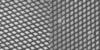
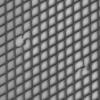
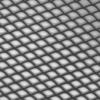
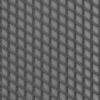
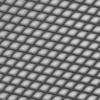
...
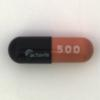
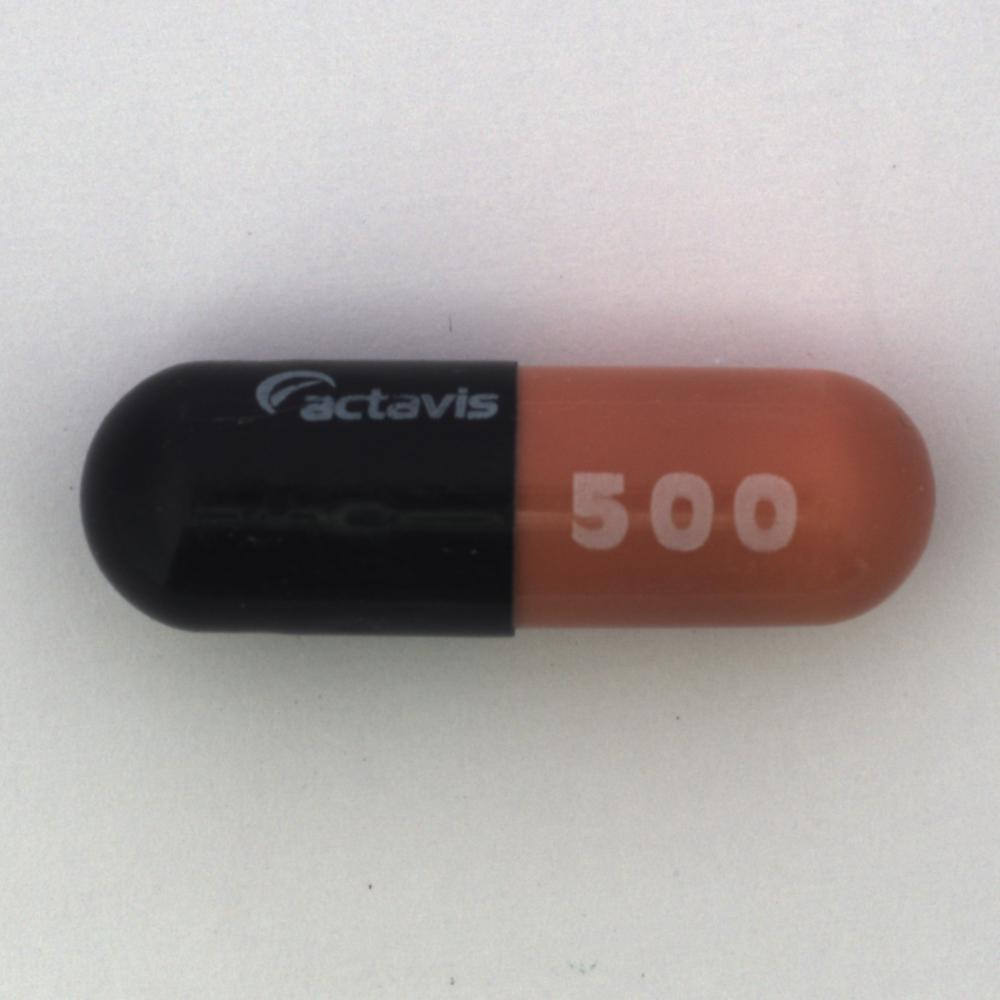
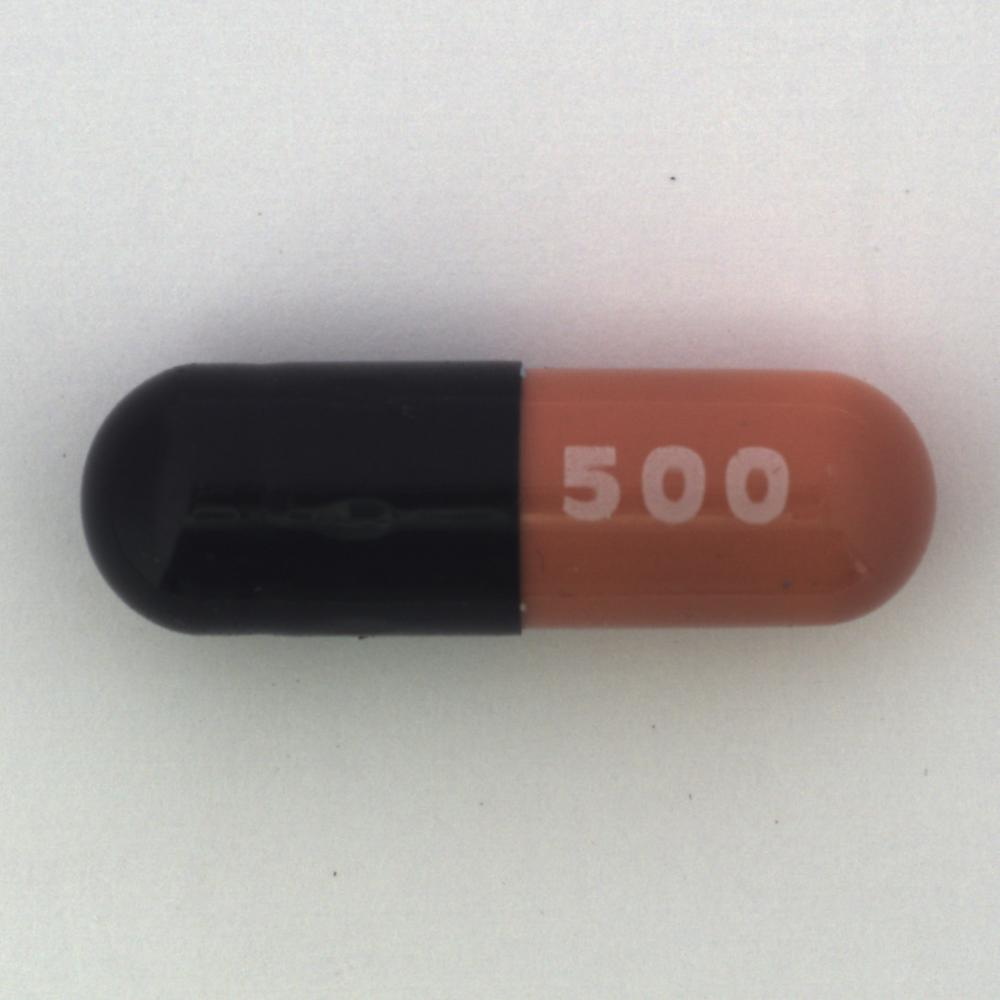
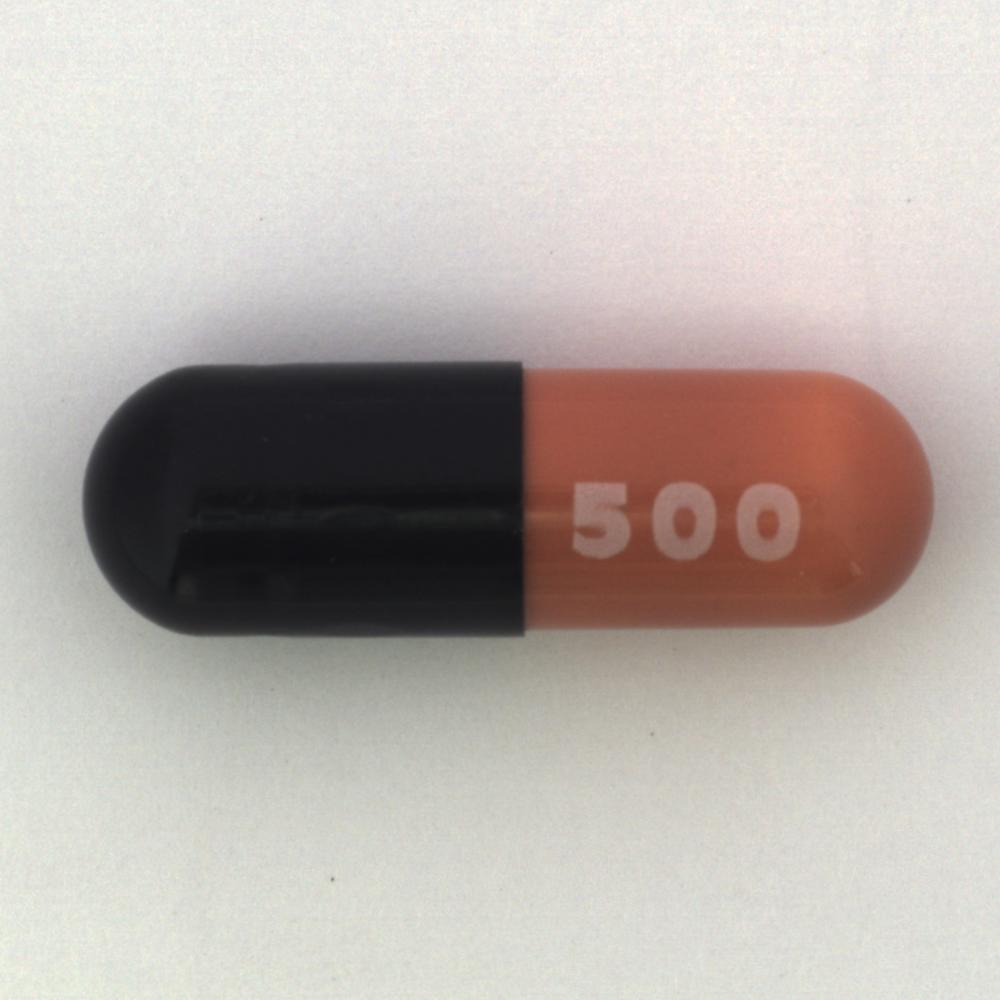
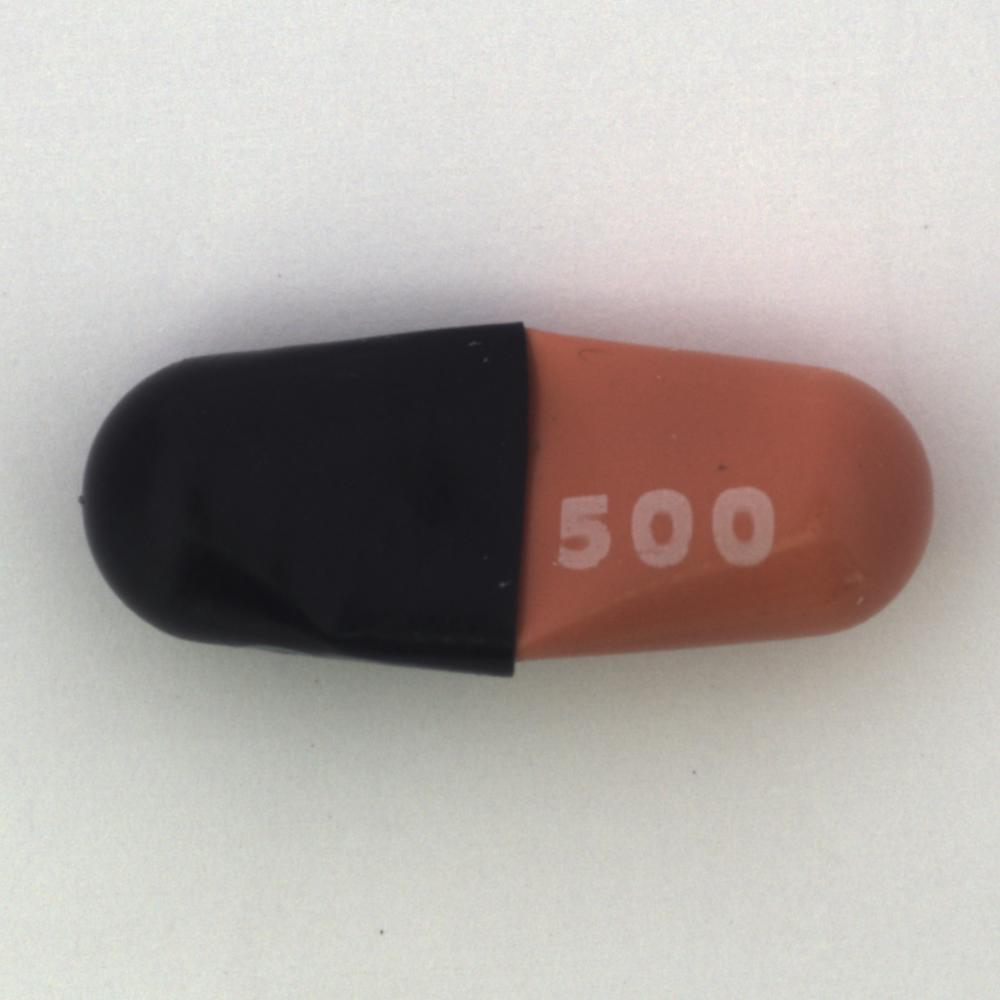

In [ ]:
#@title { vertical-output: true}
dataset = vqa_ano_detection(
    name="few_shot",
    dataset=dataset,
    prompt=one_shot_prompt,
    image_columns = [
        "pil_reference",
        "pil_reference2",
        "pil_reference3",
        "pil_image"
    ]
)

## Qwen

In [ ]:


one_shot_prompt_qwen = """
When compared to the first image, are there any anomlies or defects in the second image?
"""


few_shot_prompt_qwen =  """
When compared to the first three images, are there any anomlies or defects in the last image?
"""

zero_shot_prompt_qwen = """
Are there any anomalies or defects?
"""

#Desribe the condition of the object.
#In case of an anomaly, print NOT OK and describe the anomaly. Otherwise, print OK.

In [ ]:
#@title { vertical-output: true}


DEFAULT_CKPT_PATH = '4bit/Qwen-VL-Chat-Int4'
REVISION = 'v1.0.0'
BOX_TAG_PATTERN = r"<box>([\s\S]*?)</box>"
PUNCTUATION = "！？。＂＃＄％＆＇（）＊＋，－／：；＜＝＞＠［＼］＾＿｀｛｜｝～｟｠｢｣､、〃》「」『』【】〔〕〖〗〘〙〚〛〜〝〞〟〰〾〿–—‘’‛“”„‟…‧﹏."


def _load_model_tokenizer():
    model_id = DEFAULT_CKPT_PATH
    model_dir = snapshot_download(model_id)
    tokenizer = AutoTokenizer.from_pretrained(
        model_dir, trust_remote_code=True, resume_download=True,
    )


    model = AutoModelForCausalLM.from_pretrained(
        model_dir,
        device_map="auto",
        trust_remote_code=True,
        resume_download=True,
    ).eval()
    model.generation_config = GenerationConfig.from_pretrained(
        model_dir, trust_remote_code=True, resume_download=True,
    )

    return model, tokenizer


model, tokenizer = _load_model_tokenizer()



/usr/local/lib/python3.10/dist-packages/huggingface_hub/utils/_token.py:88: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(


Fetching 20 files:   0%|          | 0/20 [00:00<?, ?it/s]

Loading checkpoint shards:   0%|          | 0/5 [00:00<?, ?it/s]

In [ ]:
# Setting the generation configuration parameters
model.generation_config.temperature = 1
model.generation_config.max_length = 512
model.generation_config.top_p = 1
model.generation_config.top_k = 50
model.generation_config.do_sample=False
print(model.generation_config)

GenerationConfig {
  "chat_format": "chatml",
  "eos_token_id": 151643,
  "max_length": 512,
  "max_new_tokens": 512,
  "max_window_size": 6144,
  "pad_token_id": 151643,
  "trust_remote_code": true
}



In [ ]:

def has_defect(response):
    """reponse answers: Is OK? -> Invert answer from response"""

    response = response.lower()
    if "true" in  response:
        return True
    if "false" in response:
        return False
    return False


def vqa_ano_detection_qwen(name: str, dataset: List[dict], prompt: str, image_columns: List[str], verbose=True) -> List[dict]:

    for index, row in tqdm(list(enumerate(dataset))):
        response_col = f"{name}_response"
        plain_response_col = f"{name}_plain_response"
        prompt_col = f"{name}_prompt"
        plain_prompt_col = f"{name}_plain_prompt"
        pred_col = f"{name}_prediction"
        date_col = f"{name}_date"

        # Ignore rows that already have a response
        #if response_col in row and row[response_col] is not None:
        #    continue


        # Construct the prompt payload using the tokenizer's list format
        query = []
        for i, image_col in enumerate(image_columns):
            image_path = row[image_col]  # Assuming it's a URL or a path
            if i == 0 and len(image_columns) > 1: query.append({'text': "First image:"})
            if i == 1: query.append({'text': "Second image:"})  # Add the image number
            if i == 2: query.append({'text': "Third image"})
            if i == 3: query.append({'text': "Last image"})  # Add the textual prompt information
              # Add the textual prompt information

            query.append({'image': image_path})  # Add image to the query list
        query.append({'text': prompt})  # Add the textual prompt information

        # Get the response from qwen
        try:
            # Use the constructed query with the tokenizer's from_list_format method

            tokenized_query = tokenizer.from_list_format(query)
            plain_response, history = model.chat(tokenizer, query=tokenized_query, history=None)
            if verbose:
                print(index, dataset[index]["label_name"], plain_response)

            prompt_part2 =  'Are there defects or anomalies? Answer "True" or "False". Answer:'
            query_2 = [{"text": prompt_part2}]
            tokenized_query2 = tokenizer.from_list_format(query_2)
            plain_response, history = model.chat(tokenizer, prompt_part2, history=history)

            if verbose:
                print("N/OK ANSWER:", plain_response)

        except Exception as e:
            print(e)
            continue

        assert plain_response is not None


        # Update the row by adding new columns
        dataset[index].update({
            prompt_col: prompt + " [ANSWER] " + prompt_part2,  # Original text prompt
            plain_prompt_col: query,  # Full prompt including image tags
            response_col: plain_response,  # The main response
            plain_response_col: plain_response,  # As 'plain_response' already represents the raw response
            pred_col: "NOT OK" if has_defect(plain_response) else "OK",  # Prediction based on the response content
            date_col: today  # Date of the experiment
        })

    # Display a sample of random rows of the dataset in html
    # Assuming 'show' and 'pd' (pandas) are defined and imported
    show(pd.DataFrame(dataset))

    return dataset

### Experiment 1: Zero-Shot Prompt

  0%|          | 0/163 [00:00<?, ?it/s]

0 broken_small Yes, there is a small hole in the bottom of the bottle.


  1%|          | 1/163 [00:03<10:25,  3.86s/it]

N/OK ANSWER: True.
1 broken_small Yes, there is a crack in the top of the bottle.


  1%|          | 2/163 [00:06<09:02,  3.37s/it]

N/OK ANSWER: True.
2 broken_small Yes, there is a crack in the top of the bottle, which is an anomaly or defect in the glassware.


  2%|▏         | 3/163 [00:09<08:38,  3.24s/it]

N/OK ANSWER: True.
3 contamination There is no existence of any anomalies or defects in the image description.


  2%|▏         | 4/163 [00:12<07:34,  2.86s/it]

N/OK ANSWER: False.
4 contamination Yes, there is a small hole in the top of the bottle.


  3%|▎         | 5/163 [00:14<06:56,  2.63s/it]

N/OK ANSWER: True.
5 broken_large Yes, there is a small crack in the top of the bottle.


  4%|▎         | 6/163 [00:16<06:43,  2.57s/it]

N/OK ANSWER: True.
6 broken_large Yes, there is a noticeable defect in the bottom of the bottle, which is a broken part of the glass.


  4%|▍         | 7/163 [00:20<07:12,  2.77s/it]

N/OK ANSWER: True.
7 good Yes, there is a small crack on the top of the bottle.


  5%|▍         | 8/163 [00:22<06:47,  2.63s/it]

N/OK ANSWER: True.
8 good There is no existence of any anomalies or defects in the image description.


  6%|▌         | 9/163 [00:24<06:31,  2.54s/it]

N/OK ANSWER: False.
9 faulty_imprint There is no existence of any anomalies or defects in the image description.


  6%|▌         | 10/163 [00:27<06:19,  2.48s/it]

N/OK ANSWER: False.
10 faulty_imprint There is no existence of any anomalies or defects in the image description.


  7%|▋         | 11/163 [00:29<06:11,  2.45s/it]

N/OK ANSWER: False.
11 faulty_imprint There is no existence of any anomalies or defects in the image description.


  7%|▋         | 12/163 [00:32<06:17,  2.50s/it]

N/OK ANSWER: False.
12 scratch There is no existence of any anomalies or defects in the image description.


  8%|▊         | 13/163 [00:34<06:22,  2.55s/it]

N/OK ANSWER: False.
13 scratch There is no existence of any anomalies or defects in the image description.


  9%|▊         | 14/163 [00:37<06:12,  2.50s/it]

N/OK ANSWER: False.
14 good There is no existence of any anomalies or defects in the image description.


  9%|▉         | 15/163 [00:39<06:03,  2.45s/it]

N/OK ANSWER: False.
15 good There is no existence of any anomalies or defects in the image description.


 10%|▉         | 16/163 [00:41<05:58,  2.44s/it]

N/OK ANSWER: False.
16 crack There is no existence of any anomalies or defects in the image description.


 10%|█         | 17/163 [00:44<05:53,  2.42s/it]

N/OK ANSWER: False.
17 crack There is no existence of any anomalies or defects in the image description.


 11%|█         | 18/163 [00:46<06:03,  2.50s/it]

N/OK ANSWER: False.
18 crack Yes, there is a broken or cracked part of the capsule, which indicates that it may not be in its original, intact form.


 12%|█▏        | 19/163 [00:50<06:46,  2.82s/it]

N/OK ANSWER: True.
19 poke There is no existence of any anomalies or defects in the image description.


 12%|█▏        | 20/163 [00:52<06:26,  2.70s/it]

N/OK ANSWER: False.
20 poke There is no existence of any anomalies or defects in the image description.


 13%|█▎        | 21/163 [00:55<06:12,  2.63s/it]

N/OK ANSWER: False.
21 squeeze There is no existence of any anomalies or defects in the image description.


 13%|█▎        | 22/163 [00:57<06:01,  2.57s/it]

N/OK ANSWER: False.
22 squeeze There is no existence of any anomalies or defects in the image description.


 14%|█▍        | 23/163 [01:00<05:57,  2.55s/it]

N/OK ANSWER: False.
23 cut There is a hole in the middle of the woven material in the image.


 15%|█▍        | 24/163 [01:04<06:45,  2.92s/it]

N/OK ANSWER: True. There is a hole in the middle of the woven material in the image.
24 cut There is a hole in the middle of the woven material, which is a defect in the fabric.


 15%|█▌        | 25/163 [01:07<06:57,  3.03s/it]

N/OK ANSWER: True. There is a hole in the middle of the woven material.
25 metal_contamination There is a hole in the middle of the woven material in the image.


 16%|█▌        | 26/163 [01:10<07:02,  3.08s/it]

N/OK ANSWER: True. There is a hole in the middle of the woven material in the image.
26 metal_contamination There is a small hole in the middle of the woven material in the image.


 17%|█▋        | 27/163 [01:13<07:07,  3.15s/it]

N/OK ANSWER: True. There is a small hole in the middle of the woven material in the image.
27 good There is no existence of any anomalies or defects in the image description.


 17%|█▋        | 28/163 [01:16<06:44,  3.00s/it]

N/OK ANSWER: False.
28 good There is no existence of any anomalies or defects in the image description.


 18%|█▊        | 29/163 [01:19<06:29,  2.91s/it]

N/OK ANSWER: False.
29 good There is no existence of any anomalies or defects in the image description.


 18%|█▊        | 30/163 [01:21<06:05,  2.75s/it]

N/OK ANSWER: False.
30 hole There is a single knot in the woven material, which is a defect in the otherwise seamless and uniform texture.


 19%|█▉        | 31/163 [01:24<06:03,  2.75s/it]

N/OK ANSWER: True.
31 thread Yes, there is a hole in the middle of the woven material in the image.


 20%|█▉        | 32/163 [01:27<06:15,  2.87s/it]

N/OK ANSWER: True. There is a hole in the middle of the woven material.
32 thread There is a hole in the middle of the woven material in the image.


 20%|██        | 33/163 [01:31<06:40,  3.08s/it]

N/OK ANSWER: True. There is a hole in the middle of the woven material in the image.
33 color There is a single hole in the middle of the woven material, which is a defect in the fabric.


 21%|██        | 34/163 [01:34<07:01,  3.26s/it]

N/OK ANSWER: True. There is a hole in the middle of the woven material.
34 color There is a noticeable stain on the fabric, which could be considered an anomaly or defect.


 21%|██▏       | 35/163 [01:37<06:47,  3.19s/it]

N/OK ANSWER: True. There is a noticeable stain on the fabric.
35 glue Yes, there is a hole in the metal mesh.


 22%|██▏       | 36/163 [01:40<06:08,  2.90s/it]

N/OK ANSWER: True.
36 glue Yes, there is a single hole in the metal grid.


 23%|██▎       | 37/163 [01:42<05:40,  2.71s/it]

N/OK ANSWER: True.
37 thread Yes, there is a hole in the surface of the mesh material.


 23%|██▎       | 38/163 [01:44<05:33,  2.67s/it]

N/OK ANSWER: True.
38 bent Yes, there is a crack in the metal grate, which is an anomaly in the otherwise uniform pattern.


 24%|██▍       | 39/163 [01:47<05:44,  2.78s/it]

N/OK ANSWER: True.
39 broken Yes, there are some defects or anomalies in the image. A hole can be seen in the metal grid, and there are also cracks in the structure.


 25%|██▍       | 40/163 [01:51<05:56,  2.90s/it]

N/OK ANSWER: True.
40 metal_contamination Yes, there are some defects in the image, which could be considered as anomalies.


 25%|██▌       | 41/163 [01:53<05:38,  2.77s/it]

N/OK ANSWER: True.
41 good There are no visible anomalies or defects in the image.


 26%|██▌       | 42/163 [01:55<05:13,  2.59s/it]

N/OK ANSWER: False.
42 good There are no visible anomalies or defects in the image. The pattern appears to be consistent and well-defined.


 26%|██▋       | 43/163 [01:58<05:16,  2.63s/it]

N/OK ANSWER: False.
43 print Yes, there is a split in the shell of the hazelnut, indicating a defect or anomaly in the fruit.


 27%|██▋       | 44/163 [02:01<05:37,  2.84s/it]

N/OK ANSWER: True.
44 print Yes, there is a crack in the shell of the hazelnut.


 28%|██▊       | 45/163 [02:04<05:20,  2.72s/it]

N/OK ANSWER: True.
45 good There is no existence of any anomalies or defects in the image description.


 28%|██▊       | 46/163 [02:06<05:06,  2.62s/it]

N/OK ANSWER: False.
46 good Yes, there is a split in the shell of the hazelnut.


 29%|██▉       | 47/163 [02:09<04:57,  2.56s/it]

N/OK ANSWER: True.
47 good There is no existence of any anomalies or defects in the image description.


 29%|██▉       | 48/163 [02:11<04:48,  2.51s/it]

N/OK ANSWER: False.
48 good Yes, there is a split in the shell of the hazelnut, indicating a defect or anomaly in the fruit.


 30%|███       | 49/163 [02:14<05:10,  2.72s/it]

N/OK ANSWER: True.
49 crack Yes, there is a crack in the shell of the hazelnut.


 31%|███       | 50/163 [02:17<05:06,  2.72s/it]

N/OK ANSWER: True.
50 crack Yes, there is a crack in the shell of the hazelnut.


 31%|███▏      | 51/163 [02:19<04:54,  2.63s/it]

N/OK ANSWER: True.
51 cut Yes, there is a split in the shell of the hazelnut.


 32%|███▏      | 52/163 [02:22<04:46,  2.58s/it]

N/OK ANSWER: True.
52 cut Yes, there is a split in the shell of the hazelnut.


 33%|███▎      | 53/163 [02:24<04:38,  2.53s/it]

N/OK ANSWER: True.
53 hole Yes, there is a hole in the middle of the nut.


 33%|███▎      | 54/163 [02:27<04:34,  2.52s/it]

N/OK ANSWER: True.
54 color Yes, there is a stain on the brown leather surface in the image.


 34%|███▎      | 55/163 [02:30<05:05,  2.83s/it]

N/OK ANSWER: True. There is a stain on the brown leather surface in the image.
55 color Yes, there is a noticeable defect on the leather surface in the form of a dark spot.


 34%|███▍      | 56/163 [02:33<04:58,  2.79s/it]

N/OK ANSWER: True.
56 cut Yes, there is a hole in the brown leather surface.


 35%|███▍      | 57/163 [02:35<04:40,  2.65s/it]

N/OK ANSWER: True.
57 cut Yes, there is a hole in the brown leather surface.


 36%|███▌      | 58/163 [02:38<04:27,  2.55s/it]

N/OK ANSWER: True.
58 glue There is a water drop on the leather, which is an anomaly or defect in the material.


 36%|███▌      | 59/163 [02:40<04:27,  2.57s/it]

N/OK ANSWER: True.
59 glue Yes, there are two spots on the leather surface that appear to be missing or damaged.


 37%|███▋      | 60/163 [02:44<05:11,  3.02s/it]

N/OK ANSWER: True. There are defects and anomalies on the leather surface, specifically two spots that are missing or damaged.
60 good There is no existence of any defects or anomalies in the image description.


 37%|███▋      | 61/163 [02:47<04:53,  2.87s/it]

N/OK ANSWER: False.
61 good There is no existence of any defects or anomalies in the image description.


 38%|███▊      | 62/163 [02:49<04:34,  2.72s/it]

N/OK ANSWER: False.
62 good There is no existence of any defects or anomalies in the image description.


 39%|███▊      | 63/163 [02:52<04:22,  2.63s/it]

N/OK ANSWER: False.
63 poke Yes, there is a hole in the leather surface.


 39%|███▉      | 64/163 [02:54<04:07,  2.50s/it]

N/OK ANSWER: True.
64 poke Yes, there is a hole in the brown leather surface.


 40%|███▉      | 65/163 [02:56<04:00,  2.45s/it]

N/OK ANSWER: True.
65 fold Yes, there is a tear in the leather surface, which is an anomaly or defect in the material.


 40%|████      | 66/163 [02:59<04:17,  2.65s/it]

N/OK ANSWER: True.
66 fold Yes, there is a hole in the leather surface in the image.


 41%|████      | 67/163 [03:02<04:09,  2.60s/it]

N/OK ANSWER: True.
67 good There is no existence of any anomalies or defects in the image description.


 42%|████▏     | 68/163 [03:04<03:59,  2.52s/it]

N/OK ANSWER: False.
68 good Yes, there is a noticeable defect on the metal object, which could be a flaw or an imperfection in the material.


 42%|████▏     | 69/163 [03:07<04:06,  2.63s/it]

N/OK ANSWER: True.
69 good Yes, there is a crack in the metal object.


 43%|████▎     | 70/163 [03:09<03:52,  2.50s/it]

N/OK ANSWER: True.
70 scratch Yes, there is a defect on the surface of the object.


 44%|████▎     | 71/163 [03:12<03:49,  2.50s/it]

N/OK ANSWER: True.
71 scratch Yes, there is a crack in the metal object.


 44%|████▍     | 72/163 [03:14<03:44,  2.47s/it]

N/OK ANSWER: True.
72 bent There is no existence of any anomalies or defects in the image description.


 45%|████▍     | 73/163 [03:16<03:39,  2.44s/it]

N/OK ANSWER: False.
73 bent Yes, there is a crack in the milling cutter.


 45%|████▌     | 74/163 [03:19<03:31,  2.37s/it]

N/OK ANSWER: True.
74 color Yes, there is a small blue dot on the object, which could be an anomaly or defect.


 46%|████▌     | 75/163 [03:22<03:59,  2.72s/it]

N/OK ANSWER: True. There is a small blue dot on the object, which could be an anomaly or defect.
75 color Yes, there are some small black dots on the surface of the object.


 47%|████▋     | 76/163 [03:25<03:49,  2.64s/it]

N/OK ANSWER: True.
76 color Yes, there is a red spot on the metal object, which could be an anomaly or defect.


 47%|████▋     | 77/163 [03:28<03:56,  2.76s/it]

N/OK ANSWER: True.
77 flip There is no existence of any anomalies or defects in the image description.


 48%|████▊     | 78/163 [03:30<03:51,  2.72s/it]

N/OK ANSWER: False.
78 flip There is a small hole in the center of the object, which could be an anomaly or defect.


 48%|████▊     | 79/163 [03:33<03:47,  2.71s/it]

N/OK ANSWER: True.
79 contamination Yes, there is a defect on the white oval pill.


 49%|████▉     | 80/163 [03:35<03:34,  2.59s/it]

N/OK ANSWER: True.
80 contamination Yes, there is a defect on the white oval pill.


 50%|████▉     | 81/163 [03:38<03:24,  2.49s/it]

N/OK ANSWER: True.
81 contamination Yes, there is a defect on the white oval pill.


 50%|█████     | 82/163 [03:40<03:18,  2.45s/it]

N/OK ANSWER: True.
82 good Yes, there is a defect on the white oval pill.


 51%|█████     | 83/163 [03:42<03:17,  2.47s/it]

N/OK ANSWER: True.
83 good Yes, there is a defect on the white oval pill.


 52%|█████▏    | 84/163 [03:45<03:16,  2.49s/it]

N/OK ANSWER: True.
84 color Yes, there is a scratch on the surface of the oval-shaped pill.


 52%|█████▏    | 85/163 [03:47<03:13,  2.47s/it]

N/OK ANSWER: True.
85 color Yes, there is a defect on the surface of the oval-shaped pill.


 53%|█████▎    | 86/163 [03:50<03:09,  2.46s/it]

N/OK ANSWER: True.
86 color Yes, there is a defect on the white pill, which is noticeable under a microscope.


 53%|█████▎    | 87/163 [03:52<03:09,  2.49s/it]

N/OK ANSWER: True.
87 pill_type Yes, there is a defect on the white oval pill.


 54%|█████▍    | 88/163 [03:55<03:03,  2.44s/it]

N/OK ANSWER: True.
88 scratch Yes, there is a defect on the white oval pill.


 55%|█████▍    | 89/163 [03:57<03:02,  2.47s/it]

N/OK ANSWER: True.
89 scratch Yes, there is a crack in the middle of the oval-shaped pill.


 55%|█████▌    | 90/163 [04:00<03:03,  2.52s/it]

N/OK ANSWER: True.
90 combined Yes, there are some defects on the white pill.


 56%|█████▌    | 91/163 [04:02<02:54,  2.43s/it]

N/OK ANSWER: True.
91 combined Yes, there is a broken piece on the edge of the oval pill.


 56%|█████▋    | 92/163 [04:04<02:51,  2.42s/it]

N/OK ANSWER: True.
92 faulty_imprint Yes, there is a defect on the white oval pill.


 57%|█████▋    | 93/163 [04:07<02:46,  2.38s/it]

N/OK ANSWER: True.
93 faulty_imprint Yes, there is a defect on the white tablet.


 58%|█████▊    | 94/163 [04:09<02:42,  2.35s/it]

N/OK ANSWER: True.
94 crack Yes, there is a defect on the oval-shaped pill.


 58%|█████▊    | 95/163 [04:12<02:43,  2.40s/it]

N/OK ANSWER: True.
95 crack Yes, there is a defect on the white oval pill.


 59%|█████▉    | 96/163 [04:14<02:43,  2.43s/it]

N/OK ANSWER: True.
96 scratch_head There is no existence of any anomalies or defects in the image description.


 60%|█████▉    | 97/163 [04:16<02:39,  2.42s/it]

N/OK ANSWER: False.
97 scratch_head There is no existence of any anomalies or defects in the image description.


 60%|██████    | 98/163 [04:19<02:36,  2.40s/it]

N/OK ANSWER: False.
98 scratch_head There is no existence of any anomalies or defects in the image description.


 61%|██████    | 99/163 [04:21<02:32,  2.38s/it]

N/OK ANSWER: False.
99 good There is no existence of any anomalies or defects in the image.


 61%|██████▏   | 100/163 [04:24<02:30,  2.39s/it]

N/OK ANSWER: False.
100 good There is no existence of any anomalies or defects in the image description.


 62%|██████▏   | 101/163 [04:26<02:33,  2.47s/it]

N/OK ANSWER: False.
101 good There is no existence of any anomalies or defects in the image description.


 63%|██████▎   | 102/163 [04:29<02:33,  2.51s/it]

N/OK ANSWER: False.
102 good There is no existence of any anomalies or defects in the image description.


 63%|██████▎   | 103/163 [04:31<02:27,  2.46s/it]

N/OK ANSWER: False.
103 manipulated_front There is no existence of any anomalies or defects in the image description.


 64%|██████▍   | 104/163 [04:34<02:23,  2.43s/it]

N/OK ANSWER: False.
104 manipulated_front Yes, there is a broken point on the screw, indicating that it may not be in perfect condition or has been used before.


 64%|██████▍   | 105/163 [04:36<02:29,  2.58s/it]

N/OK ANSWER: True.
105 thread_top Yes, there is a broken point on the screw, indicating that it may not be in perfect condition or has been used before.


 65%|██████▌   | 106/163 [04:40<02:37,  2.76s/it]

N/OK ANSWER: True.
106 thread_top Yes, there is a noticeable defect on the screw, which appears to be broken or damaged.


 66%|██████▌   | 107/163 [04:43<02:37,  2.81s/it]

N/OK ANSWER: True.
107 thread_top Yes, there is a broken part of the screw visible in the image.


 66%|██████▋   | 108/163 [04:45<02:27,  2.69s/it]

N/OK ANSWER: True.
108 thread_side There is a small hole in the screw, which is an anomaly or defect in the object.


 67%|██████▋   | 109/163 [04:48<02:23,  2.66s/it]

N/OK ANSWER: True.
109 thread_side There is no existence of any anomalies or defects in the image description.


 67%|██████▋   | 110/163 [04:50<02:16,  2.57s/it]

N/OK ANSWER: False.
110 scratch_neck There is no existence of any anomalies or defects in the image description.


 68%|██████▊   | 111/163 [04:52<02:10,  2.51s/it]

N/OK ANSWER: False.
111 scratch_neck There is no existence of any anomalies or defects in the image description.


 69%|██████▊   | 112/163 [04:55<02:10,  2.55s/it]

N/OK ANSWER: False.
112 oil Yes, there is a defect in the surface of the material, which appears to be a scratch or a flaw.


 69%|██████▉   | 113/163 [04:58<02:16,  2.74s/it]

N/OK ANSWER: True.
113 oil Yes, there are some anomalies or defects visible in the image.


 70%|██████▉   | 114/163 [05:00<02:08,  2.62s/it]

N/OK ANSWER: True.
114 rough Yes, there is a large hole in the surface of the material, which is an anomaly or defect.


 71%|███████   | 115/163 [05:03<02:07,  2.65s/it]

N/OK ANSWER: True.
115 rough Yes, there are some defects visible in the image. These defects may be due to the presence of impurities or irregularities in the surface of the material.


 71%|███████   | 116/163 [05:06<02:13,  2.83s/it]

N/OK ANSWER: True.
116 crack Yes, there is a crack in the surface of the material.


 72%|███████▏  | 117/163 [05:09<02:07,  2.77s/it]

N/OK ANSWER: True.
117 good Yes, there are some defects on the surface of the material, which could be considered as anomalies.


 72%|███████▏  | 118/163 [05:12<02:08,  2.85s/it]

N/OK ANSWER: True.
118 good Yes, there are some defects on the surface of the material, which could be considered anomalies.


 73%|███████▎  | 119/163 [05:15<02:02,  2.79s/it]

N/OK ANSWER: True.
119 good Yes, there are some defects in the surface of the material, which could be considered anomalies.


 74%|███████▎  | 120/163 [05:17<01:57,  2.74s/it]

N/OK ANSWER: True.
120 good Yes, there are some defects visible in the surface of the material.


 74%|███████▍  | 121/163 [05:20<01:50,  2.64s/it]

N/OK ANSWER: True.
121 gray_stroke Yes, there is a large black spot on the surface, which is an anomaly or defect in the otherwise uniform gray and white surface.


 75%|███████▍  | 122/163 [05:23<01:53,  2.78s/it]

N/OK ANSWER: True.
122 glue_strip Yes, there are some defects visible in the image.


 75%|███████▌  | 123/163 [05:25<01:47,  2.70s/it]

N/OK ANSWER: True.
123 glue_strip Yes, there is a hole in the center of the white crystal.


 76%|███████▌  | 124/163 [05:28<01:43,  2.66s/it]

N/OK ANSWER: True.
124 good There is a single white bristle on the toothbrush that is not in line with the rest of the bristles.


 77%|███████▋  | 125/163 [05:32<01:57,  3.09s/it]

N/OK ANSWER: True. There is a single white bristle on the toothbrush that is not in line with the rest of the bristles.
125 good Yes, there is a defect in the toothbrush head, which appears to be broken or damaged.


 77%|███████▋  | 126/163 [05:35<01:50,  2.97s/it]

N/OK ANSWER: True.
126 defective There is a single dead fly on the toothbrush bristles.


 78%|███████▊  | 127/163 [05:38<01:48,  3.02s/it]

N/OK ANSWER: True. There is a dead fly on the toothbrush bristles.
127 defective There is a small defect on the side of the toothbrush head.


 79%|███████▊  | 128/163 [05:41<01:42,  2.93s/it]

N/OK ANSWER: True.
128 defective There is no existence of any anomalies or defects in the image description.


 79%|███████▉  | 129/163 [05:43<01:34,  2.78s/it]

N/OK ANSWER: False.
129 misplaced Yes, there is a small hole in the center of the black component.


 80%|███████▉  | 130/163 [05:46<01:35,  2.88s/it]

N/OK ANSWER: True. There is a small hole in the center of the black component.
130 cut_lead There is no existence of any anomalies or defects in the image description.


 80%|████████  | 131/163 [05:49<01:27,  2.74s/it]

N/OK ANSWER: False.
131 damaged_case Yes, there is a burnt spot on the transistor, indicating that it may have experienced some damage or malfunction.


 81%|████████  | 132/163 [05:53<01:37,  3.16s/it]

N/OK ANSWER: True. There is a burnt spot on the transistor, which suggests that it has experienced some damage or malfunction.
132 good There is no existence of any anomalies or defects in the image description.


 82%|████████▏ | 133/163 [05:55<01:30,  3.03s/it]

N/OK ANSWER: False.
133 good There is a small hole in the black component, which is a potential anomaly or defect in the electronic component.


 82%|████████▏ | 134/163 [05:58<01:26,  2.97s/it]

N/OK ANSWER: True.
134 good There is no existence of any anomalies or defects in the image description.


 83%|████████▎ | 135/163 [06:01<01:18,  2.81s/it]

N/OK ANSWER: False.
135 good There is no existence of any anomalies or defects in the image description.


 83%|████████▎ | 136/163 [06:03<01:12,  2.70s/it]

N/OK ANSWER: False.
136 good There is no existence of any anomalies or defects in the image description.


 84%|████████▍ | 137/163 [06:06<01:08,  2.62s/it]

N/OK ANSWER: False.
137 good There is a small hole in the center of the transistor.


 85%|████████▍ | 138/163 [06:09<01:10,  2.82s/it]

N/OK ANSWER: True. There is a small hole in the center of the transistor.
138 bent_lead There is no existence of any anomalies or defects in the image description.


 85%|████████▌ | 139/163 [06:11<01:06,  2.77s/it]

N/OK ANSWER: False.
139 good There are no visible anomalies or defects in the image. The wood appears to be smooth and well-maintained.


 86%|████████▌ | 140/163 [06:14<01:04,  2.79s/it]

N/OK ANSWER: False.
140 good There are no visible anomalies or defects in the image.


 87%|████████▋ | 141/163 [06:17<00:57,  2.63s/it]

N/OK ANSWER: False.
141 liquid Yes, there is a knot in the wood grain, which is an anomaly in the otherwise uniform appearance of the wooden surface.


 87%|████████▋ | 142/163 [06:20<01:02,  2.96s/it]

N/OK ANSWER: True. There are defects and anomalies in the wooden surface, including a knot in the wood grain.
142 scratch Yes, there is a crack in the wooden surface.


 88%|████████▊ | 143/163 [06:23<00:56,  2.82s/it]

N/OK ANSWER: True.
143 scratch Yes, there are some defects on the surface of the wooden material in the image.


 88%|████████▊ | 144/163 [06:26<00:57,  3.04s/it]

N/OK ANSWER: True. There are defects on the surface of the wooden material in the image.
144 hole Yes, there are two holes in the wooden surface, which are anomalies or defects in the wood.


 89%|████████▉ | 145/163 [06:30<00:56,  3.13s/it]

N/OK ANSWER: True. There are defects or anomalies in the wooden surface, specifically two holes.
145 combined Yes, there is a scratch on the wooden surface.


 90%|████████▉ | 146/163 [06:32<00:50,  2.99s/it]

N/OK ANSWER: True. There is a scratch on the wooden surface.
146 combined Yes, there is a knot in the wood.


 90%|█████████ | 147/163 [06:35<00:44,  2.76s/it]

N/OK ANSWER: True.
147 broken_teeth There is no existence of any anomalies or defects in the image description.


 91%|█████████ | 148/163 [06:37<00:40,  2.72s/it]

N/OK ANSWER: False.
148 broken_teeth Yes, there is a broken zipper on the black fabric, which is an anomaly or defect.


 91%|█████████▏| 149/163 [06:40<00:38,  2.77s/it]

N/OK ANSWER: True.
149 good There is no existence of any anomalies or defects in the image description.


 92%|█████████▏| 150/163 [06:42<00:34,  2.65s/it]

N/OK ANSWER: False.
150 good There is no existence of any anomalies or defects in the image description.


 93%|█████████▎| 151/163 [06:45<00:30,  2.56s/it]

N/OK ANSWER: False.
151 good There is no existence of any anomalies or defects in the image description.


 93%|█████████▎| 152/163 [06:47<00:27,  2.50s/it]

N/OK ANSWER: False.
152 good There is no existence of any anomalies or defects in the image description.


 94%|█████████▍| 153/163 [06:50<00:24,  2.46s/it]

N/OK ANSWER: False.
153 split_teeth There is no existence of any anomalies or defects in the image description.


 94%|█████████▍| 154/163 [06:52<00:22,  2.51s/it]

N/OK ANSWER: False.
154 combined Yes, there is a hole in the zipper, which indicates a defect or anomaly in the object.


 95%|█████████▌| 155/163 [06:55<00:21,  2.66s/it]

N/OK ANSWER: True.
155 combined Yes, there is a defect in the zipper, which is a broken zipper.


 96%|█████████▌| 156/163 [06:58<00:18,  2.59s/it]

N/OK ANSWER: True.
156 fabric_border Yes, there is a hole in the fabric near the zipper.


 96%|█████████▋| 157/163 [07:00<00:14,  2.50s/it]

N/OK ANSWER: True.
157 fabric_border Yes, there is a hole in the fabric near the zipper.


 97%|█████████▋| 158/163 [07:02<00:12,  2.43s/it]

N/OK ANSWER: True.
158 squeezed_teeth Yes, there is a hole in the zipper, which is an anomaly or defect in the image.


 98%|█████████▊| 159/163 [07:05<00:10,  2.51s/it]

N/OK ANSWER: True.
159 rough There is no existence of any anomalies or defects in the image description.


 98%|█████████▊| 160/163 [07:08<00:07,  2.55s/it]

N/OK ANSWER: False.
160 rough Yes, there is a broken zipper on the black fabric, which is an anomaly or defect.


 99%|█████████▉| 161/163 [07:10<00:05,  2.61s/it]

N/OK ANSWER: True.
161 fabric_interior Yes, there is a hole in the fabric near the zipper.


 99%|█████████▉| 162/163 [07:13<00:02,  2.52s/it]

N/OK ANSWER: True.
162 fabric_interior Yes, there is a stain on the black fabric in the image.


100%|██████████| 163/163 [07:15<00:00,  2.67s/it]

N/OK ANSWER: True. There is a stain on the black fabric in the image.
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 163 entries, 0 to 162
Data columns (total 31 columns):
 #   Column                         Non-Null Count  Dtype 
---  ------                         --------------  ----- 
 0   stacked_image                  163 non-null    object
 1   image                          163 non-null    object
 2   reference                      163 non-null    object
 3   reference2                     163 non-null    object
 4   reference3                     163 non-null    object
 5   reference4                     163 non-null    object
 6   label                          163 non-null    object
 7   label_name                     163 non-null    object
 8   class                          163 non-null    object
 9   file_name                      163 non-null    object
 10  reference_file_name            163 non-null    object
 11  reference_file_name2           163 non-null    object

None

,stacked_image,image,reference,reference2,reference3,reference4,label,label_name,class,file_name,reference_file_name,reference_file_name2,reference_file_name3,reference_file_name4,stacked_pil_image,pil_image,pil_reference,pil_reference2,pil_reference3,pil_reference4,test_image_path,reference_image_path,reference_image_path2,reference_image_path3,reference_image_path4,zero_shot_qwen_prompt,zero_shot_qwen_plain_prompt,zero_shot_qwen_response,zero_shot_qwen_plain_response,zero_shot_qwen_prediction,zero_shot_qwen_date
150,,,,,,,OK,good,zipper,030.png,011.png,215.png,165.png,159.png,,,,,,,/content/drive/MyDrive/Data/mvtec/zipper/test/good/030.png,/content/drive/MyDrive/Data/mvtec_train/zipper/train/good/011.png,/content/drive/MyDrive/Data/mvtec_train/zipper/train/good/215.png,/content/drive/MyDrive/Data/mvtec_train/zipper/train/good/165.png,/content/drive/MyDrive/Data/mvtec_train/zipper/train/good/159.png,"\nAre there any anomalies or defects?\n [ANSWER] Are there defects or anomalies? Answer ""True"" or ""False"". Answer:","[{'image': '/content/drive/MyDrive/Data/mvtec/zipper/test/good/030.png'}, {'text': ' Are there any anomalies or defects? '}]",False.,False.,OK,2024-01-15
1,,,,,,,NOT OK,broken_small,bottle,001.png,072.png,045.png,018.png,126.png,,,,,,,/content/drive/MyDrive/Data/mvtec/bottle/test/broken_small/001.png,/content/drive/MyDrive/Data/mvtec_train/bottle/train/good/072.png,/content/drive/MyDrive/Data/mvtec_train/bottle/train/good/045.png,/content/drive/MyDrive/Data/mvtec_train/bottle/train/good/018.png,/content/drive/MyDrive/Data/mvtec_train/bottle/train/good/126.png,"\nAre there any anomalies or defects?\n [ANSWER] Are there defects or anomalies? Answer ""True"" or ""False"". Answer:","[{'image': '/content/drive/MyDrive/Data/mvtec/bottle/test/broken_small/001.png'}, {'text': ' Are there any anomalies or defects? '}]",True.,True.,NOT OK,2024-01-15
80,,,,,,,NOT OK,contamination,pill,012.png,047.png,208.png,030.png,008.png,,,,,,,/content/drive/MyDrive/Data/mvtec/pill/test/contamination/012.png,/content/drive/MyDrive/Data/mvtec_train/pill/train/good/047.png,/content/drive/MyDrive/Data/mvtec_train/pill/train/good/208.png,/content/drive/MyDrive/Data/mvtec_train/pill/train/good/030.png,/content/drive/MyDrive/Data/mvtec_train/pill/train/good/008.png,"\nAre there any anomalies or defects?\n [ANSWER] Are there defects or anomalies? Answer ""True"" or ""False"". Answer:","[{'image': '/content/drive/MyDrive/Data/mvtec/pill/test/contamination/012.png'}, {'text': ' Are there any anomalies or defects? '}]",True.,True.,NOT OK,2024-01-15
2,,,,,,,NOT OK,broken_small,bottle,010.png,010.png,163.png,110.png,001.png,,,,,,,/content/drive/MyDrive/Data/mvtec/bottle/test/broken_small/010.png,/content/drive/MyDrive/Data/mvtec_train/bottle/train/good/010.png,/content/drive/MyDrive/Data/mvtec_train/bottle/train/good/163.png,/content/drive/MyDrive/Data/mvtec_train/bottle/train/good/110.png,/content/drive/MyDrive/Data/mvtec_train/bottle/train/good/001.png,"\nAre there any anomalies or defects?\n [ANSWER] Are there defects or anomalies? Answer ""True"" or ""False"". Answer:","[{'image': '/content/drive/MyDrive/Data/mvtec/bottle/test/broken_small/010.png'}, {'text': ' Are there any anomalies or defects? '}]",True.,True.,NOT OK,2024-01-15
14,,,,,,,OK,good,capsule,006.png,070.png,126.png,128.png,068.png,,,,,,,/content/drive/MyDrive/Data/mvtec/capsule/test/good/006.png,/content/drive/MyDrive/Data/mvtec_train/capsule/train/good/070.png,/content/drive/MyDrive/Data/mvtec_train/capsule/train/good/126.png,/content/drive/MyDrive/Data/mvtec_train/capsule/train/good/128.png,/content/drive/MyDrive/Data/mvtec_train/capsule/train/good/068.png,"\nAre there any anomalies or defects?\n [ANSWER] Are there defects or anomalies? Answer ""True"" or ""False"". Answer:","[{'image': '/content/drive/MyDrive/Data/mvtec/capsule/test/good/006.png'}, {'text': ' Are there any anomalies or defects? '}]",False.,False.,OK,2024-01-15

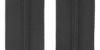
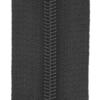
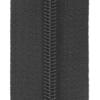
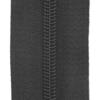
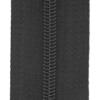
...
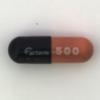
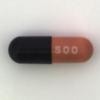
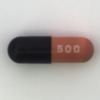
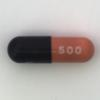
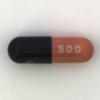

In [ ]:
#@title { vertical-output: true}


dataset = vqa_ano_detection_qwen(
    name="zero_shot_qwen",
    dataset=dataset,
    prompt=zero_shot_prompt_qwen,
    image_columns = ["test_image_path"]
)
temp_file_path = data_root.parent / ("temp_qwenano_dataset"+today+".csv")
# Save the DataFrame to a CSV file as a snapshot
pd.DataFrame(dataset).to_csv(temp_file_path, index=False)

### Experiment 2 - One Shot



  0%|          | 0/163 [00:00<?, ?it/s]

0 broken_small There is a noticeable difference in the cleanliness of the second image compared to the first image. In the second image, the bottle appears to be more dirty, with a film or residue on the inside, while the first image shows a cleaner, more polished appearance. This difference could be due to the age or usage of the bottle, as well as the storage conditions and handling of the product.


  1%|          | 1/163 [00:16<44:55, 16.64s/it]

N/OK ANSWER: False. The second image is a close-up of the inside of a bottle, and it appears to be clean and free of any visible defects or anomalies.
1 broken_small There is a notable difference in the cleanliness of the second image compared to the first. In the second image, the bottle appears to be more dirty, with a film or residue on the inside, while the first image shows a cleaner, more polished surface. This difference in appearance might be due to the age or usage of the bottle, affecting its visual quality.


  1%|          | 2/163 [00:23<29:48, 11.11s/it]

N/OK ANSWER: False. The image is a close-up of a dark-colored bottle, but there are no visible defects or anomalies that would draw attention.
2 broken_small Yes, there is a noticeable defect in the second image. The top of the bottle is cracked, which is different from the first image where the bottle appears to be intact.


  2%|▏         | 3/163 [00:27<20:54,  7.84s/it]

N/OK ANSWER: True.
3 contamination There is no existence of any defects or anomalies in the second image.


  2%|▏         | 4/163 [00:31<15:58,  6.03s/it]

N/OK ANSWER: False.
4 contamination There is a noticeable difference in the cleanliness and condition of the second image compared to the first. The second image appears to be more worn, with a visible crack in the glass, while the first image shows a pristine,全新且未使用的状态 of the bottle. This difference in appearance and condition might affect the value or desirability of the bottle for certain uses, such as for decorative purposes or as a collectible item.


  3%|▎         | 5/163 [00:39<18:01,  6.85s/it]

N/OK ANSWER: True. There is a noticeable difference in the cleanliness and condition of the second image compared to the first, with the second image showing signs of wear and a crack in the glass.
5 broken_large There is no existence of any defects or anomalies in the second image.


  4%|▎         | 6/163 [00:42<14:27,  5.53s/it]

N/OK ANSWER: False.
6 broken_large Yes, there is a noticeable defect in the second image. The top of the bottle appears to be chipped or damaged, which is not present in the first image. This difference in appearance could be due to the age or condition of the bottle, or it could be a result of the photo being taken from a different angle or perspective.


  4%|▍         | 7/163 [00:49<16:07,  6.20s/it]

N/OK ANSWER: True. There is a noticeable defect in the second image, which is the chipped or damaged top of the bottle.
7 good There is no existence of any defects or anomalies in the second image.


  5%|▍         | 8/163 [00:52<13:21,  5.17s/it]

N/OK ANSWER: False.
8 good There is no existence of any defects or anomalies in the second image.


  6%|▌         | 9/163 [00:55<11:31,  4.49s/it]

N/OK ANSWER: False.
9 faulty_imprint There is no existence of any defects or anomalies in the second image.


  6%|▌         | 10/163 [00:59<10:22,  4.07s/it]

N/OK ANSWER: False.
10 faulty_imprint There is no existence of any defects or anomalies in the second image.


  7%|▋         | 11/163 [01:02<09:45,  3.85s/it]

N/OK ANSWER: False.
11 faulty_imprint There is no existence of any defects or anomalies in the second image.


  7%|▋         | 12/163 [01:05<09:04,  3.60s/it]

N/OK ANSWER: False.
12 scratch There is no existence of any defects or anomalies in the second image.


  8%|▊         | 13/163 [01:08<08:37,  3.45s/it]

N/OK ANSWER: False.
13 scratch There is no existence of any defects or anomalies in the second image.


  9%|▊         | 14/163 [01:11<08:16,  3.33s/it]

N/OK ANSWER: False.
14 good There are no anomalies or defects in the second image. Both images show a single capsule medication with a black and brown color scheme, and they both display the number "500" on the side of the capsule. The only difference between the two images is the background color, with the first image having a white background and the second image having a light-colored background.


  9%|▉         | 15/163 [01:19<11:56,  4.84s/it]

N/OK ANSWER: False. Both images show a single capsule medication with a black and brown color scheme, and they both display the number "500" on the side of the capsule.
15 good There is no existence of a second image in the provided information.


 10%|▉         | 16/163 [01:22<10:32,  4.30s/it]

N/OK ANSWER: False.
16 crack There is no existence of any defects or anomalies in the second image.


 10%|█         | 17/163 [01:26<09:34,  3.94s/it]

N/OK ANSWER: False.
17 crack There is no existence of any defects or anomalies in the second image.


 11%|█         | 18/163 [01:29<09:06,  3.77s/it]

N/OK ANSWER: False.
18 crack There is no existence of any defects or anomalies in the second image.


 12%|█▏        | 19/163 [01:32<08:43,  3.63s/it]

N/OK ANSWER: False.
19 poke There is no existence of any defects or anomalies in the second image.


 12%|█▏        | 20/163 [01:35<08:15,  3.47s/it]

N/OK ANSWER: False.
20 poke There is no existence of any defects or anomalies in the second image.


 13%|█▎        | 21/163 [01:38<07:56,  3.35s/it]

N/OK ANSWER: False.
21 squeeze There is no existence of any defects or anomalies in the second image.


 13%|█▎        | 22/163 [01:41<07:41,  3.27s/it]

N/OK ANSWER: False.
22 squeeze There is no existence of any defects or anomalies in the second image.


 14%|█▍        | 23/163 [01:45<07:44,  3.32s/it]

N/OK ANSWER: False.
23 cut There are no significant defects or anomalies in the second image compared to the first image. Both images show a close-up view of a gray woven fabric or textile material, which appears to be a woven cotton or linen fabric.


 15%|█▍        | 24/163 [01:49<08:32,  3.69s/it]

N/OK ANSWER: False.
24 cut There is a defect in the second image, which is a hole in the middle of the gray woven material.


 15%|█▌        | 25/163 [01:54<08:54,  3.87s/it]

N/OK ANSWER: True. There is a hole in the middle of the gray woven material.
25 metal_contamination There are no significant defects or anomalies in the second image compared to the first image. Both images show a close-up view of a gray woven fabric or textile material with a basketweave pattern.


 16%|█▌        | 26/163 [01:59<09:34,  4.20s/it]

N/OK ANSWER: False.
26 metal_contamination There are no significant defects or anomalies in the second image compared to the first image. Both images show a close-up view of a gray woven fabric or textile material with a basketweave pattern.


 17%|█▋        | 27/163 [02:03<09:35,  4.24s/it]

N/OK ANSWER: False.
27 good There are no significant defects or anomalies in the second image compared to the first image. Both images show a close-up view of a gray woven fabric or textile material with a basket weave pattern.


 17%|█▋        | 28/163 [02:07<09:30,  4.23s/it]

N/OK ANSWER: False.
28 good There are no significant defects or anomalies in the second image compared to the first image. Both images show a close-up view of a gray woven fabric or textile material, which appears to be a woven cotton or linen fabric.


 18%|█▊        | 29/163 [02:12<09:51,  4.41s/it]

N/OK ANSWER: False.
29 good There are no significant defects or anomalies in the second image compared to the first image. Both images show a close-up view of a woven fabric texture, which appears to be made of dark-colored threads or yarns. The fabric has a pattern of interwoven threads, creating a textured surface.


 18%|█▊        | 30/163 [02:20<11:49,  5.34s/it]

N/OK ANSWER: False. Both images show a close-up view of a woven fabric texture, which appears to be made of dark-colored threads or yarns. The fabric has a pattern of interwoven threads, creating a textured surface.
30 hole There are no significant defects or anomalies in the second image compared to the first image. Both images show a close-up view of a gray woven fabric or textile material with a basket weave pattern.


 19%|█▉        | 31/163 [02:24<11:01,  5.01s/it]

N/OK ANSWER: False.
31 thread There is no existence of any defects or anomalies in the second image description.


 20%|█▉        | 32/163 [02:27<09:56,  4.55s/it]

N/OK ANSWER: False.
32 thread There are no significant defects or anomalies in the second image compared to the first image. Both images show a close-up view of a woven fabric, which appears to be a dark-colored, textured material.


 20%|██        | 33/163 [02:32<09:47,  4.52s/it]

N/OK ANSWER: False.
33 color There are no significant defects or anomalies in the second image compared to the first image. Both images show a close-up view of a woven fabric texture, which appears to be made of a dark-colored material, possibly a type of fabric or textile.


 21%|██        | 34/163 [02:37<10:16,  4.78s/it]

N/OK ANSWER: False.
34 color There are no significant defects or anomalies in the second image compared to the first image. Both images show a close-up view of a woven fabric texture, which appears to be made of dark-colored threads or yarns. The fabric has a basketweave pattern and appears to be woven from dark-colored threads or yarns.


 21%|██▏       | 35/163 [02:43<11:09,  5.23s/it]

N/OK ANSWER: False.
35 glue Yes, there is a noticeable defect in the second image. A hole can be seen in the metal mesh, which is not present in the first image. This hole may affect the overall integrity and functionality of the metal mesh, depending on its intended use.


 22%|██▏       | 36/163 [02:49<11:29,  5.43s/it]

N/OK ANSWER: True. There is a hole in the metal mesh in the second image, which is not present in the first image.
36 glue Yes, there is a noticeable defect in the second image, where the expanded metal mesh appears to be damaged or broken. This defect is not present in the first image, which has a uniform and complete mesh pattern.


 23%|██▎       | 37/163 [02:54<10:45,  5.12s/it]

N/OK ANSWER: True.
37 thread There is a noticeable defect in the second image, where the expanded metal mesh appears to be damaged or broken. This defect is not present in the first image, which has a uniform and complete mesh pattern.


 23%|██▎       | 38/163 [03:00<11:14,  5.39s/it]

N/OK ANSWER: True. There is a defect or anomaly in the second image, where the expanded metal mesh appears to be damaged or broken.
38 bent There are no significant anomalies or defects in the second image, which is a close-up view of a metal grid or grate. The image is in black and white, which adds to the overall contrast and clarity of the grid pattern. The metal grid appears to be made of expanded metal, which is commonly used for architectural purposes, such as screens, fences, and walkways. The grid pattern is uniform and well-defined, without any visible damage or defects.


 24%|██▍       | 39/163 [03:07<12:34,  6.09s/it]

N/OK ANSWER: False. The image is a close-up view of a metal grid or grate, and there are no visible defects or anomalies.
39 broken Yes, there is a noticeable defect in the second image, where the expanded metal mesh appears to be damaged or broken. This defect is not present in the first image, which has a uniform and complete pattern.


 25%|██▍       | 40/163 [03:12<11:48,  5.76s/it]

N/OK ANSWER: True.
40 metal_contamination There is a noticeable defect in the second image, where one of the rows of interlocking shapes is missing. This defect is not present in the first image, making the second one appear less consistent and uniform.


 25%|██▌       | 41/163 [03:17<10:49,  5.32s/it]

N/OK ANSWER: True.
41 good There are no significant anomalies or defects in the second image when compared to the first image. Both pictures show a metal mesh or expanded metal texture, which appears to be a wavy pattern with interlocking loops. The focus of the image is on the texture and pattern of the metal, rather than any significant differences or defects.


 26%|██▌       | 42/163 [03:24<11:46,  5.84s/it]

N/OK ANSWER: False. Both images show a metal mesh or expanded metal texture, but there are no significant defects or anomalies that can be observed.
42 good There are no visible anomalies or defects in the second image when compared to the first one. Both images show a metal mesh or expanded metal texture, with a pattern of interlocking loops and curves.


 26%|██▋       | 43/163 [03:29<11:30,  5.76s/it]

N/OK ANSWER: False. Both images show a metal mesh or expanded metal texture, with a pattern of interlocking loops and curves.
43 print There is a noticeable defect in the second image, where one side of the榛子 has been cracked open, while the other side remains intact. This anomaly might affect the overall appearance and quality of the榛子, as it indicates some level of damage or compromise in the shell's integrity.


 27%|██▋       | 44/163 [03:35<11:04,  5.59s/it]

N/OK ANSWER: True.
44 print There is a notable difference in the appearance of the榛子 in the second image compared to the first. In the first image, the榛子 has a more intact and complete appearance, with the shell still covering most of it. In the second image, the榛子 appears to be damaged, with the shell partially removed or broken off, exposing a significant portion of the inner nut. This difference in appearance could be due to various factors, such as the nut being damaged during transportation, storage, or handling, or it could simply be a natural variation in the nut's shell.


 28%|██▊       | 45/163 [03:45<13:45,  7.00s/it]

N/OK ANSWER: True. The榛子 in the second image has a damaged shell, with the shell partially removed or broken off, exposing a significant portion of the inner nut.
45 good There is a noticeable blemish on the榛子 in the second image, which is not present in the first image. This difference in appearance may be due to a slight imperfection or damage to the榛子.


 28%|██▊       | 46/163 [03:49<12:11,  6.25s/it]

N/OK ANSWER: False.
46 good There is a noticeable defect in the second image, where one of the榛子's shells appears to be damaged or cracked. This defect is not present in the first image, where the榛子 is presented in a perfect condition.


 29%|██▉       | 47/163 [03:56<12:18,  6.37s/it]

N/OK ANSWER: True. There is a noticeable defect in the second image, where one of the榛子's shells appears to be damaged or cracked.
47 good There is a notable difference in the size and shape of the榛子 in the second image as compared to the first image. In the second image, the榛子 appears larger and more oblong in shape, while in the first image, it is smaller and rounder. This difference in appearance could be due to variations in lighting, angle, or focus between the two images. However, it is important to note that the overall texture and color of the榛子 appear consistent across both images.


 29%|██▉       | 48/163 [04:04<13:21,  6.97s/it]

N/OK ANSWER: False. The榛子 in both images has a consistent texture and color, but there is a difference in size and shape between the two images.
48 good There is a noticeable defect in the second image, where one side of the榛子 has been partially removed or chewed on, while the other side remains intact. This defect makes the榛子 appear abnormal compared to a whole and intact榛子 seen in the first image.


 30%|███       | 49/163 [04:12<13:27,  7.09s/it]

N/OK ANSWER: True. There is a noticeable defect in the second image where one side of the榛子 has been partially removed or chewed on, while the other side remains intact.
49 crack There is a noticeable crack in the second image, which is different from the first image where the hazelnut is whole. This difference could be due to the hazelnut being cracked or damaged in some way, making it not a perfect representation of a whole hazelnut.


 31%|███       | 50/163 [04:17<12:14,  6.50s/it]

N/OK ANSWER: False.
50 crack There is a noticeable defect in the second image, where the榛子's shell appears to be cracked or damaged. This is different from the first image, where the榛子 is shown in its entirety and appears undamaged.


 31%|███▏      | 51/163 [04:22<11:14,  6.02s/it]

N/OK ANSWER: True.
51 cut There is a noticeable defect in the second image, where the榛子's shell appears to be damaged, with a split in it. This defect is not present in the first image, where the榛子 is presented in its entirety.


 32%|███▏      | 52/163 [04:28<11:19,  6.12s/it]

N/OK ANSWER: True. There is a noticeable defect in the second image, where the榛子's shell appears to be damaged, with a split in it.
52 cut There is a noticeable defect in the second image, where the榛子's shell appears to be damaged, with a crack visible in the middle. This defect is not present in the first image, where the榛子 is presented in a clean and undamaged state.


 33%|███▎      | 53/163 [04:35<11:25,  6.23s/it]

N/OK ANSWER: True. There is a noticeable defect in the second image, where the榛子's shell appears to be damaged, with a crack visible in the middle.
53 hole There is a noticeable defect in the second image, where the榛子 has a hole in it. This is different from the first image, where the榛子 is whole and undamaged.


 33%|███▎      | 54/163 [04:41<11:19,  6.24s/it]

N/OK ANSWER: True. There is a hole in the榛子 in the second image, which is a defect or anomaly compared to the whole榛子 in the first image.
54 color There is a noticeable defect in the second image, which is the presence of a red stain on the brown leather surface. This stain is not present in the first image, making it an anomlie.


 34%|███▎      | 55/163 [04:46<10:47,  5.99s/it]

N/OK ANSWER: True. There is a red stain on the brown leather surface in the second image, which is not present in the first image.
55 color There is a noticeable defect in the second image, which is a tear in the leather material. This defect is not present in the first image, making it a distinguishable difference between both images.


 34%|███▍      | 56/163 [04:51<10:02,  5.63s/it]

N/OK ANSWER: True.
56 cut There is a defect in the second image, which is the presence of a hole in the leather surface.


 35%|███▍      | 57/163 [04:55<08:54,  5.04s/it]

N/OK ANSWER: True.
57 cut There is a defect in the second image, which is the presence of a hole in the brown leather texture.


 36%|███▌      | 58/163 [04:58<07:59,  4.57s/it]

N/OK ANSWER: True.
58 glue There is a noticeable defect in the second image, where a water droplet is sitting on the leather surface. This is different from the first image, where the leather surface appears to be flawless.


 36%|███▌      | 59/163 [05:03<07:50,  4.52s/it]

N/OK ANSWER: True.
59 glue There is a noticeable defect in the second image, which is the presence of a hole in the leather surface. This defect is not present in the first image, making it a distinguishable difference between both images.


 37%|███▋      | 60/163 [05:08<08:02,  4.69s/it]

N/OK ANSWER: True.
60 good There are no significant defects or anomalies in the second image compared to the first image. Both images show a close-up view of a brown leather surface, which appears to be a genuine leather texture.


 37%|███▋      | 61/163 [05:13<08:06,  4.77s/it]

N/OK ANSWER: False. Both images show a genuine leather texture without any significant defects or anomalies.
61 good There are no significant defects or anomalies in the second image, which is a close-up of a brown leather surface. The image is clear and shows a smooth texture of the leather material.


 38%|███▊      | 62/163 [05:18<08:09,  4.85s/it]

N/OK ANSWER: False. The image is clear and shows a smooth texture of the leather material.
62 good There are no defects or anomalies in the second image, which is a close-up of a brown leather surface.


 39%|███▊      | 63/163 [05:22<07:37,  4.58s/it]

N/OK ANSWER: False.
63 poke There is a defect in the second image, which is the presence of a hole in the leather surface.


 39%|███▉      | 64/163 [05:25<07:01,  4.26s/it]

N/OK ANSWER: True.
64 poke There is a defect in the second image, which is the presence of a hole in the brown leather texture.


 40%|███▉      | 65/163 [05:29<06:35,  4.04s/it]

N/OK ANSWER: True.
65 fold There is a noticeable defect in the second image, where a piece of the leather has been torn or damaged. This defect is not present in the first image, making it a distinguishable difference between the two.


 40%|████      | 66/163 [05:33<06:48,  4.21s/it]

N/OK ANSWER: True.
66 fold There is a defect in the second image, which is the tear in the leather material.


 41%|████      | 67/163 [05:37<06:27,  4.04s/it]

N/OK ANSWER: True.
67 good There is no existence of any defects or anomalies in the second image.


 42%|████▏     | 68/163 [05:40<05:55,  3.74s/it]

N/OK ANSWER: False.
68 good There is no existence of any defects or anomalies in the second image.


 42%|████▏     | 69/163 [05:43<05:31,  3.53s/it]

N/OK ANSWER: False.
69 good There is a noticeable difference in the appearance of the object between the first and second image. In the second image, the object appears to be slightly blurry, while in the first image, it is clear and well-defined. This difference in clarity could be due to variations in lighting, focus, or camera settings between the two images.


 43%|████▎     | 70/163 [05:50<06:53,  4.44s/it]

N/OK ANSWER: False. There are no defects or anomalies in the second image.
70 scratch There is a noticeable difference in the appearance of the object between the first and second image. In the second image, the object appears to be damaged or deformed, while in the first image, it is presented in a more pristine and polished state. This difference could be due to the lighting, angle, or focus used in each image, which may have affected the perception of the object's appearance.


 44%|████▎     | 71/163 [05:56<07:51,  5.12s/it]

N/OK ANSWER: False. There are no defects or anomalies in the second image.
71 scratch There is a noticeable difference in the appearance of the object between the first and second images. In the second image, the object appears to be damaged or deformed, while in the first image, it is presented in a clearer and more pristine condition. This difference could be due to the lighting, angle, or focus used in each image, which may have affected the overall appearance and perception of the object.


 44%|████▍     | 72/163 [06:04<08:44,  5.76s/it]

N/OK ANSWER: False. There are no defects or anomalies in the second image.
72 bent There is a noticeable difference in the appearance of the second image compared to the first image. The second image shows a more blurred and less distinct object, which could be due to a lower resolution or a different lighting condition. This could potentially make it more difficult to identify the object's specific features and characteristics.


 45%|████▍     | 73/163 [06:09<08:30,  5.67s/it]

N/OK ANSWER: False.
73 bent There is a noticeable difference in the appearance of the second image compared to the first image. The second image shows a more blurred and less distinct object, which could be due to a lower resolution or a different lighting condition. This could potentially make it more difficult to identify the object's specific features and characteristics.


 45%|████▌     | 74/163 [06:14<08:14,  5.56s/it]

N/OK ANSWER: False.
74 color There is a noticeable defect in the second image, which is a missing piece from the object. This missing piece is a significant anomaly in the second image compared to the first image, where the object is complete and whole.


 46%|████▌     | 75/163 [06:20<08:25,  5.74s/it]

N/OK ANSWER: True. There is a missing piece in the second image, which is an anomaly compared to the complete object in the first image.
75 color There is a noticeable difference in the appearance of the second image compared to the first image. The second image shows a more detailed and magnified view of the metal object, revealing that it is a milling cutter. This milling cutter has a series of teeth that are used to remove material during milling operations. In contrast, the first image appears to be a more general view of the same object, without the same level of detail or magnification.


 47%|████▋     | 76/163 [06:28<08:59,  6.20s/it]

N/OK ANSWER: False. Both images show the same object, a metal part with a series of teeth.
76 color There is a noticeable defect in the second image, which is a red spot on the metal object. This defect could be due to various reasons, such as a scratch, a manufacturing defect, or an indication of wear in the object's functionality. The presence of the red spot makes the object less visually appealing and may affect its performance or usability if it is intended for a specific purpose.


 47%|████▋     | 77/163 [06:36<09:40,  6.74s/it]

N/OK ANSWER: True. There is a red spot on the metal object in the second image, which is a defect or anomaly.
77 flip There is no existence of any defects or anomalies in the second image.


 48%|████▊     | 78/163 [06:39<07:58,  5.63s/it]

N/OK ANSWER: False.
78 flip There is no existence of any defects or anomalies in the second image.


 48%|████▊     | 79/163 [06:42<06:47,  4.85s/it]

N/OK ANSWER: False.
79 contamination There is no existence of any defects or anomalies in the second image.


 49%|████▉     | 80/163 [06:45<06:01,  4.35s/it]

N/OK ANSWER: False.
80 contamination There is no existence of any defects or anomalies in the second image.


 50%|████▉     | 81/163 [06:48<05:30,  4.03s/it]

N/OK ANSWER: False.
81 contamination There is no existence of any defects or anomalies in the second image.


 50%|█████     | 82/163 [06:51<05:03,  3.74s/it]

N/OK ANSWER: False.
82 good There is no existence of any defects or anomalies in the second image.


 51%|█████     | 83/163 [06:54<04:43,  3.54s/it]

N/OK ANSWER: False.
83 good There is no existence of any defects or anomalies in the second image.


 52%|█████▏    | 84/163 [06:58<04:29,  3.41s/it]

N/OK ANSWER: False.
84 color There is no existence of any defects or anomalies in the second image.


 52%|█████▏    | 85/163 [07:01<04:23,  3.38s/it]

N/OK ANSWER: False.
85 color There is no existence of any defects or anomalies in the second image.


 53%|█████▎    | 86/163 [07:04<04:17,  3.34s/it]

N/OK ANSWER: False.
86 color There is no existence of any defects or anomalies in the second image.


 53%|█████▎    | 87/163 [07:07<04:07,  3.26s/it]

N/OK ANSWER: False.
87 pill_type There is no existence of any defects or anomalies in the second image.


 54%|█████▍    | 88/163 [07:10<03:59,  3.19s/it]

N/OK ANSWER: False.
88 scratch There is no existence of any defects or anomalies in the second image.


 55%|█████▍    | 89/163 [07:13<03:54,  3.17s/it]

N/OK ANSWER: False.
89 scratch There is no existence of any defects or anomalies in the second image.


 55%|█████▌    | 90/163 [07:17<03:56,  3.24s/it]

N/OK ANSWER: False.
90 combined There is no existence of any defects or anomalies in the second image.


 56%|█████▌    | 91/163 [07:20<03:50,  3.20s/it]

N/OK ANSWER: False.
91 combined There is no existence of any defects or anomalies in the second image.


 56%|█████▋    | 92/163 [07:23<03:44,  3.16s/it]

N/OK ANSWER: False.
92 faulty_imprint There is no existence of any defects or anomalies in the second image.


 57%|█████▋    | 93/163 [07:26<03:38,  3.12s/it]

N/OK ANSWER: False.
93 faulty_imprint There is no existence of any defects or anomalies in the second image.


 58%|█████▊    | 94/163 [07:29<03:40,  3.20s/it]

N/OK ANSWER: False.
94 crack There are no significant differences or anomalies between the two images. Both pictures show a close-up view of a white oval pill with the letters "FF" imprinted on it.


 58%|█████▊    | 95/163 [07:34<04:01,  3.55s/it]

N/OK ANSWER: False.
95 crack There is no existence of any defects or anomalies in the second image.


 59%|█████▉    | 96/163 [07:37<03:48,  3.41s/it]

N/OK ANSWER: False.
96 scratch_head There is a noticeable defect in the second image, where the screw appears to be damaged or broken. This defect is not present in the first image, where the screw is whole and undamaged.


 60%|█████▉    | 97/163 [07:42<04:23,  3.99s/it]

N/OK ANSWER: True. There is a noticeable defect in the second image, where the screw appears to be damaged or broken.
97 scratch_head There is a noticeable defect in the second image, where the screw appears to be damaged or broken. This defect is not present in the first image, which shows a complete and intact screw. The differences in the appearance and condition of the screws highlight the importance of inspecting and comparing objects carefully to ensure their quality and suitability for specific purposes.


 60%|██████    | 98/163 [07:49<05:21,  4.94s/it]

N/OK ANSWER: True. There is a noticeable defect in the second image, where the screw appears to be damaged or broken.
98 scratch_head There is a noticeable defect in the second image, where the screw appears to be damaged or broken. This defect is not present in the first image, where the screw is whole and undamaged.


 61%|██████    | 99/163 [07:54<05:20,  5.01s/it]

N/OK ANSWER: True. There is a noticeable defect in the second image, where the screw appears to be damaged or broken.
99 good There is a noticeable defect in the second image, where the screw appears to be damaged or broken. This defect is not present in the first image, where the screw is whole and undamaged.


 61%|██████▏   | 100/163 [08:00<05:35,  5.32s/it]

N/OK ANSWER: True. There is a noticeable defect in the second image, where the screw appears to be damaged or broken.
100 good There is a noticeable defect in the second image, where the screw appears to be damaged or broken. This defect is not present in the first image, where the screw is whole and undamaged.


 62%|██████▏   | 101/163 [08:06<05:26,  5.27s/it]

N/OK ANSWER: True. There is a noticeable defect in the second image, where the screw appears to be damaged or broken.
101 good There is a noticeable defect in the second image, where the screw appears to be damaged or broken. This defect is not present in the first image, where the screw is whole and undamaged.


 63%|██████▎   | 102/163 [08:11<05:22,  5.29s/it]

N/OK ANSWER: True. There is a noticeable defect in the second image, where the screw appears to be damaged or broken.
102 good There is a noticeable defect in the second image, where the screw appears to be damaged or broken. This defect is not present in the first image, where the screw is whole and undamaged.


 63%|██████▎   | 103/163 [08:17<05:26,  5.44s/it]

N/OK ANSWER: True. There is a noticeable defect in the second image, where the screw appears to be damaged or broken.
103 manipulated_front There is a noticeable defect in the second image, where the screw appears to be damaged or broken. This defect is not present in the first image, where the screw is whole and undamaged.


 64%|██████▍   | 104/163 [08:22<05:16,  5.36s/it]

N/OK ANSWER: True. There is a noticeable defect in the second image, where the screw appears to be damaged or broken.
104 manipulated_front There are no visible anomalies or defects in the second image, as it presents a clean and clear photo of a single screw on a white background.


 64%|██████▍   | 105/163 [08:26<04:44,  4.90s/it]

N/OK ANSWER: False.
105 thread_top Upon careful examination of the two images, there is no noticeable difference in the appearance of the screws. Both screws appear to be made of metal and have a similar design. The screws in the first image are also described as "old" and "dirty," which is consistent with the second image's description of the screws as "dirty." Therefore, there are no anomalies or defects that can be observed in the second image when compared to the first image.


 65%|██████▌   | 106/163 [08:34<05:40,  5.97s/it]

N/OK ANSWER: False. The screws in the second image are described as "dirty," but there are no visible defects or anomalies that can be observed.
106 thread_top Upon careful examination of the two images, there is no noticeable difference in the appearance of the screws. Both screws appear to be the same size and type, with a similar design. The only difference between the two images is the background color, with the first image being in black and white, while the second image is in color.


 66%|██████▌   | 107/163 [08:41<05:42,  6.12s/it]

N/OK ANSWER: False. Both screws appear to be the same size and type, with a similar design.
107 thread_top There is a noticeable defect in the second image, where the screw appears to be damaged or broken. This defect is not present in the first image, where the screw is whole and undamaged. The second image also has a slightly different coloration, which could be due to lighting or processing differences between the two images.


 66%|██████▋   | 108/163 [08:47<05:47,  6.31s/it]

N/OK ANSWER: True. There is a noticeable defect in the second image, where the screw appears to be damaged or broken.
108 thread_side There is a noticeable defect in the second image, where the screw appears to be damaged or broken. This defect is not present in the first image, where the screw is whole and undamaged.


 67%|██████▋   | 109/163 [08:53<05:21,  5.96s/it]

N/OK ANSWER: True. There is a noticeable defect in the second image, where the screw appears to be damaged or broken.
109 thread_side There is a noticeable defect in the second image, where the screw appears to be damaged or broken. This defect is not present in the first image, where the screw is whole and undamaged.


 67%|██████▋   | 110/163 [08:59<05:15,  5.96s/it]

N/OK ANSWER: True. There is a noticeable defect in the second image, where the screw appears to be damaged or broken.
110 scratch_neck There is a noticeable defect in the second image, where the screw appears to be damaged or broken. This defect is not present in the first image, where the screw is whole and undamaged.


 68%|██████▊   | 111/163 [09:04<04:57,  5.72s/it]

N/OK ANSWER: True. There is a noticeable defect in the second image, where the screw appears to be damaged or broken.
111 scratch_neck There is a noticeable defect in the second image, where the screw appears to be damaged or broken. This defect is not present in the first image, where the screw is whole and undamaged.


 69%|██████▊   | 112/163 [09:09<04:48,  5.65s/it]

N/OK ANSWER: True. There is a noticeable defect in the second image, where the screw appears to be damaged or broken.
112 oil There is a significant difference in the appearance of the two images. In the first image, the surface is smooth and uniform, while in the second image, there are numerous black spots and an irregular texture. This indicates that the surface in the second image has defects or anomalies that are not present in the first image.


 69%|██████▉   | 113/163 [09:16<05:02,  6.06s/it]

N/OK ANSWER: True. The surface in the second image has numerous black spots and an irregular texture, which indicates the presence of defects or anomalies.
113 oil There is a significant difference in the appearance of the two images. In the first image, the surface is smooth and uniform, with a consistent pattern of black and white colors. In contrast, the second image shows a more complex and irregular pattern, with a mix of black and white colors as well as smaller, darker spots. This difference in appearance suggests that the surface in the second image may have more defects or irregularities than the first image.


 70%|██████▉   | 114/163 [09:24<05:26,  6.67s/it]

N/OK ANSWER: False. The surface in the second image is described as smooth and uniform, with a consistent pattern of black and white colors.
114 rough There is a notable difference in the appearance of the two images. In the first image, the surface appears to be smoother and more uniform in color, with a consistent pattern of black spots. In contrast, the second image shows a more irregular and varied pattern of black spots, as well as the presence of white speckles. These differences suggest that the surface in the second image may have more defects or irregularities than the first image.


 71%|███████   | 115/163 [09:32<05:35,  6.98s/it]

N/OK ANSWER: True. The surface in the second image has more defects or irregularities than the first image.
115 rough There are no significant differences or anomalies in the second image compared to the first image. Both images show a surface with a spotted texture, possibly resembling a leopard print. The main difference between the two images is the color, with the first image being darker in tone than the second image.


 71%|███████   | 116/163 [09:38<05:12,  6.64s/it]

N/OK ANSWER: False. There are no significant defects or anomalies in the images.
116 crack Yes, there is a noticeable defect in the second image. A crack can be seen in the surface of the material, which is different from the uniform and smooth appearance typically associated with a polished granite surface. This defect may affect the material's strength, durability, and overall aesthetic appeal.


 72%|███████▏  | 117/163 [09:44<05:02,  6.57s/it]

N/OK ANSWER: True. There is a noticeable defect in the surface of the material, which is a crack.
117 good There are no significant differences or defects in the second image compared to the first image. Both images show a gray and black speckled surface, which appears to be a rough, uneven texture.


 72%|███████▏  | 118/163 [09:50<04:39,  6.20s/it]

N/OK ANSWER: False. Both images show the same gray and black speckled surface, which appears to be a rough, uneven texture.
118 good There are no significant differences or anomalies in the second image compared to the first image. Both images show a close-up view of a surface with a spotted texture, which appears to be a gray and black pattern. The only difference is the scale of the images, with the second image appearing to be a larger version of the first image.


 73%|███████▎  | 119/163 [09:57<04:43,  6.45s/it]

N/OK ANSWER: False. There are no defects or anomalies in the image.
119 good There are no significant differences or anomalies in the second image when compared to the first image. Both images show a close-up view of a surface with a spotted texture, which appears to be a rough, uneven pattern. The main difference between the two images is the color - the surface in the first image is black and white, while the surface in the second image is primarily green. However, this difference in color does not provide enough information to conclude that there are any defects or anomalies in the second image when compared to the first image.


 74%|███████▎  | 120/163 [10:06<05:14,  7.32s/it]

N/OK ANSWER: False. There are no significant differences or anomalies in the second image when compared to the first image. Both images show a surface with a spotted texture, but the color is different.
120 good There are no significant differences or anomalies in the second image compared to the first image. Both images show a close-up view of a surface with a spotted texture, which appears to be a rough, uneven pattern. The main difference between the two images is the color, with the first image being black and white, while the second image is in color. However, this difference does not provide enough information to identify any defects or anomalies in the surface texture.


 74%|███████▍  | 121/163 [10:14<05:16,  7.54s/it]

N/OK ANSWER: False. There are no significant defects or anomalies in the surface texture shown in the two images.
121 gray_stroke There is a significant difference in the appearance of the two images. In the first image, the surface is smooth and uniform, with a consistent pattern of black spots on a white background. In contrast, the second image shows a more irregular and chaotic pattern of black spots on a white background. This difference in appearance suggests that the surface in the second image may have defects or anomalies that affect its overall quality or functionality.


 75%|███████▍  | 122/163 [10:22<05:18,  7.76s/it]

N/OK ANSWER: True. The surface in the second image has a more irregular and chaotic pattern of black spots on a white background, which indicates the presence of defects or anomalies.
122 glue_strip There is a noticeable difference in the appearance of the two images. The first image shows a smooth, uniform surface with a consistent pattern of black spots. In contrast, the second image features a more irregular and chaotic pattern of black spots, accompanied by the presence of a piece of plastic or a piece of tape. This suggests that the surface in the second image may have been damaged or altered, possibly due to human intervention or environmental factors. The presence of the plastic or tape may also indicate that the surface has been treated or protected in some way.


 75%|███████▌  | 123/163 [10:33<05:41,  8.55s/it]

N/OK ANSWER: True. The surface in the second image has a more irregular and chaotic pattern of black spots, accompanied by the presence of a piece of plastic or a piece of tape. This suggests that the surface may have been damaged or altered, possibly due to human intervention or environmental factors.
123 glue_strip There is no existence of any defects or anomalies in the second image.


 76%|███████▌  | 124/163 [10:36<04:32,  6.99s/it]

N/OK ANSWER: False.
124 good There is no existence of a second image in the provided information.


 77%|███████▋  | 125/163 [10:39<03:44,  5.92s/it]

N/OK ANSWER: False.
125 good There is a noticeable defect in the second image, where the bristles on the back of the toothbrush appear to be missing or damaged. This is different from the first image, where the toothbrush appears to be in good condition and has a full set of bristles.


 77%|███████▋  | 126/163 [10:46<03:44,  6.06s/it]

N/OK ANSWER: True. There is a noticeable defect in the second image, where the bristles on the back of the toothbrush appear to be missing or damaged.
126 defective There is a noticeable difference in the bristles of the toothbrush in the second image compared to the first image. In the second image, the bristles are much shorter and appear to be worn out, while in the first image, the toothbrush appears to be new with longer, more upright bristles. This difference could indicate that the toothbrush in the second image has been used for an extended period or has been subjected to more wear and tear than the first image.


 78%|███████▊  | 127/163 [10:54<04:04,  6.79s/it]

N/OK ANSWER: False. There are no defects or anomalies in the images.
127 defective There is no existence of a second image in the provided information.


 79%|███████▊  | 128/163 [10:57<03:18,  5.68s/it]

N/OK ANSWER: False.
128 defective There is no existence of a second image in the provided information.


 79%|███████▉  | 129/163 [11:01<02:47,  4.91s/it]

N/OK ANSWER: False.
129 misplaced There is a noticeable defect in the second image where one of the legs of the transistor is missing, making it an incomplete component. This defect is not present in the first image, which shows a complete transistor on a circuit board.


 80%|███████▉  | 130/163 [11:06<02:44,  4.99s/it]

N/OK ANSWER: True.
130 cut_lead There is no existence of any defects or anomalies in the second image.


 80%|████████  | 131/163 [11:09<02:23,  4.49s/it]

N/OK ANSWER: False.
131 damaged_case There is a noticeable defect in the second image where the top of the electronic component appears to be damaged or broken. This is different from the first image where the component is whole and undamaged.


 81%|████████  | 132/163 [11:15<02:28,  4.78s/it]

N/OK ANSWER: True. There is a noticeable defect in the second image where the top of the electronic component appears to be damaged or broken.
132 good There is no existence of any defects or anomalies in the second image.


 82%|████████▏ | 133/163 [11:18<02:09,  4.31s/it]

N/OK ANSWER: False.
133 good There is no existence of any defects or anomalies in the second image.


 82%|████████▏ | 134/163 [11:21<01:58,  4.07s/it]

N/OK ANSWER: False.
134 good There is no existence of any defects or anomalies in the second image.


 83%|████████▎ | 135/163 [11:24<01:46,  3.81s/it]

N/OK ANSWER: False.
135 good There is no existence of any defects or anomalies in the second image.


 83%|████████▎ | 136/163 [11:28<01:37,  3.61s/it]

N/OK ANSWER: False.
136 good There is no existence of any defects or anomalies in the second image.


 84%|████████▍ | 137/163 [11:31<01:30,  3.47s/it]

N/OK ANSWER: False.
137 good There is no existence of any defects or anomalies in the second image.


 85%|████████▍ | 138/163 [11:34<01:27,  3.48s/it]

N/OK ANSWER: False.
138 bent_lead There is no existence of any defects or anomalies in the second image.


 85%|████████▌ | 139/163 [11:38<01:23,  3.48s/it]

N/OK ANSWER: False.
139 good There are no visible anomalies or defects in the second image, which features a close-up view of a wooden surface.


 86%|████████▌ | 140/163 [11:41<01:20,  3.51s/it]

N/OK ANSWER: False.
140 good There are no defects or anomalies in the second image, which shows a close-up view of the wood grain.


 87%|████████▋ | 141/163 [11:45<01:17,  3.52s/it]

N/OK ANSWER: False.
141 liquid There are no visible anomalies or defects in the second image, which features a close-up view of a wooden surface.


 87%|████████▋ | 142/163 [11:49<01:16,  3.63s/it]

N/OK ANSWER: False.
142 scratch In the second image, there is a noticeable defect in the wooden surface where a piece of wood is missing. This defect is not present in the first image, making it an anomaly in the second image.


 88%|████████▊ | 143/163 [11:54<01:25,  4.26s/it]

N/OK ANSWER: True. There is a noticeable defect in the wooden surface where a piece of wood is missing in the second image.
143 scratch There are no obvious anomalies or defects in the second image compared to the first image. Both images show a close-up view of a wooden surface, which appears to be a wooden panel or a piece of wood. The wood has a natural pattern and texture, and it is not clear if any treatment or finishing has been applied to it.


 88%|████████▊ | 144/163 [12:01<01:32,  4.85s/it]

N/OK ANSWER: False. There are no defects or anomalies in the second image.
144 hole In the second image, there are two noticeable defects: a nail hole on the left side and a knot on the right side of the wooden surface. These defects may affect the overall appearance and quality of the wooden surface, and in some cases, they could be considered imperfections.


 89%|████████▉ | 145/163 [12:08<01:38,  5.50s/it]

N/OK ANSWER: True. There are defects or anomalies in the second image, including a nail hole and a knot on the wooden surface.
145 combined In the second image, there is a noticeable defect in the wooden surface where a piece of tape was previously present. This defect is not present in the first image, making it an anomaly in the second image.


 90%|████████▉ | 146/163 [12:13<01:33,  5.51s/it]

N/OK ANSWER: True. There is a noticeable defect in the wooden surface where a piece of tape was previously present in the second image.
146 combined In the second image, there is a noticeable defect in the wood panel, which is a knot. This defect is not present in the first image, making it an anomaly in the second image.


 90%|█████████ | 147/163 [12:19<01:31,  5.70s/it]

N/OK ANSWER: True. There is a defect or anomaly in the second image, which is the presence of a knot in the wood panel.
147 broken_teeth There is no existence of a zipper or any clothing item in the second image.


 91%|█████████ | 148/163 [12:24<01:18,  5.22s/it]

N/OK ANSWER: False. The image only describes a black zipper on a piece of fabric, without any clothing item or additional details.
148 broken_teeth There is a noticeable defect in the second image, where the zipper appears to be broken or damaged. This defect is not present in the first image, where the zipper is whole and in good condition.


 91%|█████████▏| 149/163 [12:28<01:09,  4.94s/it]

N/OK ANSWER: False.
149 good There is no existence of a zipper or any clothing item in the second image.


 92%|█████████▏| 150/163 [12:32<01:02,  4.81s/it]

N/OK ANSWER: False. The image only shows a piece of black fabric with a zipper, but no clothing item or defects are mentioned.
150 good There is no existence of a zipper or any clothing item in the second image.


 93%|█████████▎| 151/163 [12:37<00:56,  4.69s/it]

N/OK ANSWER: False. The image only describes a black zipper on a piece of fabric, without any clothing item or additional details.
151 good There is no existence of a zipper or any clothing item in the second image.


 93%|█████████▎| 152/163 [12:41<00:49,  4.53s/it]

N/OK ANSWER: False. The image only describes a black zipper on a white background, without any reference to clothing or a specific item.
152 good There is no existence of a zipper or any clothing item in the second image.


 94%|█████████▍| 153/163 [12:45<00:44,  4.47s/it]

N/OK ANSWER: False. The image only describes a black zipper on a piece of fabric, without any clothing item or additional details.
153 split_teeth There is no existence of a zipper or clothing item in the second image, making it unrelated to the first image.


 94%|█████████▍| 154/163 [12:50<00:41,  4.58s/it]

N/OK ANSWER: False. The image only contains a single item, a black zipper, and does not have any defects or anomalies.
154 combined In the second image, there is a noticeable defect in the black zipper, as it appears to be broken or damaged. This defect is not present in the first image, where the black zipper is whole and functional. The second image also shows a different background, with a white backdrop instead of the gray background in the first image.


 95%|█████████▌| 155/163 [12:57<00:41,  5.16s/it]

N/OK ANSWER: True. There is a noticeable defect in the black zipper in the second image, making it appear broken or damaged.
155 combined There is a noticeable defect in the second image, where the zipper appears to be broken or damaged. This defect is not present in the first image, where the zipper is whole and in good condition.


 96%|█████████▌| 156/163 [13:01<00:34,  4.98s/it]

N/OK ANSWER: False.
156 fabric_border In the second image, there is a noticeable defect in the zipper, as it has been damaged and is no longer fully functional. This defect is not present in the first image, which features a complete and functional zipper.


 96%|█████████▋| 157/163 [13:06<00:29,  4.92s/it]

N/OK ANSWER: False.
157 fabric_border There is a notable defect in the second image, where the zipper is broken and detached from the fabric. This defect makes the image less accurate and reliable in terms of representing a complete and functional zipper.


 97%|█████████▋| 158/163 [13:10<00:23,  4.71s/it]

N/OK ANSWER: True.
158 squeezed_teeth There is no existence of a zipper or any clothing item in the second image.


 98%|█████████▊| 159/163 [13:15<00:18,  4.63s/it]

N/OK ANSWER: False. The image only shows a piece of black fabric with a zipper, but no defects or anomalies are mentioned.
159 rough There is no existence of a zipper or any clothing item in the second image.


 98%|█████████▊| 160/163 [13:19<00:13,  4.54s/it]

N/OK ANSWER: False. The image only describes a black zipper on a piece of fabric, without any clothing item or additional details.
160 rough There is a noticeable defect in the second image, where the zipper appears to be broken or damaged. This defect is not present in the first image, where the zipper appears to be in good condition.


 99%|█████████▉| 161/163 [13:23<00:08,  4.45s/it]

N/OK ANSWER: False.
161 fabric_interior There is a noticeable defect in the second image, where the zipper appears to be broken or damaged. This defect is not present in the first image, where the zipper is shown in its entirety and appears to be in good condition.


 99%|█████████▉| 162/163 [13:28<00:04,  4.51s/it]

N/OK ANSWER: False.
162 fabric_interior There is a noticeable defect in the second image, where the zipper appears to be broken or damaged. This defect is not present in the first image, which features a well-functioning zipper.


100%|██████████| 163/163 [13:33<00:00,  4.99s/it]

N/OK ANSWER: False.
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 163 entries, 0 to 162
Data columns (total 31 columns):
 #   Column                        Non-Null Count  Dtype 
---  ------                        --------------  ----- 
 0   stacked_image                 163 non-null    object
 1   image                         163 non-null    object
 2   reference                     163 non-null    object
 3   reference2                    163 non-null    object
 4   reference3                    163 non-null    object
 5   reference4                    163 non-null    object
 6   label                         163 non-null    object
 7   label_name                    163 non-null    object
 8   class                         163 non-null    object
 9   file_name                     163 non-null    object
 10  reference_file_name           163 non-null    object
 11  reference_file_name2          163 non-null    object
 12  reference_file_name3          163 non-null    object
 13  

None

,stacked_image,image,reference,reference2,reference3,reference4,label,label_name,class,file_name,reference_file_name,reference_file_name2,reference_file_name3,reference_file_name4,stacked_pil_image,pil_image,pil_reference,pil_reference2,pil_reference3,pil_reference4,test_image_path,reference_image_path,reference_image_path2,reference_image_path3,reference_image_path4,one_shot_qwen_prompt,one_shot_qwen_plain_prompt,one_shot_qwen_response,one_shot_qwen_plain_response,one_shot_qwen_prediction,one_shot_qwen_date
48,,,,,,,OK,good,hazelnut,030.png,049.png,188.png,102.png,345.png,,,,,,,/content/drive/MyDrive/Data/mvtec/hazelnut/test/good/030.png,/content/drive/MyDrive/Data/mvtec_train/hazelnut/train/good/049.png,/content/drive/MyDrive/Data/mvtec_train/hazelnut/train/good/188.png,/content/drive/MyDrive/Data/mvtec_train/hazelnut/train/good/102.png,/content/drive/MyDrive/Data/mvtec_train/hazelnut/train/good/345.png,"\nWhen compared to the first image, are there any anomlies or defects in the second image?\n [ANSWER] Are there defects or anomalies? Answer ""True"" or ""False"". Answer:","[{'text': 'First image:'}, {'image': '/content/drive/MyDrive/Data/mvtec_train/hazelnut/train/good/049.png'}, {'text': 'Second image:'}, {'image': '/content/drive/MyDrive/Data/mvtec/hazelnut/test/good/030.png'}, {'text': ' When compared to the first image, are there any anomlies or defects in the second image? '}]","True. There is a noticeable defect in the second image where one side of the榛子 has been partially removed or chewed on, while the other side remains intact.","True. There is a noticeable defect in the second image where one side of the榛子 has been partially removed or chewed on, while the other side remains intact.",NOT OK,2024-01-16
99,,,,,,,OK,good,screw,024.png,237.png,310.png,181.png,188.png,,,,,,,/content/drive/MyDrive/Data/mvtec/screw/test/good/024.png,/content/drive/MyDrive/Data/mvtec_train/screw/train/good/237.png,/content/drive/MyDrive/Data/mvtec_train/screw/train/good/310.png,/content/drive/MyDrive/Data/mvtec_train/screw/train/good/181.png,/content/drive/MyDrive/Data/mvtec_train/screw/train/good/188.png,"\nWhen compared to the first image, are there any anomlies or defects in the second image?\n [ANSWER] Are there defects or anomalies? Answer ""True"" or ""False"". Answer:","[{'text': 'First image:'}, {'image': '/content/drive/MyDrive/Data/mvtec_train/screw/train/good/237.png'}, {'text': 'Second image:'}, {'image': '/content/drive/MyDrive/Data/mvtec/screw/test/good/024.png'}, {'text': ' When compared to the first image, are there any anomlies or defects in the second image? '}]","True. There is a noticeable defect in the second image, where the screw appears to be damaged or broken.","True. There is a noticeable defect in the second image, where the screw appears to be damaged or broken.",NOT OK,2024-01-16
124,,,,,,,OK,good,toothbrush,000.png,014.png,054.png,042.png,059.png,,,,,,,/content/drive/MyDrive/Data/mvtec/toothbrush/test/good/000.png,/content/drive/MyDrive/Data/mvtec_train/toothbrush/train/good/014.png,/content/drive/MyDrive/Data/mvtec_train/toothbrush/train/good/054.png,/content/drive/MyDrive/Data/mvtec_train/toothbrush/train/good/042.png,/content/drive/MyDrive/Data/mvtec_train/toothbrush/train/good/059.png,"\nWhen compared to the first image, are there any anomlies or defects in the second image?\n [ANSWER] Are there defects or anomalies? Answer ""True"" or ""False"". Answer:","[{'text': 'First image:'}, {'image': '/content/drive/MyDrive/Data/mvtec_train/toothbrush/train/good/014.png'}, {'text': 'Second image:'}, {'image': '/content/drive/MyDrive/Data/mvtec/toothbrush/test/good/000.png'}, {'text': ' When compared to the first image, are there any anomlies or defects in the second image? '}]",False.,False.,OK,2024-01-16
56,,,,,,,NOT OK,cut,leather,011.png,130.png,162.png,092.png,124.png,,,,,,,/content/drive/MyDrive/Data/mvtec/leather/test/cut/011.png,/content/drive/MyDrive/Data/mvtec_train/leather/train/good/130.png,/content/
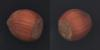
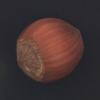
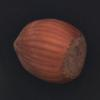
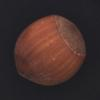
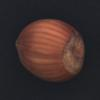
...
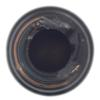
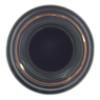
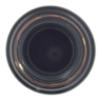
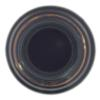
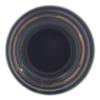

In [ ]:
#@title { vertical-output: true}

dataset = vqa_ano_detection_qwen(
    name="one_shot_qwen",
    dataset=dataset,
    prompt=one_shot_prompt_qwen,
    image_columns = ["reference_image_path", "test_image_path"]
)




In [ ]:
temp_file_path = data_root.parent / ("temp_qwenano_dataset_oneshot"+today+".csv")
# Save the DataFrame to a CSV file as a snapshot
pd.DataFrame(dataset).to_csv(temp_file_path, index=False)

### Experiment 3 Few-Shot

  0%|          | 0/163 [00:00<?, ?it/s]

0 broken_small Yes, there is a noticeable defect in the second image. The bottom of the bottle appears to be chipped or damaged, which is different from the first image where the bottom of the bottle is not visible.


  1%|          | 1/163 [00:09<25:46,  9.54s/it]

N/OK ANSWER: True.
1 broken_small There is a noticeable scratch on the surface of the second image, which is different from the first image where the bottle is clean and undamaged. This scratch indicates a defect in the product and may affect its appearance or functionality.


  1%|          | 2/163 [00:16<21:09,  7.88s/it]

N/OK ANSWER: True.
2 broken_small Yes, there is a noticeable defect in the second image. The top of the bottle is cracked, which is different from the first image where the top of the bottle is intact.


  2%|▏         | 3/163 [00:22<19:31,  7.32s/it]

N/OK ANSWER: True.
3 contamination There is a noticeable defect in the second image where the center of the bottle appears to be missing some material, creating a hollow space inside. This is different from the first image where the bottle appears to be complete and whole.


  2%|▏         | 4/163 [00:30<19:52,  7.50s/it]

N/OK ANSWER: True. There is a defect in the second image where the center of the bottle appears to be missing some material, creating a hollow space inside.
4 contamination There is a noticeable scratch on the surface of the second image, which is the bottom of the bottle. This scratch is not present in the first image, making it an anomaly or defect in the second image.


  3%|▎         | 5/163 [00:38<20:21,  7.73s/it]

N/OK ANSWER: True. There is a scratch on the bottom of the bottle in the second image, which is not present in the first image.
5 broken_large There is a noticeable scratch on the surface of the second image, which is different from the first image where the bottle is clean and undamaged. This scratch could be due to manufacturing defects, handling during transportation, or other factors that caused damage to the bottle's surface.


  4%|▎         | 6/163 [00:45<19:31,  7.46s/it]

N/OK ANSWER: True.
6 broken_large Yes, there is a noticeable defect in the second image. The top of the bottle appears to be chipped or damaged, which is different from the first image where the top of the bottle is clean and undamaged.


  4%|▍         | 7/163 [00:52<19:05,  7.34s/it]

N/OK ANSWER: True.
7 good There is a noticeable scratch on the surface of the second image, which is different from the first image where the bottle is clean and undamaged. This scratch could be due to manufacturing defects, handling during transportation, or other factors that caused damage to the glass bottle.


  5%|▍         | 8/163 [00:59<18:40,  7.23s/it]

N/OK ANSWER: True.
8 good There is a noticeable scratch on the surface of the second image, which is the bottom of the bottle. This defect is not present in the first image, making it an anomaly in the comparison.


  6%|▌         | 9/163 [01:07<19:09,  7.46s/it]

N/OK ANSWER: True. There is a scratch on the bottom of the bottle in the second image, which is not present in the first image.
9 faulty_imprint There is no existence of a second image in the provided information.


  6%|▌         | 10/163 [01:13<17:14,  6.76s/it]

N/OK ANSWER: False.
10 faulty_imprint There is no existence of any defects or anomalies in the second image.


  7%|▋         | 11/163 [01:18<16:07,  6.37s/it]

N/OK ANSWER: False.
11 faulty_imprint There is no existence of a second image in the provided information.


  7%|▋         | 12/163 [01:23<15:12,  6.04s/it]

N/OK ANSWER: False.
12 scratch There is no existence of a second image in the provided information.


  8%|▊         | 13/163 [01:28<14:27,  5.78s/it]

N/OK ANSWER: False.
13 scratch There is no existence of any defects or anomalies in the second image.


  9%|▊         | 14/163 [01:34<14:10,  5.71s/it]

N/OK ANSWER: False.
14 good There is no existence of a second image in the provided information.


  9%|▉         | 15/163 [01:39<13:42,  5.56s/it]

N/OK ANSWER: False.
15 good There is no existence of a second image in the provided information.


 10%|▉         | 16/163 [01:44<13:24,  5.47s/it]

N/OK ANSWER: False.
16 crack There is no existence of any defects or anomalies in the second image.


 10%|█         | 17/163 [01:50<13:30,  5.55s/it]

N/OK ANSWER: False.
17 crack There is no existence of a second image in the provided information.


 11%|█         | 18/163 [01:56<13:32,  5.60s/it]

N/OK ANSWER: False.
18 crack There is no existence of a second image in the provided information.


 12%|█▏        | 19/163 [02:01<13:21,  5.57s/it]

N/OK ANSWER: False.
19 poke There is no existence of any defects or anomalies in the second image.


 12%|█▏        | 20/163 [02:07<13:04,  5.49s/it]

N/OK ANSWER: False.
20 poke There is no existence of any defects or anomalies in the second image.


 13%|█▎        | 21/163 [02:12<12:48,  5.41s/it]

N/OK ANSWER: False.
21 squeeze There is no existence of any defects or anomalies in the second image.


 13%|█▎        | 22/163 [02:18<12:53,  5.48s/it]

N/OK ANSWER: False.
22 squeeze There is no existence of any defects or anomalies in the second image.


 14%|█▍        | 23/163 [02:23<12:44,  5.46s/it]

N/OK ANSWER: False.
23 cut There is no existence of any defects or anomalies in the second image.


 15%|█▍        | 24/163 [02:29<12:51,  5.55s/it]

N/OK ANSWER: False.
24 cut There is no existence of any defects or anomalies in the second image.


 15%|█▌        | 25/163 [02:35<12:57,  5.63s/it]

N/OK ANSWER: False.
25 metal_contamination There are no significant defects or anomalies in the second image compared to the first image. Both images show a close-up view of a woven gray fabric or textile material.


 16%|█▌        | 26/163 [02:42<14:04,  6.16s/it]

N/OK ANSWER: False. Both images show a close-up view of a woven gray fabric or textile material without any significant defects or anomalies.
26 metal_contamination There is a defect in the second image where a hole has been cut in the center of the woven material.


 17%|█▋        | 27/163 [02:48<13:57,  6.16s/it]

N/OK ANSWER: True.
27 good There are no significant defects or anomalies in the second image compared to the first image. Both images show a close-up view of a gray woven fabric with a basket weave pattern.


 17%|█▋        | 28/163 [02:56<15:01,  6.68s/it]

N/OK ANSWER: False. Both images show a close-up view of a gray woven fabric with a basket weave pattern, but there are no significant defects or anomalies that differentiate the two images.
28 good There are no significant defects or anomalies in the second image compared to the first image. Both images show a close-up view of a gray woven fabric, which appears to be made of a synthetic material.


 18%|█▊        | 29/163 [03:04<15:51,  7.10s/it]

N/OK ANSWER: False. There are no significant defects or anomalies in the second image compared to the first image.
29 good There are no significant defects or anomalies in the second image compared to the first image. Both images show a close-up view of a woven fabric texture, which appears to be made of a gray or dark-colored material.


 18%|█▊        | 30/163 [03:12<16:05,  7.26s/it]

N/OK ANSWER: False. There are no significant defects or anomalies in the second image compared to the first image.
30 hole There is no existence of any defects or anomalies in the second image.


 19%|█▉        | 31/163 [03:18<14:58,  6.81s/it]

N/OK ANSWER: False.
31 thread There is no existence of any defects or anomalies in the second image.


 20%|█▉        | 32/163 [03:23<13:50,  6.34s/it]

N/OK ANSWER: False.
32 thread There is a defect in the second image where a white square is visible on the dark background, which is not present in the first image.


 20%|██        | 33/163 [03:29<13:34,  6.27s/it]

N/OK ANSWER: False.
33 color There is no existence of any defects or anomalies in the second image.


 21%|██        | 34/163 [03:34<12:54,  6.00s/it]

N/OK ANSWER: False.
34 color There are no significant defects or anomalies in the second image compared to the first image. Both images show a close-up view of a woven fabric texture, which appears to be made of dark-colored threads or yarns.


 21%|██▏       | 35/163 [03:42<13:59,  6.56s/it]

N/OK ANSWER: False. There are no significant defects or anomalies in the second image compared to the first image.
35 glue Yes, there is a defect in the second image where the expanded metal mesh appears to be damaged or broken. This defect is not present in the first image, making it a distinguishable difference between the two.


 22%|██▏       | 36/163 [03:50<14:42,  6.95s/it]

N/OK ANSWER: True. There is a defect or anomaly in the second image where the expanded metal mesh appears to be damaged or broken.
36 glue Yes, there is a defect in the second image where the expanded metal mesh appears to be damaged or broken.


 23%|██▎       | 37/163 [03:57<14:28,  6.90s/it]

N/OK ANSWER: True. There are defects or anomalies in the third image where the expanded metal mesh appears to be damaged or broken.
37 thread There is a noticeable difference in the pattern between the first and second images. The second image appears to be a closer view of the mesh, focusing on the individual mesh cells, while the first image provides a more comprehensive view of the mesh pattern. This difference in perspective might create an impression of defects or anomalies in the second image that might not actually be present in the first image or the real object.


 23%|██▎       | 38/163 [04:07<16:27,  7.90s/it]

N/OK ANSWER: False. The second image provides a close-up view of the mesh pattern, which might create an impression of defects or anomalies, but there are no visible defects or anomalies in the image.
38 bent Yes, there are some defects in the second image. The pattern is not as consistent and clean as the first image, which is a close-up of the metal grid.


 24%|██▍       | 39/163 [04:14<15:31,  7.51s/it]

N/OK ANSWER: True.
39 broken Yes, there is a defect in the second image where the expanded metal mesh appears to be damaged or broken. This defect is not present in the first image, making it a distinguishable difference between the two.


 25%|██▍       | 40/163 [04:21<15:25,  7.52s/it]

N/OK ANSWER: True. There is a defect or anomaly in the second image where the expanded metal mesh appears to be damaged or broken.
40 metal_contamination There are no significant differences or defects in the second image when compared to the first image. Both images display a pattern made up of interwoven loops, which could be interpreted as a mesh or net.


 25%|██▌       | 41/163 [04:28<14:54,  7.33s/it]

N/OK ANSWER: False.
41 good Yes, there are some defects in the second image when compared to the first image. The texture in the second image appears to be less detailed and more blurry, while the first image has a higher resolution and more intricate details. Additionally, the second image has a lighter background, which makes the texture stand out more, while the first image has a darker background that blends the texture better with the surroundings.


 26%|██▌       | 42/163 [04:37<15:53,  7.88s/it]

N/OK ANSWER: True. There are some defects or anomalies in the second image when compared to the first image.
42 good There are no significant defects or anomalies in the second image when compared to the first one. Both images show a metal mesh pattern, which appears to be a metal grill or expanded metal sheet. The focus is on the same area, and the lighting conditions seem to be similar. Therefore, the second image can be considered a duplicate or a close-up view of the same object shown in the first image.


 26%|██▋       | 43/163 [04:48<17:30,  8.76s/it]

N/OK ANSWER: False. The second image is a duplicate or a close-up view of the same object shown in the first image, and there are no significant defects or anomalies that can be observed.
43 print There is a noticeable crack in the second image, which is different from the first image where the hazelnut is whole.


 27%|██▋       | 44/163 [04:54<15:40,  7.90s/it]

N/OK ANSWER: False.
44 print There is a small irregularity on the surface of the榛果 in the second image, which is not present in the first image. This difference in appearance may suggest a slight defect or variation in the榛果.


 28%|██▊       | 45/163 [05:02<15:40,  7.97s/it]

N/OK ANSWER: False. The榛果 in both images appear to be in good condition without any visible defects or anomalies.
45 good There is a small scar on the second image, which is not present in the first image.


 28%|██▊       | 46/163 [05:08<14:09,  7.26s/it]

N/OK ANSWER: False.
46 good There is a small crack on the side of the second榛子 image, which is a noticeable defect compared to the first image where the榛子 is whole and undamaged.


 29%|██▉       | 47/163 [05:15<14:17,  7.39s/it]

N/OK ANSWER: False. Both images show a single榛子 with no visible defects or anomalies.
47 good There is a noticeable defect in the second image, where one half of the榛子 appears to be damaged or missing. This defect is not present in the first image, making it a distinguishable difference.


 29%|██▉       | 48/163 [05:23<14:34,  7.61s/it]

N/OK ANSWER: True. There is a noticeable defect in the second image, where one half of the榛子 appears to be damaged or missing.
48 good There is a noticeable defect in the second image, where one side of the榛果 has a cracked shell. This is different from the first image, where the榛果 has a smooth shell.


 30%|███       | 49/163 [05:31<14:38,  7.71s/it]

N/OK ANSWER: True. The second image has a noticeable defect, with one side of the榛果 having a cracked shell.
49 crack There is a noticeable crack in the second image, which is different from the first image where the hazelnut is whole.


 31%|███       | 50/163 [05:37<13:29,  7.16s/it]

N/OK ANSWER: False.
50 crack There is a noticeable defect in the second image, where one side of the榛果 has a split shell. This is different from the first image, where the榛果 has a smooth and intact shell.


 31%|███▏      | 51/163 [05:45<13:25,  7.19s/it]

N/OK ANSWER: True.
51 cut There is a noticeable defect in the second image, where one of the榛子's shells appears to be damaged. This defect is not present in the first image, where the榛子 is presented in a perfect condition.


 32%|███▏      | 52/163 [05:51<13:01,  7.04s/it]

N/OK ANSWER: True.
52 cut There is a noticeable defect in the second image, where one of the榛子's shells appears to be damaged or cracked. This defect is not present in the first image, where the榛子 is presented in a whole and intact form.


 33%|███▎      | 53/163 [05:59<13:10,  7.18s/it]

N/OK ANSWER: True.
53 hole There is a noticeable defect in the second image, where one side of the榛果 has been damaged or cracked. This defect is not present in the first image, where the榛果 is whole and undamaged.


 33%|███▎      | 54/163 [06:07<13:34,  7.47s/it]

N/OK ANSWER: True. There is a noticeable defect in the second image, where one side of the榛果 has been damaged or cracked.
54 color There is a noticeable defect in the second image, where some of the leather texture appears to be missing, creating an uneven surface. This defect is not present in the first image, where the leather texture is consistent and uniform.


 34%|███▎      | 55/163 [06:14<13:17,  7.39s/it]

N/OK ANSWER: True.
55 color There is a defect in the second image, which is a missing area of the leather texture.


 34%|███▍      | 56/163 [06:20<12:14,  6.86s/it]

N/OK ANSWER: False.
56 cut There is a defect in the second image, which is a missing area where the leather should be present.


 35%|███▍      | 57/163 [06:26<11:42,  6.63s/it]

N/OK ANSWER: True.
57 cut There is a defect in the second image, which is a missing area where the leather should be present.


 36%|███▌      | 58/163 [06:31<11:05,  6.34s/it]

N/OK ANSWER: True.
58 glue There is a noticeable defect in the second image, where a large wrinkle is visible in the otherwise smooth leather texture. This defect stands out against the uniform and smooth texture of the first image.


 36%|███▌      | 59/163 [06:38<11:16,  6.50s/it]

N/OK ANSWER: True.
59 glue There is a noticeable defect in the second image, where some parts appear to be darker than others. This could be due to a lower quality or damaged leather material, or it could be a result of the lighting or angle used during the photo shoot.


 37%|███▋      | 60/163 [06:45<11:27,  6.67s/it]

N/OK ANSWER: True.
60 good There is a defect in the second image, which is a small white spot on the leather surface.


 37%|███▋      | 61/163 [06:51<10:45,  6.33s/it]

N/OK ANSWER: True.
61 good There are no significant defects or anomalies in the second image compared to the first image. Both images show a brown leather texture background, which is a close-up view of the surface.


 38%|███▊      | 62/163 [06:58<11:15,  6.69s/it]

N/OK ANSWER: False. Both images show a brown leather texture background, which is a close-up view of the surface.
62 good There are no significant defects or anomalies in the second image compared to the first image. Both images show a close-up view of a brown leather texture, which is a common material used in furniture and automotive industries.


 39%|███▊      | 63/163 [07:07<11:54,  7.15s/it]

N/OK ANSWER: False. Both images show a brown leather texture, but the second image is a higher resolution and more detailed view of the same material.
63 poke There is a defect in the second image, which is a small white spot on the brown leather texture.


 39%|███▉      | 64/163 [07:12<11:05,  6.72s/it]

N/OK ANSWER: True.
64 poke There is a noticeable defect in the second image, where the color of the leather appears to be darker and less consistent than in the first image. This could be due to a difference in lighting or camera settings, or it could be a genuine defect in the leather material.


 40%|███▉      | 65/163 [07:21<12:03,  7.39s/it]

N/OK ANSWER: True. There is a noticeable defect in the second image, where the color of the leather appears to be darker and less consistent than in the first image.
65 fold There is a defect in the second image, which is a missing area where the leather should be present.


 40%|████      | 66/163 [07:27<11:08,  6.89s/it]

N/OK ANSWER: True.
66 fold There is a noticeable defect in the second image, where some parts appear to be lighter than others. This defect is not present in the first image, which is a seamless representation of the brown leather texture.


 41%|████      | 67/163 [07:35<11:23,  7.12s/it]

N/OK ANSWER: True. There is a defect in the second image where some parts appear lighter than others.
67 good There is no existence of a second image in the provided information.


 42%|████▏     | 68/163 [07:40<10:26,  6.60s/it]

N/OK ANSWER: False.
68 good There is no existence of a black background in the second image description.


 42%|████▏     | 69/163 [07:45<09:35,  6.13s/it]

N/OK ANSWER: False.
69 good There is no existence of a second image in the provided information.


 43%|████▎     | 70/163 [07:50<09:08,  5.89s/it]

N/OK ANSWER: False.
70 scratch There is no existence of a black background in the second image description.


 44%|████▎     | 71/163 [07:56<08:40,  5.65s/it]

N/OK ANSWER: False.
71 scratch There is no existence of a black background in the second image description.


 44%|████▍     | 72/163 [08:01<08:18,  5.48s/it]

N/OK ANSWER: False.
72 bent There is no existence of any anomalies or defects in the second image.


 45%|████▍     | 73/163 [08:06<08:08,  5.43s/it]

N/OK ANSWER: False.
73 bent There is no existence of any anomalies or defects in the second image.


 45%|████▌     | 74/163 [08:11<07:55,  5.34s/it]

N/OK ANSWER: False.
74 color There is no existence of any anomalies or defects in the second image.


 46%|████▌     | 75/163 [08:16<07:41,  5.25s/it]

N/OK ANSWER: False.
75 color There is no existence of a black background in the second image description.


 47%|████▋     | 76/163 [08:22<07:40,  5.29s/it]

N/OK ANSWER: False.
76 color There is no existence of a second image in the provided information.


 47%|████▋     | 77/163 [08:27<07:29,  5.23s/it]

N/OK ANSWER: False.
77 flip There is no existence of a black background in the second image description.


 48%|████▊     | 78/163 [08:32<07:20,  5.18s/it]

N/OK ANSWER: False.
78 flip There is no existence of a second image in the provided information.


 48%|████▊     | 79/163 [08:37<07:20,  5.25s/it]

N/OK ANSWER: False.
79 contamination There is no existence of any defects or anomalies in the second image.


 49%|████▉     | 80/163 [08:42<07:11,  5.20s/it]

N/OK ANSWER: False.
80 contamination There is no existence of any defects or anomalies in the second image.


 50%|████▉     | 81/163 [08:47<07:05,  5.19s/it]

N/OK ANSWER: False.
81 contamination There is no existence of any defects or anomalies in the second image.


 50%|█████     | 82/163 [08:53<07:07,  5.28s/it]

N/OK ANSWER: False.
82 good There is no existence of any defects or anomalies in the second image.


 51%|█████     | 83/163 [08:58<06:57,  5.22s/it]

N/OK ANSWER: False.
83 good There is no existence of any defects or anomalies in the second image.


 52%|█████▏    | 84/163 [09:03<06:52,  5.22s/it]

N/OK ANSWER: False.
84 color There is no existence of any defects or anomalies in the second image.


 52%|█████▏    | 85/163 [09:08<06:47,  5.22s/it]

N/OK ANSWER: False.
85 color There is no existence of any defects or anomalies in the second image.


 53%|█████▎    | 86/163 [09:13<06:39,  5.19s/it]

N/OK ANSWER: False.
86 color There is a small defect in the second image where the center of the oval pill is slightly dented.


 53%|█████▎    | 87/163 [09:19<06:50,  5.40s/it]

N/OK ANSWER: True.
87 pill_type There is no existence of any defects or anomalies in the second image.


 54%|█████▍    | 88/163 [09:25<06:40,  5.35s/it]

N/OK ANSWER: False.
88 scratch There is no existence of any defects or anomalies in the second image.


 55%|█████▍    | 89/163 [09:30<06:30,  5.28s/it]

N/OK ANSWER: False.
89 scratch There is no existence of any defects or anomalies in the second image.


 55%|█████▌    | 90/163 [09:35<06:26,  5.30s/it]

N/OK ANSWER: False.
90 combined There is no existence of any defects or anomalies in the second image.


 56%|█████▌    | 91/163 [09:40<06:17,  5.24s/it]

N/OK ANSWER: False.
91 combined There is no existence of any defects or anomalies in the second image.


 56%|█████▋    | 92/163 [09:45<06:10,  5.21s/it]

N/OK ANSWER: False.
92 faulty_imprint There is no existence of any defects or anomalies in the second image.


 57%|█████▋    | 93/163 [09:51<06:09,  5.28s/it]

N/OK ANSWER: False.
93 faulty_imprint There is no existence of any defects or anomalies in the second image.


 58%|█████▊    | 94/163 [09:56<06:00,  5.23s/it]

N/OK ANSWER: False.
94 crack There is no existence of any defects or anomalies in the second image.


 58%|█████▊    | 95/163 [10:01<05:54,  5.22s/it]

N/OK ANSWER: False.
95 crack There is no existence of any defects or anomalies in the second image.


 59%|█████▉    | 96/163 [10:06<05:51,  5.25s/it]

N/OK ANSWER: False.
96 scratch_head There is a noticeable defect in the second image, where the screw appears to be damaged or broken. This defect is not present in the first image, where the screw is whole and undamaged.


 60%|█████▉    | 97/163 [10:14<06:27,  5.87s/it]

N/OK ANSWER: True. There is a noticeable defect in the second image, where the screw appears to be damaged or broken.
97 scratch_head There is a noticeable defect in the second image, where the screw appears to be damaged or broken. This defect is not present in the first image, which shows a complete and whole screw.


 60%|██████    | 98/163 [10:22<07:00,  6.47s/it]

N/OK ANSWER: True. There is a noticeable defect in the second image, where the screw appears to be damaged or broken.
98 scratch_head There is a noticeable defect in the second image, where the screw appears to be damaged or broken. This defect is not present in the first image, where the screw is whole and undamaged.


 61%|██████    | 99/163 [10:29<07:16,  6.81s/it]

N/OK ANSWER: True. There is a noticeable defect in the second image, where the screw appears to be damaged or broken.
99 good There is a noticeable defect in the second image, where the screw appears to be damaged or broken. This defect is not present in the first image, where the screw is whole and undamaged.


 61%|██████▏   | 100/163 [10:37<07:26,  7.08s/it]

N/OK ANSWER: True. There is a noticeable defect in the second image, where the screw appears to be damaged or broken.
100 good There is a noticeable defect in the second image, where the screw appears to be damaged or broken. This defect is not present in the first image, where the screw is whole and undamaged.


 62%|██████▏   | 101/163 [10:45<07:30,  7.26s/it]

N/OK ANSWER: True. There is a noticeable defect in the second image, where the screw appears to be damaged or broken.
101 good There is a noticeable defect in the second image, where the screw appears to be missing its head. This defect is not present in the first image, making it a distinguishable difference between the two.


 63%|██████▎   | 102/163 [10:52<07:27,  7.34s/it]

N/OK ANSWER: True. There is a noticeable defect in the second image, where the screw appears to be missing its head.
102 good There is a noticeable defect in the second image, where the screw appears to be damaged or broken. This defect is not present in the first image, where the screw is whole and undamaged.


 63%|██████▎   | 103/163 [11:00<07:26,  7.44s/it]

N/OK ANSWER: True. There is a noticeable defect in the second image, where the screw appears to be damaged or broken.
103 manipulated_front There is a noticeable defect in the second image, where the screw appears to be damaged or broken. This defect is not present in the first image, which shows a complete and functional screw.


 64%|██████▍   | 104/163 [11:07<07:15,  7.39s/it]

N/OK ANSWER: True. There is a noticeable defect in the second image, where the screw appears to be damaged or broken.
104 manipulated_front There are no significant anomalies or defects in the second image. Both pictures show a typical screw with a hexagonal head and a Phillips drive. The only difference is the lighting and background, making the second image appear older or more worn.


 64%|██████▍   | 105/163 [11:14<06:58,  7.22s/it]

N/OK ANSWER: False.
105 thread_top There is a noticeable defect in the second image, where the screw appears to be damaged or broken. This defect is not present in the first image, where the screw is whole and undamaged.


 65%|██████▌   | 106/163 [11:21<06:56,  7.31s/it]

N/OK ANSWER: True. There is a noticeable defect in the second image, where the screw appears to be damaged or broken.
106 thread_top Upon careful examination of the second image, there appears to be a slight variation in the screw's head, which might be considered an anomaly. The screw's head seems to be slightly dented, which is not a common feature for a screw. However, this anomaly might not be significant enough to warrant concern in most applications.


 66%|██████▌   | 107/163 [11:29<06:58,  7.48s/it]

N/OK ANSWER: False.
107 thread_top There is a noticeable defect in the second image, where the screw appears to be damaged or broken. This defect is not present in the first image, where the screw is whole and undamaged.


 66%|██████▋   | 108/163 [11:37<06:49,  7.45s/it]

N/OK ANSWER: True. There is a noticeable defect in the second image, where the screw appears to be damaged or broken.
108 thread_side There is a noticeable defect in the second image, where the screw appears to be damaged or broken. This defect is not present in the first image, where the screw is whole and undamaged.


 67%|██████▋   | 109/163 [11:44<06:45,  7.51s/it]

N/OK ANSWER: True. There is a noticeable defect in the second image, where the screw appears to be damaged or broken.
109 thread_side There is a noticeable defect in the second image, where the screw appears to be damaged or broken. This defect is not present in the first image, where the screw is whole and undamaged.


 67%|██████▋   | 110/163 [11:52<06:36,  7.47s/it]

N/OK ANSWER: True. There is a noticeable defect in the second image, where the screw appears to be damaged or broken.
110 scratch_neck There is a noticeable defect in the second image, where the screw appears to be damaged or broken. This defect is not present in the first image, where the screw is whole and undamaged.


 68%|██████▊   | 111/163 [11:59<06:32,  7.55s/it]

N/OK ANSWER: True. There is a noticeable defect in the second image, where the screw appears to be damaged or broken.
111 scratch_neck There is a noticeable defect in the second image, where the screw appears to be damaged or broken. This defect is not present in the first image, where the screw is whole and undamaged.


 69%|██████▊   | 112/163 [12:07<06:22,  7.49s/it]

N/OK ANSWER: True. There is a noticeable defect in the second image, where the screw appears to be damaged or broken.
112 oil There are no significant differences or anomalies in the second image when compared to the first image. Both images show a close-up view of a surface with a spotted texture, which appears to be a rough, uneven finish. The only difference is the color, with the second image being darker in tone.


 69%|██████▉   | 113/163 [12:16<06:47,  8.15s/it]

N/OK ANSWER: False. There are no significant defects or anomalies in the second image when compared to the first image. Both images show a surface with a spotted texture, but the color is different.
113 oil There are no significant differences or anomalies in the second image when compared to the first image. Both images show a close-up view of a surface with a spotted texture, which appears to be a rough, uneven finish.


 70%|██████▉   | 114/163 [12:24<06:29,  7.95s/it]

N/OK ANSWER: False. There are no defects or anomalies in the second image when compared to the first image.
114 rough There are no significant differences between the first and second images. Both pictures show a close-up view of a surface with a spotted texture.


 71%|███████   | 115/163 [12:31<06:15,  7.82s/it]

N/OK ANSWER: False. Both images show a surface with a spotted texture, but there are no significant defects or anomalies that can be observed.
115 rough There is a noticeable defect in the second image, which is the lack of uniformity in the gray and black speckled pattern. The background appears to be lighter and more uniform than the foreground, creating an uneven appearance. This defect can be attributed to the uneven distribution of paint or the use of a different color scheme.


 71%|███████   | 116/163 [12:41<06:31,  8.33s/it]

N/OK ANSWER: True. There is a noticeable defect in the second image, which is the lack of uniformity in the gray and black speckled pattern.
116 crack Yes, there is a defect in the second image. A defect, which appears as a dark spot, is visible on the surface of the material. This defect might be a result of an irregularity in the manufacturing process or due to damage during handling.


 72%|███████▏  | 117/163 [12:49<06:20,  8.28s/it]

N/OK ANSWER: True. There is a defect in the second image, which is a dark spot on the surface of the material.
117 good There is a defect in the second image where some of the speckles are missing, making it appear as if the surface is not as uniform as the first image.


 72%|███████▏  | 118/163 [12:57<06:12,  8.28s/it]

N/OK ANSWER: True. There are defects or anomalies in the second image where some of the speckles are missing, making it appear as if the surface is not as uniform as the first image.
118 good There is a defect in the second image where some of the cells appear to be missing or damaged, which is different from the uniform and intact cells in the first image.


 73%|███████▎  | 119/163 [13:04<05:36,  7.65s/it]

N/OK ANSWER: True.
119 good There are no significant differences or anomalies in the first and second images. Both pictures show a close-up view of a speckled surface, which appears to be a rough, uneven texture.


 74%|███████▎  | 120/163 [13:11<05:21,  7.48s/it]

N/OK ANSWER: False. There are no significant defects or anomalies in the image.
120 good There is a defect in the second image where the surface appears to be damaged or scratched, creating a contrast with the rest of the smooth, uniform surface.


 74%|███████▍  | 121/163 [13:17<04:57,  7.09s/it]

N/OK ANSWER: True.
121 gray_stroke There is a noticeable defect in the second image, which is a missing area near the center of the image. This defect is not present in the first image.


 75%|███████▍  | 122/163 [13:24<04:55,  7.22s/it]

N/OK ANSWER: True. There is a noticeable defect in the second image, which is a missing area near the center of the image.
122 glue_strip There is a defect in the second image where the surface appears to be damaged or scratched, creating a contrast with the rest of the image.


 75%|███████▌  | 123/163 [13:30<04:35,  6.89s/it]

N/OK ANSWER: False.
123 glue_strip There are no significant anomalies or defects in the second image when compared to the first image. Both images show a gray and black speckled surface, which could be a granite or marble texture.


 76%|███████▌  | 124/163 [13:38<04:39,  7.17s/it]

N/OK ANSWER: False. Both images show the same gray and black speckled surface, which could be a granite or marble texture.
124 good There is a noticeable defect in the second image where the bristles on the toothbrush appear to be damaged or worn out, which is different from the first image where the toothbrush appears to be brand new.


 77%|███████▋  | 125/163 [13:45<04:30,  7.12s/it]

N/OK ANSWER: True.
125 good There is no existence of a second image in the image information provided.


 77%|███████▋  | 126/163 [13:51<04:02,  6.56s/it]

N/OK ANSWER: False.
126 defective There is no existence of a second image in the image information provided.


 78%|███████▊  | 127/163 [13:56<03:46,  6.29s/it]

N/OK ANSWER: False.
127 defective There is no existence of a second image in the image information.


 79%|███████▊  | 128/163 [14:02<03:29,  6.00s/it]

N/OK ANSWER: False.
128 defective There is no existence of a second image in the image information provided.


 79%|███████▉  | 129/163 [14:07<03:16,  5.79s/it]

N/OK ANSWER: False.
129 misplaced There is no existence of any defects or anomalies in the second image.


 80%|███████▉  | 130/163 [14:13<03:10,  5.77s/it]

N/OK ANSWER: False.
130 cut_lead There is a noticeable defect in the second image where the top right corner of the electronic component appears to be missing. This defect is not present in the first image, making it an anomaly.


 80%|████████  | 131/163 [14:20<03:21,  6.29s/it]

N/OK ANSWER: True. There is a noticeable defect in the second image where the top right corner of the electronic component appears to be missing.
131 damaged_case There is a noticeable defect in the second image where the copper has been damaged, causing a hole to form. This defect is not present in the first image, making it an anomaly.


 81%|████████  | 132/163 [14:28<03:33,  6.88s/it]

N/OK ANSWER: True. There is a noticeable defect in the second image where the copper has been damaged, causing a hole to form.
132 good There is no existence of any defects or anomalies in the second image.


 82%|████████▏ | 133/163 [14:34<03:12,  6.42s/it]

N/OK ANSWER: False.
133 good There is no existence of any defects or anomalies in the second image.


 82%|████████▏ | 134/163 [14:39<03:00,  6.21s/it]

N/OK ANSWER: False.
134 good There is a noticeable defect in the second image where one of the copper squares is missing. This defect is not present in the first image, making it an anomaly.


 83%|████████▎ | 135/163 [14:47<03:02,  6.52s/it]

N/OK ANSWER: True. There is a noticeable defect in the second image where one of the copper squares is missing.
135 good There is no existence of any defects or anomalies in the second image.


 83%|████████▎ | 136/163 [14:52<02:48,  6.23s/it]

N/OK ANSWER: False.
136 good There is no existence of any defects or anomalies in the second image.


 84%|████████▍ | 137/163 [14:59<02:46,  6.39s/it]

N/OK ANSWER: False.
137 good There is no existence of any defects or anomalies in the second image.


 85%|████████▍ | 138/163 [15:04<02:33,  6.12s/it]

N/OK ANSWER: False.
138 bent_lead There is no existence of any defects or anomalies in the second image.


 85%|████████▌ | 139/163 [15:10<02:23,  5.98s/it]

N/OK ANSWER: False.
139 good There is a defect in the second image, which is a dark line running horizontally across the wood grain.


 86%|████████▌ | 140/163 [15:17<02:22,  6.19s/it]

N/OK ANSWER: True. There is a defect in the second image, which is a dark line running horizontally across the wood grain.
140 good There are no defects or anomalies in the second image, which shows a close-up view of the wood grain.


 87%|████████▋ | 141/163 [15:23<02:14,  6.12s/it]

N/OK ANSWER: False.
141 liquid There is a defect in the second image, which is a dark spot on the wood grain. This defect is not present in the first image.


 87%|████████▋ | 142/163 [15:30<02:13,  6.37s/it]

N/OK ANSWER: True. There is a defect in the wood grain in the second image.
142 scratch There is a defect in the second image, which is a dark spot on the wooden surface. This defect stands out against the lighter-colored wooden background.


 88%|████████▊ | 143/163 [15:37<02:11,  6.55s/it]

N/OK ANSWER: True. There is a defect on the wooden surface in the second image.
143 scratch There is a defect in the second image, which is a dark spot on the wood grain.


 88%|████████▊ | 144/163 [15:43<02:03,  6.52s/it]

N/OK ANSWER: True. There is a defect in the wood grain of the second image.
144 hole There is a defect in the second image, which is a dark line running horizontally across the center of the wood grain. This defect is not present in the first image, making it an anomaly.


 89%|████████▉ | 145/163 [15:51<02:05,  6.99s/it]

N/OK ANSWER: True. There is a defect in the second image, which is a dark line running horizontally across the center of the wood grain.
145 combined There is a defect in the second image, which is a dark line running horizontally across the center of the wood grain. This defect is not present in the first image.


 90%|████████▉ | 146/163 [15:59<02:01,  7.14s/it]

N/OK ANSWER: True. There is a defect in the second image, which is a dark line running horizontally across the center of the wood grain.
146 combined Yes, there is a defect in the second image where the wood appears to be cracked or damaged.


 90%|█████████ | 147/163 [16:05<01:52,  7.01s/it]

N/OK ANSWER: True. There are defects or anomalies in the second image, such as the crack in the wood.
147 broken_teeth There is a noticeable defect in the second image, where the zipper is not fully closed and has a gap in the middle. This defect is not present in the first image, making it a more accurate representation of the product.


 91%|█████████ | 148/163 [16:12<01:44,  6.98s/it]

N/OK ANSWER: True.
148 broken_teeth There is a noticeable defect in the second image, where the zipper is not fully closed and is partially opened, making it different from the first image where the zipper is fully closed.


 91%|█████████▏| 149/163 [16:18<01:34,  6.74s/it]

N/OK ANSWER: True.
149 good There is no existence of a second image in the image information.


 92%|█████████▏| 150/163 [16:24<01:24,  6.52s/it]

N/OK ANSWER: False. There is no existence of a second image in the image information.
150 good There is a noticeable defect in the second image where the zipper is not fully closed, revealing the black fabric underneath. This defect is not present in the first image, making it a more accurate representation of the product.


 93%|█████████▎| 151/163 [16:31<01:18,  6.54s/it]

N/OK ANSWER: True.
151 good There is a noticeable defect in the second image, where the zipper is not fully closed and has a gap in the middle. This defect is not present in the first image, making it a more accurate representation of a complete and closed zipper.


 93%|█████████▎| 152/163 [16:39<01:14,  6.82s/it]

N/OK ANSWER: True.
152 good There is a noticeable defect in the second image where the zipper is not fully closed, revealing the black fabric underneath. This defect is not present in the first image, making it a more accurate representation of the zipper.


 94%|█████████▍| 153/163 [16:45<01:07,  6.74s/it]

N/OK ANSWER: True.
153 split_teeth There is a noticeable defect in the second image where the zipper is not fully closed, revealing the black fabric underneath. This defect is not present in the first image, making it a more accurate representation of the zipper.


 94%|█████████▍| 154/163 [16:52<01:01,  6.88s/it]

N/OK ANSWER: True.
154 combined There is a noticeable defect in the second image, where the zipper is not fully closed and has a gap in the middle. This defect is not present in the first image, making it a more accurate representation of a complete and closed zipper.


 95%|█████████▌| 155/163 [16:59<00:54,  6.82s/it]

N/OK ANSWER: True.
155 combined There is a noticeable defect in the second image where the zipper is not fully closed, revealing the black fabric underneath. This defect is not present in the first image, making it a more accurate representation of the product.


 96%|█████████▌| 156/163 [17:06<00:48,  6.92s/it]

N/OK ANSWER: True.
156 fabric_border There is a noticeable defect in the second image, where the zipper is not fully closed and has a gap in the middle. This defect is not present in the first image, making it a more accurate representation of the product.


 96%|█████████▋| 157/163 [17:13<00:41,  6.84s/it]

N/OK ANSWER: True.
157 fabric_border There is a noticeable defect in the second image where the zipper is supposed to be closed but is open instead. This defect makes the image less accurate in terms of representing a closed zipper.


 97%|█████████▋| 158/163 [17:19<00:33,  6.78s/it]

N/OK ANSWER: True.
158 squeezed_teeth There is a noticeable defect in the second image where the zipper is not fully closed, revealing the black fabric underneath. This defect is not present in the first image, making it a more accurate representation of the zipper.


 98%|█████████▊| 159/163 [17:27<00:28,  7.06s/it]

N/OK ANSWER: True. There is a noticeable defect in the second image where the zipper is not fully closed, revealing the black fabric underneath.
159 rough There is a noticeable defect in the second image where the zipper is not fully closed, revealing the black fabric underneath. This defect is not present in the first image, making it a more accurate representation of the product.


 98%|█████████▊| 160/163 [17:34<00:21,  7.02s/it]

N/OK ANSWER: True.
160 rough There is a noticeable defect in the second image where the zipper is not fully closed, revealing the black fabric underneath. This defect is not present in the first image, making it a more accurate representation of the zipper.


 99%|█████████▉| 161/163 [17:41<00:13,  6.92s/it]

N/OK ANSWER: True.
161 fabric_interior There is a noticeable defect in the second image where the zipper is not fully closed, revealing the black fabric underneath. This defect is not present in the first image, making it a more accurate representation of the product.


 99%|█████████▉| 162/163 [17:47<00:06,  6.82s/it]

N/OK ANSWER: True.
162 fabric_interior There is a noticeable defect in the second image where the zipper is not fully closed, revealing the black fabric underneath. This defect is not present in the first image, making it a more accurate representation of the zipper.


100%|██████████| 163/163 [17:55<00:00,  6.60s/it]

N/OK ANSWER: True. There is a noticeable defect in the second image where the zipper is not fully closed, revealing the black fabric underneath.
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 163 entries, 0 to 162
Data columns (total 37 columns):
 #   Column                        Non-Null Count  Dtype 
---  ------                        --------------  ----- 
 0   stacked_image                 163 non-null    object
 1   image                         163 non-null    object
 2   reference                     163 non-null    object
 3   reference2                    163 non-null    object
 4   reference3                    163 non-null    object
 5   reference4                    163 non-null    object
 6   label                         163 non-null    object
 7   label_name                    163 non-null    object
 8   class                         163 non-null    object
 9   file_name                     163 non-null    object
 10  reference_file_name           163 non-null    obj

None

,stacked_image,image,reference,reference2,reference3,reference4,label,label_name,class,file_name,reference_file_name,reference_file_name2,reference_file_name3,reference_file_name4,stacked_pil_image,pil_image,pil_reference,pil_reference2,pil_reference3,pil_reference4,test_image_path,reference_image_path,reference_image_path2,reference_image_path3,reference_image_path4,one_shot_qwen_prompt,one_shot_qwen_plain_prompt,one_shot_qwen_response,one_shot_qwen_plain_response,one_shot_qwen_prediction,one_shot_qwen_date,few_shot_qwen_prompt,few_shot_qwen_plain_prompt,few_shot_qwen_response,few_shot_qwen_plain_response,few_shot_qwen_prediction,few_shot_qwen_date
29,,,,,,,OK,good,carpet,024.png,186.png,190.png,204.png,176.png,,,,,,,/content/drive/MyDrive/Data/mvtec/carpet/test/good/024.png,/content/drive/MyDrive/Data/mvtec_train/carpet/train/good/186.png,/content/drive/MyDrive/Data/mvtec_train/carpet/train/good/190.png,/content/drive/MyDrive/Data/mvtec_train/carpet/train/good/204.png,/content/drive/MyDrive/Data/mvtec_train/carpet/train/good/176.png,"\nWhen compared to the first image, are there any anomlies or defects in the second image?\n [ANSWER] Are there defects or anomalies? Answer ""True"" or ""False"". Answer:","[{'text': 'First image:'}, {'image': '/content/drive/MyDrive/Data/mvtec_train/carpet/train/good/186.png'}, {'text': 'Second image:'}, {'image': '/content/drive/MyDrive/Data/mvtec/carpet/test/good/024.png'}, {'text': ' When compared to the first image, are there any anomlies or defects in the second image? '}]","False. Both images show a close-up view of a woven fabric texture, which appears to be made of dark-colored threads or yarns. The fabric has a pattern of interwoven threads, creating a textured surface.","False. Both images show a close-up view of a woven fabric texture, which appears to be made of dark-colored threads or yarns. The fabric has a pattern of interwoven threads, creating a textured surface.",OK,2024-01-16,"\nWhen compared to the first image, are there any anomlies or defects in the second image?\n [ANSWER] Are there defects or anomalies? Answer ""True"" or ""False"". Answer:","[{'text': 'First image:'}, {'image': '/content/drive/MyDrive/Data/mvtec_train/carpet/train/good/186.png'}, {'text': 'Second image:'}, {'image': '/content/drive/MyDrive/Data/mvtec_train/carpet/train/good/190.png'}, {'text': 'Third image'}, {'image': '/content/drive/MyDrive/Data/mvtec_train/carpet/train/good/204.png'}, {'text': 'Last image'}, {'image': '/content/drive/MyDrive/Data/mvtec/carpet/test/good/024.png'}, {'text': ' When compared to the first image, are there any anomlies or defects in the second image? '}]",False. There are no significant defects or anomalies in the second image compared to the first image.,False. There are no significant defects or anomalies in the second image compared to the first image.,OK,2024-01-16
48,,,,,,,OK,good,hazelnut,030.png,049.png,188.png,102.png,345.png,,,,,,,/content/drive/MyDrive/Data/mvtec/hazelnut/test/good/030.png,/content/drive/MyDrive/Data/mvtec_train/hazelnut/train/good/049.png,/content/drive/MyDrive/Data/mvtec_train/hazelnut/train/good/188.png,/content/drive/MyDrive/Data/mvtec_train/hazelnut/train/good/102.png,/content/drive/MyDrive/Data/mvtec_train/hazelnut/train/good/345.png,"\nWhen compared to the first image, are there any anomlies or defects in the second image?\n [ANSWER] Are there defects or anomalies? Answer ""True"" or ""False"". Answer:","[{'text': 'First image:'}, {'image': '/content/drive/MyDrive/Data/mvtec_train/hazelnut/train/good/049.png'}, {'text': 'Second image:'}, {'image': '/content/drive/MyDrive/Data/mvtec/hazelnut/test/good/030.png'}, {'text': ' When compared to the first image, are there any anomlies or defects in the second image? '}]","True. There is a noticeable defect in the second image where one side of the榛子 has been partially removed or chewed on, while the other side remains intact.","True. There is a noticeable defect in the second image where one sid
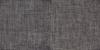
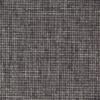
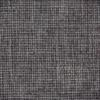
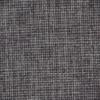
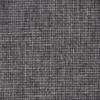
...
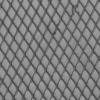
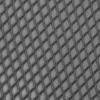
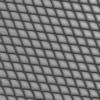
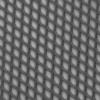
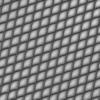

In [ ]:
#@title { vertical-output: true}
dataset = vqa_ano_detection_qwen(
    name="few_shot_qwen",
    dataset=dataset,
    prompt=one_shot_prompt_qwen,
    image_columns = [
        "reference_image_path",
        "reference_image_path2",
        "reference_image_path3",
        "test_image_path"
    ]
)

In [ ]:
temp_file_path = data_root.parent / ("temp_qwenano_dataset_fewshot"+today+".csv")
# Save the DataFrame to a CSV file as a snapshot
pd.DataFrame(dataset).to_csv(temp_file_path, index=False)

In [ ]:
import torch
import gc

model.cpu()
del model
del tokenizer
gc.collect()
torch.cuda.empty_cache()


# Evaluation


In [ ]:
results_csv = """
,label,zero_shot_prediction,one_shot_prediction,few_shot_prediction,zero_shot_qwen_prediction,one_shot_qwen_prediction,few_shot_qwen_prediction,Category,Defect Type
0,NOT OK,NOT OK,NOT OK,NOT OK,NOT OK,OK,NOT OK,bottle,broken_small
1,NOT OK,NOT OK,NOT OK,NOT OK,NOT OK,OK,NOT OK,bottle,broken_small
2,NOT OK,NOT OK,NOT OK,NOT OK,NOT OK,NOT OK,NOT OK,bottle,broken_small
3,NOT OK,NOT OK,NOT OK,NOT OK,OK,OK,NOT OK,bottle,contamination
4,NOT OK,NOT OK,NOT OK,NOT OK,NOT OK,NOT OK,NOT OK,bottle,contamination
5,NOT OK,NOT OK,NOT OK,OK,NOT OK,OK,NOT OK,bottle,broken_large
6,NOT OK,NOT OK,NOT OK,NOT OK,NOT OK,NOT OK,NOT OK,bottle,broken_large
7,OK,NOT OK,OK,OK,NOT OK,OK,NOT OK,bottle,good
8,OK,NOT OK,OK,OK,OK,OK,NOT OK,bottle,good
9,NOT OK,NOT OK,NOT OK,OK,OK,OK,OK,capsule,faulty_imprint
10,NOT OK,NOT OK,NOT OK,NOT OK,OK,OK,OK,capsule,faulty_imprint
11,NOT OK,NOT OK,NOT OK,OK,OK,OK,OK,capsule,faulty_imprint
12,NOT OK,NOT OK,NOT OK,OK,OK,OK,OK,capsule,scratch
13,NOT OK,OK,OK,OK,OK,OK,OK,capsule,scratch
14,OK,NOT OK,NOT OK,OK,OK,OK,OK,capsule,good
15,OK,NOT OK,NOT OK,NOT OK,OK,OK,OK,capsule,good
16,NOT OK,NOT OK,NOT OK,OK,OK,OK,OK,capsule,crack
17,NOT OK,NOT OK,NOT OK,OK,OK,OK,OK,capsule,crack
18,NOT OK,NOT OK,NOT OK,NOT OK,NOT OK,OK,OK,capsule,crack
19,NOT OK,NOT OK,NOT OK,OK,OK,OK,OK,capsule,poke
20,NOT OK,NOT OK,NOT OK,OK,OK,OK,OK,capsule,poke
21,NOT OK,NOT OK,NOT OK,OK,OK,OK,OK,capsule,squeeze
22,NOT OK,NOT OK,NOT OK,OK,OK,OK,OK,capsule,squeeze
23,NOT OK,NOT OK,NOT OK,NOT OK,NOT OK,OK,OK,carpet,cut
24,NOT OK,NOT OK,NOT OK,NOT OK,NOT OK,NOT OK,OK,carpet,cut
25,NOT OK,NOT OK,NOT OK,NOT OK,NOT OK,OK,OK,carpet,metal_contamination
26,NOT OK,NOT OK,NOT OK,NOT OK,NOT OK,OK,NOT OK,carpet,metal_contamination
27,OK,OK,OK,OK,OK,OK,OK,carpet,good
28,OK,OK,OK,OK,OK,OK,OK,carpet,good
29,OK,OK,OK,OK,OK,OK,OK,carpet,good
30,NOT OK,NOT OK,NOT OK,NOT OK,NOT OK,OK,OK,carpet,hole
31,NOT OK,NOT OK,NOT OK,NOT OK,NOT OK,OK,OK,carpet,thread
32,NOT OK,NOT OK,NOT OK,NOT OK,NOT OK,OK,OK,carpet,thread
33,NOT OK,NOT OK,NOT OK,NOT OK,NOT OK,OK,OK,carpet,color
34,NOT OK,NOT OK,NOT OK,NOT OK,NOT OK,OK,OK,carpet,color
35,NOT OK,NOT OK,NOT OK,,NOT OK,NOT OK,NOT OK,grid,glue
36,NOT OK,NOT OK,NOT OK,,NOT OK,NOT OK,NOT OK,grid,glue
37,NOT OK,NOT OK,NOT OK,NOT OK,NOT OK,NOT OK,OK,grid,thread
38,NOT OK,NOT OK,NOT OK,NOT OK,NOT OK,OK,NOT OK,grid,bent
39,NOT OK,NOT OK,NOT OK,NOT OK,NOT OK,NOT OK,NOT OK,grid,broken
40,NOT OK,NOT OK,NOT OK,NOT OK,NOT OK,NOT OK,OK,grid,metal_contamination
41,OK,OK,OK,OK,OK,OK,NOT OK,grid,good
42,OK,OK,OK,OK,OK,OK,OK,grid,good
43,NOT OK,NOT OK,NOT OK,NOT OK,NOT OK,NOT OK,OK,hazelnut,print
44,NOT OK,NOT OK,NOT OK,NOT OK,NOT OK,NOT OK,OK,hazelnut,print
45,OK,OK,OK,OK,OK,OK,OK,hazelnut,good
46,OK,OK,NOT OK,OK,NOT OK,NOT OK,OK,hazelnut,good
47,OK,OK,NOT OK,OK,OK,OK,NOT OK,hazelnut,good
48,OK,OK,OK,OK,NOT OK,NOT OK,NOT OK,hazelnut,good
49,NOT OK,NOT OK,NOT OK,NOT OK,NOT OK,OK,OK,hazelnut,crack
50,NOT OK,NOT OK,NOT OK,NOT OK,NOT OK,NOT OK,NOT OK,hazelnut,crack
51,NOT OK,NOT OK,NOT OK,NOT OK,NOT OK,NOT OK,NOT OK,hazelnut,cut
52,NOT OK,OK,NOT OK,OK,NOT OK,NOT OK,NOT OK,hazelnut,cut
53,NOT OK,NOT OK,NOT OK,NOT OK,NOT OK,NOT OK,NOT OK,hazelnut,hole
54,NOT OK,NOT OK,NOT OK,NOT OK,NOT OK,NOT OK,NOT OK,leather,color
55,NOT OK,NOT OK,NOT OK,NOT OK,NOT OK,NOT OK,OK,leather,color
56,NOT OK,NOT OK,NOT OK,NOT OK,NOT OK,NOT OK,NOT OK,leather,cut
57,NOT OK,NOT OK,NOT OK,NOT OK,NOT OK,NOT OK,NOT OK,leather,cut
58,NOT OK,NOT OK,NOT OK,NOT OK,NOT OK,NOT OK,NOT OK,leather,glue
59,NOT OK,NOT OK,NOT OK,NOT OK,NOT OK,NOT OK,NOT OK,leather,glue
60,OK,OK,OK,OK,OK,OK,NOT OK,leather,good
61,OK,OK,OK,OK,OK,OK,OK,leather,good
62,OK,OK,OK,OK,OK,OK,OK,leather,good
63,NOT OK,NOT OK,NOT OK,NOT OK,NOT OK,NOT OK,NOT OK,leather,poke
64,NOT OK,NOT OK,NOT OK,NOT OK,NOT OK,NOT OK,NOT OK,leather,poke
65,NOT OK,NOT OK,NOT OK,NOT OK,NOT OK,NOT OK,NOT OK,leather,fold
66,NOT OK,NOT OK,NOT OK,NOT OK,NOT OK,NOT OK,NOT OK,leather,fold
67,OK,NOT OK,OK,OK,OK,OK,OK,metal_nut,good
68,OK,NOT OK,OK,OK,NOT OK,OK,OK,metal_nut,good
69,OK,NOT OK,OK,OK,NOT OK,OK,OK,metal_nut,good
70,NOT OK,NOT OK,NOT OK,NOT OK,NOT OK,OK,OK,metal_nut,scratch
71,NOT OK,NOT OK,OK,OK,NOT OK,OK,OK,metal_nut,scratch
72,NOT OK,NOT OK,NOT OK,OK,OK,OK,OK,metal_nut,bent
73,NOT OK,NOT OK,NOT OK,OK,NOT OK,OK,OK,metal_nut,bent
74,NOT OK,NOT OK,NOT OK,OK,NOT OK,NOT OK,OK,metal_nut,color
75,NOT OK,NOT OK,NOT OK,NOT OK,NOT OK,OK,OK,metal_nut,color
76,NOT OK,NOT OK,NOT OK,NOT OK,NOT OK,NOT OK,OK,metal_nut,color
77,NOT OK,NOT OK,NOT OK,OK,OK,OK,OK,metal_nut,flip
78,NOT OK,NOT OK,NOT OK,OK,NOT OK,OK,OK,metal_nut,flip
79,NOT OK,NOT OK,NOT OK,OK,NOT OK,OK,OK,pill,contamination
80,NOT OK,NOT OK,NOT OK,OK,NOT OK,OK,OK,pill,contamination
81,NOT OK,NOT OK,NOT OK,OK,NOT OK,OK,OK,pill,contamination
82,OK,NOT OK,OK,OK,NOT OK,OK,OK,pill,good
83,OK,NOT OK,NOT OK,OK,NOT OK,OK,OK,pill,good
84,NOT OK,NOT OK,NOT OK,OK,NOT OK,OK,OK,pill,color
85,NOT OK,NOT OK,NOT OK,OK,NOT OK,OK,OK,pill,color
86,NOT OK,NOT OK,NOT OK,OK,NOT OK,OK,NOT OK,pill,color
87,NOT OK,NOT OK,NOT OK,NOT OK,NOT OK,OK,OK,pill,pill_type
88,NOT OK,NOT OK,NOT OK,OK,NOT OK,OK,OK,pill,scratch
89,NOT OK,NOT OK,NOT OK,NOT OK,NOT OK,OK,OK,pill,scratch
90,NOT OK,NOT OK,NOT OK,OK,NOT OK,OK,OK,pill,combined
91,NOT OK,NOT OK,NOT OK,OK,NOT OK,OK,OK,pill,combined
92,NOT OK,NOT OK,NOT OK,OK,NOT OK,OK,OK,pill,faulty_imprint
93,NOT OK,NOT OK,NOT OK,NOT OK,NOT OK,OK,OK,pill,faulty_imprint
94,NOT OK,NOT OK,OK,NOT OK,NOT OK,OK,OK,pill,crack
95,NOT OK,NOT OK,NOT OK,OK,NOT OK,OK,OK,pill,crack
96,NOT OK,OK,NOT OK,OK,OK,NOT OK,NOT OK,screw,scratch_head
97,NOT OK,NOT OK,OK,NOT OK,OK,NOT OK,NOT OK,screw,scratch_head
98,NOT OK,OK,NOT OK,OK,OK,NOT OK,NOT OK,screw,scratch_head
99,OK,OK,OK,OK,OK,NOT OK,NOT OK,screw,good
100,OK,OK,OK,OK,OK,NOT OK,NOT OK,screw,good
101,OK,OK,OK,OK,OK,NOT OK,NOT OK,screw,good
102,OK,OK,OK,OK,OK,NOT OK,NOT OK,screw,good
103,NOT OK,NOT OK,OK,OK,OK,NOT OK,NOT OK,screw,manipulated_front
104,NOT OK,NOT OK,NOT OK,NOT OK,NOT OK,OK,OK,screw,manipulated_front
105,NOT OK,NOT OK,NOT OK,NOT OK,NOT OK,OK,NOT OK,screw,thread_top
106,NOT OK,NOT OK,NOT OK,NOT OK,NOT OK,OK,OK,screw,thread_top
107,NOT OK,NOT OK,NOT OK,NOT OK,NOT OK,NOT OK,NOT OK,screw,thread_top
108,NOT OK,OK,OK,OK,NOT OK,NOT OK,NOT OK,screw,thread_side
109,NOT OK,OK,NOT OK,OK,OK,NOT OK,NOT OK,screw,thread_side
110,NOT OK,OK,OK,NOT OK,OK,NOT OK,NOT OK,screw,scratch_neck
111,NOT OK,OK,NOT OK,OK,OK,NOT OK,NOT OK,screw,scratch_neck
112,NOT OK,NOT OK,NOT OK,NOT OK,NOT OK,NOT OK,OK,tile,oil
113,NOT OK,NOT OK,NOT OK,NOT OK,NOT OK,OK,OK,tile,oil
114,NOT OK,NOT OK,NOT OK,NOT OK,NOT OK,NOT OK,OK,tile,rough
115,NOT OK,NOT OK,NOT OK,NOT OK,NOT OK,OK,NOT OK,tile,rough
116,NOT OK,NOT OK,NOT OK,NOT OK,NOT OK,NOT OK,NOT OK,tile,crack
117,OK,OK,OK,OK,NOT OK,OK,NOT OK,tile,good
118,OK,OK,OK,OK,NOT OK,OK,NOT OK,tile,good
119,OK,OK,OK,OK,NOT OK,OK,OK,tile,good
120,OK,OK,OK,OK,NOT OK,OK,NOT OK,tile,good
121,NOT OK,NOT OK,NOT OK,NOT OK,NOT OK,NOT OK,NOT OK,tile,gray_stroke
122,NOT OK,NOT OK,NOT OK,NOT OK,NOT OK,NOT OK,OK,tile,glue_strip
123,NOT OK,OK,NOT OK,NOT OK,NOT OK,OK,OK,tile,glue_strip
124,OK,OK,NOT OK,OK,NOT OK,OK,NOT OK,toothbrush,good
125,OK,OK,NOT OK,NOT OK,NOT OK,NOT OK,OK,toothbrush,good
126,NOT OK,OK,NOT OK,OK,NOT OK,OK,OK,toothbrush,defective
127,NOT OK,OK,NOT OK,OK,NOT OK,OK,OK,toothbrush,defective
128,NOT OK,OK,NOT OK,NOT OK,OK,OK,OK,toothbrush,defective
129,NOT OK,NOT OK,NOT OK,NOT OK,NOT OK,NOT OK,OK,transistor,misplaced
130,NOT OK,NOT OK,OK,OK,OK,OK,NOT OK,transistor,cut_lead
131,NOT OK,NOT OK,NOT OK,NOT OK,NOT OK,NOT OK,NOT OK,transistor,damaged_case
132,OK,NOT OK,OK,OK,OK,OK,OK,transistor,good
133,OK,NOT OK,NOT OK,OK,NOT OK,OK,OK,transistor,good
134,OK,NOT OK,OK,OK,OK,OK,NOT OK,transistor,good
135,OK,NOT OK,OK,OK,OK,OK,OK,transistor,good
136,OK,NOT OK,OK,OK,OK,OK,OK,transistor,good
137,OK,NOT OK,OK,OK,NOT OK,OK,OK,transistor,good
138,NOT OK,NOT OK,NOT OK,OK,OK,OK,OK,transistor,bent_lead
139,OK,OK,OK,OK,OK,OK,NOT OK,wood,good
140,OK,OK,OK,OK,OK,OK,OK,wood,good
141,NOT OK,NOT OK,NOT OK,NOT OK,NOT OK,OK,NOT OK,wood,liquid
142,NOT OK,OK,NOT OK,NOT OK,NOT OK,NOT OK,NOT OK,wood,scratch
143,NOT OK,OK,NOT OK,NOT OK,NOT OK,OK,NOT OK,wood,scratch
144,NOT OK,OK,NOT OK,NOT OK,NOT OK,NOT OK,NOT OK,wood,hole
145,NOT OK,NOT OK,NOT OK,NOT OK,NOT OK,NOT OK,NOT OK,wood,combined
146,NOT OK,NOT OK,NOT OK,NOT OK,NOT OK,NOT OK,NOT OK,wood,combined
147,NOT OK,NOT OK,OK,OK,OK,OK,NOT OK,zipper,broken_teeth
148,NOT OK,NOT OK,NOT OK,NOT OK,NOT OK,OK,NOT OK,zipper,broken_teeth
149,OK,OK,OK,OK,OK,OK,OK,zipper,good
150,OK,OK,OK,OK,OK,OK,NOT OK,zipper,good
151,OK,OK,OK,OK,OK,OK,NOT OK,zipper,good
152,OK,NOT OK,OK,OK,OK,OK,NOT OK,zipper,good
153,NOT OK,NOT OK,OK,OK,OK,OK,NOT OK,zipper,split_teeth
154,NOT OK,NOT OK,NOT OK,NOT OK,NOT OK,NOT OK,NOT OK,zipper,combined
155,NOT OK,NOT OK,NOT OK,NOT OK,NOT OK,OK,NOT OK,zipper,combined
156,NOT OK,NOT OK,NOT OK,NOT OK,NOT OK,OK,NOT OK,zipper,fabric_border
157,NOT OK,NOT OK,NOT OK,OK,NOT OK,NOT OK,NOT OK,zipper,fabric_border
158,NOT OK,NOT OK,NOT OK,OK,NOT OK,OK,NOT OK,zipper,squeezed_teeth
159,NOT OK,NOT OK,OK,OK,OK,OK,NOT OK,zipper,rough
160,NOT OK,NOT OK,NOT OK,NOT OK,NOT OK,OK,NOT OK,zipper,rough
161,NOT OK,NOT OK,OK,OK,NOT OK,OK,NOT OK,zipper,fabric_interior
162,NOT OK,NOT OK,NOT OK,NOT OK,NOT OK,OK,NOT OK,zipper,fabric_interior
"""

## Prepare Plotting Library

In [ ]:
pip install --upgrade "kaleido==0.1.*"


In [ ]:
import base64
import glob
import io
import os
import pprint
#import kaleido
import random
import time
from datetime import date
from io import BytesIO
from pathlib import Path
from typing import List

import numpy as np
import pandas as pd
import plotly.express as px
import plotly.graph_objs as go
from IPython.display import HTML
from IPython.utils import io
from PIL import Image
from plotly.subplots import make_subplots
from sklearn.metrics import (ConfusionMatrixDisplay, accuracy_score, classification_report, confusion_matrix, f1_score, precision_score, recall_score)
from tqdm import tqdm

import plotly.io as pio

custom_colors = px.colors.sequential.Blues_r
font = "Times New Roman"


# Get the default template
default_template = pio.templates["plotly"]

# Update the font for the default template
default_template.layout.font = dict(family=font, size=10, color="black")
# Update the default template's color sequence
default_template.layout.colorway = custom_colors

# Set the modified template as default
pio.templates["plotly"] = default_template
pio.templates.default = "plotly"


IEEE_COLUMN_WIDTH_MM = 88.9
IEEE_TWO_COLUMN_WIDTH_MM = 182
DEFAULT_HEIGHT_MM = 50



def save_fig(fig, filename, file_type="png", scale=3):
    import plotly.io as pio
    # Save the figure
    pio.write_image(fig, filename+"."+file_type, format=file_type, scale=scale)

## Experiment Results Loading

In [ ]:
from google.colab import drive
drive.mount('/content/drive')


Mounted at /content/drive


In [ ]:
data_root = Path("/content/drive/My Drive/Data/mvtec")

# Load Gwen data
# Load GPT Data
def get_id(df):
    df["id"] =  df["class"] + "/" + df["label_name"] + "/" + df["file_name"]
    df.set_index("id", inplace=True)
    return df

temp_file_path = data_root.parent / 'temp_gpt4ano_dataset.csv'
df_gpt = get_id(pd.read_csv(temp_file_path))

temp_file_path_1 = data_root.parent / "temp_qwenano_dataset2024-01-15.csv"
df_qwen_1 = get_id(pd.read_csv(temp_file_path_1))

temp_file_path_2 = data_root.parent / ("temp_qwenano_dataset_fewshot2024-01-16.csv")
df_qwen_2 = get_id(pd.read_csv(temp_file_path_2))

df_preds = df_gpt[[
    "label",
    "zero_shot_prediction",
    "one_shot_prediction",
    "few_shot_prediction"
]].copy()
df_preds["zero_shot_qwen_prediction"] = df_qwen_1["zero_shot_qwen_prediction"]
df_preds["one_shot_qwen_prediction"] = df_qwen_2["one_shot_qwen_prediction"]
df_preds["few_shot_qwen_prediction"] = df_qwen_2["few_shot_qwen_prediction"]


df_preds = df_preds.reset_index()
df_preds[['Category', 'Defect Type', 'File Name']] = df_preds.id.str.split('/', n=2, expand=True)
df_preds = df_preds.drop(["File Name", "id"], axis=1)

# Filter out rows with NaN predictions
filtered_data = df_preds.dropna()
filtered_data


,label,zero_shot_prediction,one_shot_prediction,few_shot_prediction,zero_shot_qwen_prediction,one_shot_qwen_prediction,few_shot_qwen_prediction,Category,Defect Type
0,NOT OK,NOT OK,NOT OK,NOT OK,NOT OK,OK,NOT OK,bottle,broken_small
1,NOT OK,NOT OK,NOT OK,NOT OK,NOT OK,OK,NOT OK,bottle,broken_small
2,NOT OK,NOT OK,NOT OK,NOT OK,NOT OK,NOT OK,NOT OK,bottle,broken_small
3,NOT OK,NOT OK,NOT OK,NOT OK,OK,OK,NOT OK,bottle,contamination
4,NOT OK,NOT OK,NOT OK,NOT OK,NOT OK,NOT OK,NOT OK,bottle,contamination
...,...,...,...,...,...,...,...,...,...
158,NOT OK,NOT OK,NOT OK,OK,NOT OK,OK,NOT OK,zipper,squeezed_teeth
159,NOT OK,NOT OK,OK,OK,OK,OK,NOT OK,zipper,rough
160,NOT OK,NOT OK,NOT OK,NOT OK,NOT OK,OK,NOT OK,zipper,rough
161,NOT OK,NOT OK,OK,OK,NOT OK,OK,NOT OK,zipper,fabric_interior


In [ ]:
df_preds.to_csv("results.csv")

In [ ]:
df_preds.groupby("label").size()

label
NOT OK    120
OK         43
dtype: int64

## F1 AP scores

In [ ]:
from sklearn.metrics import f1_score, precision_score

column = 'one_shot_prediction'
results_df = df_preds
# Convert the 'label' and 'zero_shot_prediction' columns to a format suitable for scoring
results_df['label'] = results_df['label'].apply(lambda x: 0 if x == "OK" else 1)
results_df[column] = results_df[column].apply(lambda x: 0 if x == "OK" else 1)

# Calculate F1 score and Average Precision for each category
categories = results_df['Category'].unique()
category_scores = []

for category in categories:
    category_data = results_df[results_df['Category'] == category]
    f1 = f1_score(category_data['label'], category_data[column])
    precision = precision_score(category_data['label'], category_data[column])
    accuracy = accuracy_score(category_data['label'], category_data[column])
    category_scores.append((category, f1, precision, accuracy))

# Calculate total average F1 score and Average Precision
total_f1 = f1_score(results_df['label'], results_df[column])
total_precision = precision_score(results_df['label'], results_df[column])
total_accuracy = accuracy_score(results_df['label'], results_df[column])

# Add total averages to the list
category_scores.append(("Total Average", total_f1, total_precision, total_accuracy))

# Create a DataFrame for the LaTeX table
scores_df = pd.DataFrame(category_scores, columns=['Category', 'F1 Score', 'Average Precision', 'Accuracy'])

scores_df

,Category,F1 Score,Average Precision,Accuracy
0,bottle,1.000000,1.000000,1.000000
1,capsule,0.880000,0.846154,0.785714
2,carpet,1.000000,1.000000,1.000000
3,grid,1.000000,1.000000,1.000000
4,hazelnut,0.875000,0.777778,0.818182
5,leather,1.000000,1.000000,1.000000
6,metal_nut,0.941176,1.000000,0.916667
7,pill,0.933333,0.933333,0.882353
8,screw,0.800000,1.000000,0.750000
9,tile,1.000000,1.000000,1.000000


In [ ]:
df_preds = df_preds.dropna()
for column in results_df.columns:
    print(column)
    print(f1_score(df_preds['label'], df_preds[column], average="binary", pos_label="NOT OK"))
    print(accuracy_score(df_preds['label'], df_preds[column]))


label
1.0
1.0
zero_shot_prediction
0.869198312236287
0.8074534161490683
one_shot_prediction
0.9137931034482759
0.8757763975155279
few_shot_prediction
0.7564766839378239
0.7080745341614907
zero_shot_qwen_prediction
0.8125000000000001
0.7391304347826086
one_shot_qwen_prediction
0.5465116279069768
0.515527950310559
few_shot_qwen_prediction
0.5876288659793814
0.5031055900621118
Category


ValueError: Target is multiclass but average='binary'. Please choose another average setting, one of [None, 'micro', 'macro', 'weighted'].

In [ ]:
latex_table = scores_df.drop("Accuracy", axis=1).to_latex(index=False, float_format="%.2f")

print(latex_table)

\begin{tabular}{lrr}
\toprule
     Category &  F1 Score &  Average Precision \\
\midrule
       bottle &      1.00 &               1.00 \\
      capsule &      0.88 &               0.85 \\
       carpet &      1.00 &               1.00 \\
         grid &      1.00 &               1.00 \\
     hazelnut &      0.88 &               0.78 \\
      leather &      1.00 &               1.00 \\
    metal\_nut &      0.94 &               1.00 \\
         pill &      0.93 &               0.93 \\
        screw &      0.80 &               1.00 \\
         tile &      1.00 &               1.00 \\
   toothbrush &      0.75 &               0.60 \\
   transistor &      0.75 &               0.75 \\
         wood &      1.00 &               1.00 \\
       zipper &      0.80 &               1.00 \\
Total Average &      0.92 &               0.93 \\
\bottomrule
\end{tabular}



<ipython-input-9-cc343de30053>:1: FutureWarning: In future versions `DataFrame.to_latex` is expected to utilise the base implementation of `Styler.to_latex` for formatting and rendering. The arguments signature may therefore change. It is recommended instead to use `DataFrame.style.to_latex` which also contains additional functionality.
  latex_table = scores_df.drop("Accuracy", axis=1).to_latex(index=False, float_format="%.2f")


## Dataset Overview Table

In [ ]:
# Filter out the 'good' entries and count the unique defect types per category
data = filtered_data
defect_types_per_category = data[data['Defect Type'] != 'good'].groupby('Category')['Defect Type'].nunique().reset_index(name='Defect Types')

# Count the number of 'good' entries per category
good_images_per_category = data[data['Defect Type'] == 'good'].groupby('Category').size().reset_index(name='Good Images')

# Count the total number of defect images per category
total_defects_per_category = data[data['Defect Type'] != 'good'].groupby('Category').size().reset_index(name='Defect Images')

# Merge the three metrics into one dataframe
category_metrics = good_images_per_category.merge(total_defects_per_category, on='Category').merge(defect_types_per_category, on='Category')

# Sort the dataframe by category
category_metrics_sorted = category_metrics.sort_values('Category')
category_metrics_sorted.sum()


Category         bottlecapsulecarpetgridhazelnutleathermetal_nu...
Good Images                                                     43
Defect Images                                                  118
Defect Types                                                    63
dtype: object

In [ ]:
# Function to create the LaTeX table with the new metrics
def create_latex_table_with_metrics(category_metrics):
    latex_table = "\\begin{table}[H]\n\\centering\n\\begin{tabular}{|l|r|r|r|}\n\\hline\n"
    latex_table += "Category & Good Images & Total Defect Images & Unique Defect Types \\\\ \\hline\n"
    for index, row in category_metrics.iterrows():
        latex_table += f"{row['Category']} & {row['Good Images']} & {row['Defect Images']} & {row['Defect Types']} \\\\ \n"
    latex_table += "\\hline\n\\end{tabular}\n\\caption{Image and Defect Metrics by Category}\n\\end{table}"
    return latex_table

# Generate the LaTeX table with metrics
latex_code_with_metrics = create_latex_table_with_metrics(category_metrics_sorted)
print(latex_code_with_metrics)

\begin{table}[H]
\centering
\begin{tabular}{|l|r|r|r|}
\hline
Category & Good Images & Total Defect Images & Unique Defect Types \\ \hline
bottle & 2 & 7 & 3 \\ 
capsule & 2 & 12 & 5 \\ 
carpet & 3 & 9 & 5 \\ 
grid & 2 & 4 & 4 \\ 
hazelnut & 4 & 7 & 4 \\ 
leather & 3 & 10 & 5 \\ 
metal_nut & 3 & 9 & 4 \\ 
pill & 2 & 15 & 7 \\ 
screw & 4 & 12 & 5 \\ 
tile & 4 & 8 & 5 \\ 
toothbrush & 2 & 3 & 1 \\ 
transistor & 6 & 4 & 4 \\ 
wood & 2 & 6 & 4 \\ 
zipper & 4 & 12 & 7 \\ 
\hline
\end{tabular}
\caption{Image and Defect Metrics by Category}
\end{table}


## F1 and AP table

## Barchart

In [ ]:
import kaleido
import plotly.graph_objects as go
import plotly.express as px
from sklearn.metrics import confusion_matrix
import numpy as np


# Function to create a confusion matrix plot
def plot_confusion_matrix(y_true, y_pred, title):
    cm = confusion_matrix(y_true, y_pred, labels=["OK", "NOT OK"])
    fig = go.Figure(data=go.Heatmap(
                   z=cm,
                   x=["OK", "NOT OK"],
                   y=["OK", "NOT OK"],
                   hoverongaps = False))
    fig.update_layout(title=title, xaxis_title="Predicted", yaxis_title="True")
    return fig

# Confusion Matrices
cm_zero_shot_gpt4 = plot_confusion_matrix(filtered_data['label'], filtered_data['zero_shot_prediction'], 'Zero-Shot GPT4')
cm_one_shot_gpt4 = plot_confusion_matrix(filtered_data['label'], filtered_data['one_shot_prediction'], 'One-Shot GPT4')
cm_few_shot_gpt4 = plot_confusion_matrix(filtered_data['label'], filtered_data['few_shot_prediction'], 'Few-Shot GPT4')

# Accuracy Bar Graph
accuracy_data = {
    'Experiment': ['Zero-shot', 'One-shot', 'Few-shot', 'Zero-shot', 'One-shot', 'Few-shot'],
    'Model': ["GPT-4V","GPT-4V","GPT-4V", "Qwen-VL-Chat", "Qwen-VL-Chat", "Qwen-VL-Chat"],
    'Accuracy': [
        (filtered_data['label'] == filtered_data['zero_shot_prediction']).mean(),
        (filtered_data['label'] == filtered_data['one_shot_prediction']).mean(),
        (filtered_data['label'] == filtered_data['few_shot_prediction']).mean(),
        (filtered_data['label'] == filtered_data['zero_shot_qwen_prediction']).mean(),
        (filtered_data['label'] == filtered_data['one_shot_qwen_prediction']).mean(),
        (filtered_data['label'] == filtered_data['few_shot_qwen_prediction']).mean()
    ]
}
from pprint import pprint
pprint(accuracy_data)
fig_accuracy = px.bar(
    pd.DataFrame(accuracy_data),
    #color_continuous_scale=px.colors.sequential.Blues_r,
    x='Experiment', y='Accuracy', pattern_shape="Model", color="Model", orientation='v',
    barmode='group',
    #title="Accuracy of Each Experiment",
)

# Heatmaps for consistency of predictions
def create_heatmap(df, title):
    # Mapping OK to 1 and NOT OK to 0 for heatmap
    df_mapped = df.replace({"OK": 1, "NOT OK": 0})
    fig = px.imshow(df_mapped.T, labels=dict(x="Sample", y="Experiment", color="Prediction"),
                    x=df_mapped.index, y=df_mapped.columns,
                    color_continuous_scale=px.colors.sequential.Blues_r,
                    title=title)
    return fig


heatmap_data = filtered_data[filtered_data.columns[2:-2]]
fig_heatmap = create_heatmap(heatmap_data, "Heatmap of Predictions")

# Display the plots
#cm_zero_shot_gpt4.show()
#cm_one_shot_gpt4.show()
#cm_few_shot_gpt4.show()

def prepare_accuracy(fig, width_mm=IEEE_COLUMN_WIDTH_MM, height_mm=DEFAULT_HEIGHT_MM):
     # Convert width from mm to inches
    width_in = width_mm / 25.4

    # Convert width from inches to pixels
    width_px = width_in * 96

    # If height is specified, convert it from mm to pixels as well
    if height_mm is not None:
        height_in = height_mm / 25.4
        height_px = height_in * 96
        fig.update_layout(height=height_px )

    # Update figure layout with the width in pixels
    fig.update_layout(
        width=width_px ,
        margin=dict(t=0, r=0, b=10, l=0),
    )
    return fig


fig_accuracy = prepare_accuracy(fig_accuracy)
fig_accuracy.show()
#fig_heatmap.show()
save_fig(fig_accuracy, "Accuracy")


{'Accuracy': [0.8074534161490683,
              0.8757763975155279,
              0.7080745341614907,
              0.7391304347826086,
              0.515527950310559,
              0.5031055900621118],
 'Experiment': ['Zero-shot',
                'One-shot',
                'Few-shot',
                'Zero-shot',
                'One-shot',
                'Few-shot'],
 'Model': ['GPT-4V',
           'GPT-4V',
           'GPT-4V',
           'Qwen-VL-Chat',
           'Qwen-VL-Chat',
           'Qwen-VL-Chat']}


## Heatmap

In [ ]:
thumbnails = [
    Image.open(list((data_root / category.lower().replace(" ", "_") / "test").rglob("*.png"))[0])

    for category in [
        "carpet", "leather", "grid", "tile", "wood",
        "bottle", "capsule", "hazelnut", "metal_nut",
        "pill", "screw", "toothbrush", "transistor", "zipper"
    ]
]

In [ ]:

# Preparing data for heatmap of experiment accuracy per category
def heatmap_per(cat="Category"):
    # Function to calculate accuracy for each category
    def calculate_accuracy_by_category(df, prediction_col):
        categories = df[cat].unique()
        accuracy_per_category = {}

        for category in categories:
            category_data = df[df[cat] == category]
            accuracy = (category_data['label'] == category_data[prediction_col]).mean()
            accuracy_per_category[category] = accuracy

        return accuracy_per_category

    # Calculate accuracy for each experiment
    accuracy_zero_shot_gpt4 = calculate_accuracy_by_category(filtered_data, 'zero_shot_prediction')
    accuracy_one_shot_gpt4 = calculate_accuracy_by_category(filtered_data, 'one_shot_prediction')
    accuracy_few_shot_gpt4 = calculate_accuracy_by_category(filtered_data, 'few_shot_prediction')
    accuracy_zero_shot_qwen = calculate_accuracy_by_category(filtered_data, 'zero_shot_qwen_prediction')
    accuracy_one_shot_qwen = calculate_accuracy_by_category(filtered_data, 'one_shot_qwen_prediction')
    accuracy_few_shot_qwen = calculate_accuracy_by_category(filtered_data, 'few_shot_qwen_prediction')

    # Creating a dataframe for heatmap
    heatmap_data = pd.DataFrame({
        '': np.zeros_like(accuracy_zero_shot_gpt4),
        'GPT-4V Zero-shot': accuracy_zero_shot_gpt4,
        'GPT-4V One-shot': accuracy_one_shot_gpt4,
        'GPT-4V Few-shot': accuracy_few_shot_gpt4,
        'Qwen-VL-Chat Zero-shot': accuracy_zero_shot_qwen,
        'Qwen-VL-Chat One-shot': accuracy_one_shot_qwen,
        'Qwen-VL-Chat Few-shot': accuracy_few_shot_qwen
    })
    #print(heatmap_data)

    heatmap_data = heatmap_data.reindex([
        "carpet", "leather", "grid", "tile", "wood",
        "bottle", "capsule", "hazelnut", "metal_nut",
        "pill", "screw", "toothbrush", "transistor", "zipper"
    ])

    heatmap_data.index = heatmap_data.index.str.capitalize().str.replace("_", " ")
    # Plotting the heatmap
    fig_heatmap_accuracy = px.imshow(
        heatmap_data,
        color_continuous_scale=px.colors.sequential.Blues_r,
        labels=dict(y="Category", x="Experiment", color="Accuracy"),
        x=heatmap_data.columns, y=heatmap_data.index,
        #title=f"Experiment Accuracy per {cat}"
    )

    fig = fig_heatmap_accuracy
    for y, category, thumbnail in zip(fig.data[0].y, heatmap_data.index, thumbnails):
        fig.add_layout_image(
            source=thumbnail,
            y=y,
            x=0,
            xref="x",
            yref="y",
            xanchor="center",
            yanchor="middle",
            sizex=1,
            sizey=1,
        )

    fig_heatmap_accuracy.update_layout(margin=dict(l=100))
    return fig


def prepare_heatmap(fig, width_mm=IEEE_COLUMN_WIDTH_MM, height_mm=120):
     # Convert width from mm to inches
    width_in = width_mm / 25.4

    # Convert width from inches to pixels
    width_px = width_in * 96

    # If height is specified, convert it from mm to pixels as well
    if height_mm is not None:
        height_in = height_mm / 25.4
        height_px = height_in * 96
        fig.update_layout(height=height_px )

    # Update figure layout with the width in pixels
    fig.update_layout(
        width=width_px ,
        margin=dict(t=0, r=0, b=15,l=0),
    )
    return fig

heatmap_fig = heatmap_per("Category")
heatmap_fig = prepare_heatmap(heatmap_fig)
heatmap_fig.show()
save_fig(heatmap_fig, "Heatmap")

#heatmap_per("Defect Type")

## Radar chart

In [ ]:
from sklearn.metrics import precision_score, recall_score, accuracy_score

# Function to calculate precision and recall for each experiment
def calculate_precision_recall(df, prediction_col):
    precision = precision_score(df['label'], df[prediction_col], pos_label="NOT OK")
    recall = recall_score(df['label'], df[prediction_col], pos_label="NOT OK")
    accuracy = accuracy_score(df['label'], df[prediction_col])
    f1 = f1_score(df['label'], df[prediction_col], pos_label="NOT OK")


    return precision, recall, accuracy, f1

# Calculate precision and recall for each experiment
precision_recall = {
    'Experiment': [],
    'Precision': [],
    'Recall': [],
    "Accuracy":[],
    "F1-Score":[],
}

for col in filtered_data.columns[1:7]:
    precision, recall, accuracy, f1 = calculate_precision_recall(filtered_data, col)
    precision_recall['Experiment'].append(col)
    precision_recall['Precision'].append(precision)
    precision_recall['Recall'].append(recall)
    precision_recall["Accuracy"].append(accuracy)
    precision_recall["F1-Score"].append(f1)

precision_recall = pd.DataFrame(precision_recall).replace(
    { 'zero_shot_prediction': "Zero-Shot GPT-4V",
     'one_shot_prediction': "One-Shot GPT-4V" ,
     'few_shot_prediction': "Few-Shot GPT-4V",
    'zero_shot_qwen_prediction': "Zero-Shot Qwen-VL-Chat",
     'one_shot_qwen_prediction': "One-Shot Qwen-VL-Chat",
    'few_shot_qwen_prediction': "Few-Shot Qwen-VL-Chat",})

# Creating a radar chart with two traces
fig_radar = go.Figure()
print(precision_recall.round(2))
# Add Precision trace
fig_radar.add_trace(go.Scatterpolar(
    r=precision_recall['Precision'],
    theta=precision_recall['Experiment'],
    fill='tonext',
    name='Precision',
    marker=dict(symbol='circle', size=8)
))

# Add Recall trace
fig_radar.add_trace(go.Scatterpolar(
    r=precision_recall['Recall'],
    theta=precision_recall['Experiment'],
    fill='tonext',
    name='Recall',
    #color="White",
    marker=dict(symbol='square', size=8)
))


# Add Recall trace
fig_radar.add_trace(go.Scatterpolar(
    r=precision_recall['Accuracy'],
    theta=precision_recall['Experiment'],
    fill='tonext',
    name='Accuracy',
    #color="White",
    marker=dict(symbol='cross', size=8)
))


# Update the layout
fig_radar.update_layout(
    polar=dict(
        radialaxis=dict(
            visible=True,
            range=[0, 1]
        )),
    showlegend=True,
    #title="Precision and Recall for Each Experiment (Model)"
)



def prepare_radar(fig, width_mm=182, height_mm=70):
     # Convert width from mm to inches
    width_in = width_mm / 25.4

    # Convert width from inches to pixels
    width_px = width_in * 96

    # If height is specified, convert it from mm to pixels as well
    if height_mm is not None:
        height_in = height_mm / 25.4
        height_px = height_in * 96
        fig.update_layout(height=height_px )

    # Update figure layout with the width in pixels
    fig.update_layout(
        width=width_px ,
        margin=dict(t=0, r=0, l=0, b=0),
    )
    return fig

fig_radar = prepare_radar(fig_radar)
fig_radar.show()
save_fig(fig_radar, "Radar")


               Experiment  Precision  Recall  Accuracy  F1-Score
0        Zero-Shot GPT-4V       0.87    0.87      0.81      0.87
1         One-Shot GPT-4V       0.93    0.90      0.88      0.91
2         Few-Shot GPT-4V       0.97    0.62      0.71      0.76
3  Zero-Shot Qwen-VL-Chat       0.86    0.77      0.74      0.81
4   One-Shot Qwen-VL-Chat       0.87    0.40      0.52      0.55
5   Few-Shot Qwen-VL-Chat       0.75    0.48      0.50      0.59


## Dumbbell Chart

In [ ]:
from sklearn.metrics import precision_score, recall_score, accuracy_score

# Function to calculate precision and recall for each experiment
def calculate_precision_recall(df, prediction_col):
    precision = precision_score(df['label'], df[prediction_col], pos_label="NOT OK")
    recall = recall_score(df['label'], df[prediction_col], pos_label="NOT OK")
    accuracy = accuracy_score(df['label'], df[prediction_col])

    return precision, recall, accuracy

# Calculate precision and recall for each experiment
precision_recall = {
    'Experiment': [],
    'Precision': [],
    'Recall': [],
    "Accuracy":[],
}

for col in filtered_data.columns[1:7]:
    precision, recall, accuracy = calculate_precision_recall(filtered_data, col)
    precision_recall['Experiment'].append(col)
    precision_recall['Precision'].append(precision)
    precision_recall['Recall'].append(recall)
    precision_recall["Accuracy"].append(accuracy)

precision_recall = pd.DataFrame(precision_recall).replace(
    { 'zero_shot_prediction': "Zero-Shot GPT-4V",
     'one_shot_prediction': "One-Shot GPT-4V" ,
     'few_shot_prediction': "Few-Shot GPT-4V",
    'zero_shot_qwen_prediction': "Zero-Shot Qwen-VL-Chat",
     'one_shot_qwen_prediction': "One-Shot Qwen-VL-Chat",
    'few_shot_qwen_prediction': "Few-Shot Qwen-VL-Chat",})




df = pd.DataFrame(precision_recall)
df = df.sort_values(by=['Precision'])
df = df.set_index("Experiment").T


# Create a figure
fig = go.Figure()

print(df)

# Metric details
metrics = {
    'Precision': {'color': 'darkblue', 'symbol': 'circle'},
    'Recall': {'color': 'blue', 'symbol': 'square'},
    'Accuracy': {'color': 'lightblue', 'symbol': 'cross'}
}

marker = [
    dict(color="darkblue", symbol="circle", size=10),
    dict(color="blue", symbol="square", size=10),
    dict(color="lightbleu", symbol="cross", size=10)
]

# Adding dumbbell lines and markers for each metric
for experiment in df:
    fig.add_trace(go.Scatter(
        y=[experiment] * 3,
        x=df[experiment],
        mode='lines',
        name=experiment,
        #marker=marker,
        showlegend=False,
        line=dict(color='grey', width=2)
    ))


df = pd.DataFrame(precision_recall)
df = df.sort_values(by=['Precision'])



# Adding dumbbell lines and markers for each metric
for metric, details in metrics.items():
    fig.add_trace(go.Scatter(
        x=df[metric],
        y=df['Experiment'],
        mode='markers',
        name=metric,
        marker=dict(color=details['color'], symbol=details['symbol'], size=5),

    ))

# Update layout for better visualization
fig.update_layout(
    #title="Dumbbell Chart: Precision, Recall, and Accuracy per Experiment",
    xaxis=dict(title="Score", range=[0, 1]),
    yaxis=dict(title="Experiment"),
    legend=dict(title="Metrics"),
    #height=600,
    #width=800
)



def prepare_radar(fig, width_mm=IEEE_COLUMN_WIDTH_MM, height_mm=50):
     # Convert width from mm to inches
    width_in = width_mm / 25.4

    # Convert width from inches to pixels
    width_px = width_in * 96

    # If height is specified, convert it from mm to pixels as well
    if height_mm is not None:
        height_in = height_mm / 25.4
        height_px = height_in * 96
        fig.update_layout(height=height_px )

    # Update figure layout with the width in pixels
    fig.update_layout(
        width=width_px ,
        margin=dict(t=0, r=0, l=0, b=0),
    )
    return fig

fig = prepare_radar(fig)
fig.show()
save_fig(fig, "Dumbbell")


Experiment  Few-Shot Qwen-VL-Chat  Zero-Shot Qwen-VL-Chat  Zero-Shot GPT-4V  \
Precision                0.750000                0.858491          0.865546   
Recall                   0.483051                0.771186          0.872881   
Accuracy                 0.503106                0.739130          0.807453   

Experiment  One-Shot Qwen-VL-Chat  One-Shot GPT-4V  Few-Shot GPT-4V  
Precision                0.870370         0.929825         0.973333  
Recall                   0.398305         0.898305         0.618644  
Accuracy                 0.515528         0.875776         0.708075  
